In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# read data


In [2]:
import pandas as pd
import numpy as np
data=pd.read_csv('/content/drive/MyDrive/temperature_research/combined_final.csv')
data


,Unnamed: 0,Date,STN,MaxT,MinT,AvgT,Rainfall,Humidity,Discomfort_Index
0,0,1981-01-01,DHK,23.9,10.7,17.30,0,69,11.973
1,1,1981-01-02,DHK,24.4,12.7,18.55,0,69,13.348
2,2,1981-01-03,DHK,24.6,12.5,18.55,0,70,13.395
3,3,1981-01-04,DHK,25.6,10.6,18.10,0,70,12.900
4,4,1981-01-05,DHK,27.2,12.1,19.65,0,67,14.464
...,...,...,...,...,...,...,...,...,...
524530,524530,2022-12-27,TEK,29.4,15.0,22.20,0,77,17.739
524531,524531,2022-12-28,TEK,28.8,15.6,22.20,0,82,17.974
524532,524532,2022-12-29,TEK,30.3,18.6,24.45,0,75,20.120
524533,524533,2022-12-30,TEK,29.3,15.3,22.30,0,68,17.426


# Statistical figures

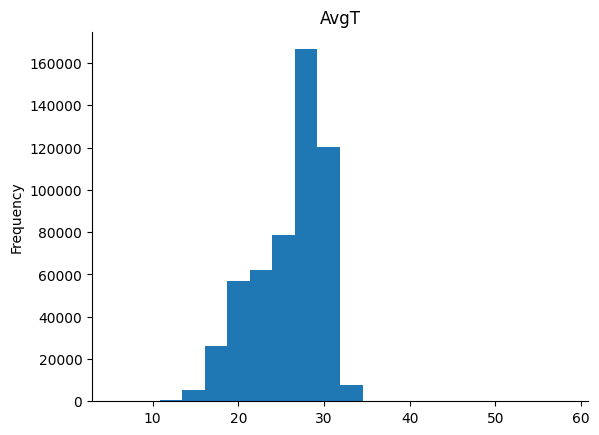

In [ ]:
from matplotlib import pyplot as plt
data['AvgT'].plot(kind='hist', bins=20, title='AvgT')
plt.gca().spines[['top', 'right',]].set_visible(False)

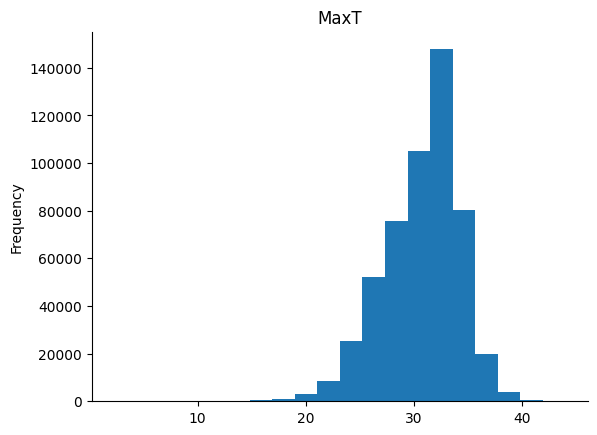

In [ ]:
from matplotlib import pyplot as plt
data['MaxT'].plot(kind='hist', bins=20, title='MaxT')
plt.gca().spines[['top', 'right',]].set_visible(False)

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 524535 entries, 0 to 524534
Data columns (total 9 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        524535 non-null  int64  
 1   Date              524535 non-null  object 
 2   STN               524535 non-null  object 
 3   MaxT              524535 non-null  float64
 4   MinT              524535 non-null  float64
 5   AvgT              524535 non-null  float64
 6   Rainfall          524535 non-null  int64  
 7   Humidity          524535 non-null  int64  
 8   Discomfort_Index  524535 non-null  float64
dtypes: float64(4), int64(3), object(2)
memory usage: 36.0+ MB


In [ ]:
numaric_data=data[["MaxT","MinT","AvgT","Rainfall","Humidity","Discomfort_Index"]]
numaric_data
correlation_mat=numaric_data.corr()
correlation_mat

,MaxT,MinT,AvgT,Rainfall,Humidity,Discomfort_Index
MaxT,1.000000,0.709993,0.889578,-0.060352,-0.149615,0.857598
MinT,0.709993,1.000000,0.953265,0.216953,0.381283,0.968246
AvgT,0.889578,0.953265,1.000000,0.114832,0.183126,0.995996
Rainfall,-0.060352,0.216953,0.114832,1.000000,0.383850,0.147366
Humidity,-0.149615,0.381283,0.183126,0.383850,1.000000,0.270279
Discomfort_Index,0.857598,0.968246,0.995996,0.147366,0.270279,1.000000


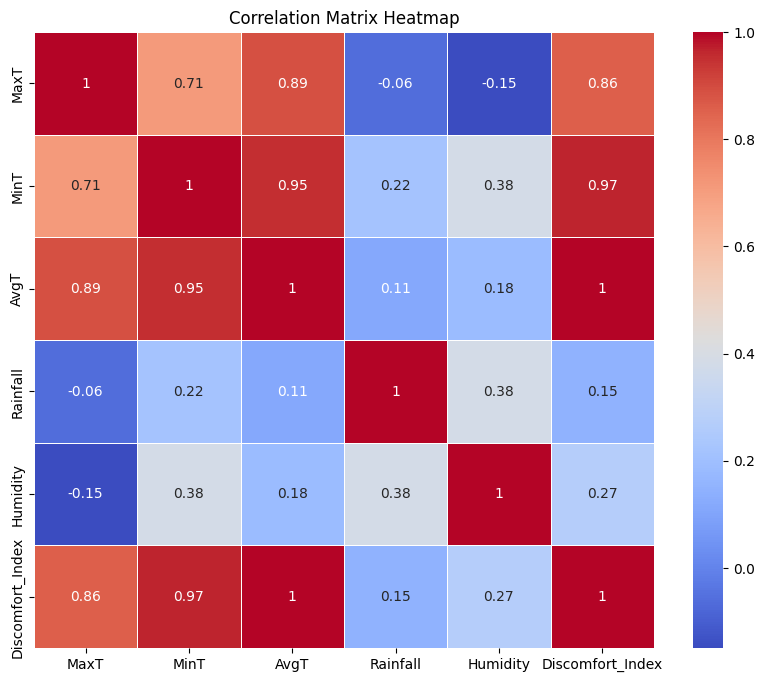

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
numaric_data = data[["MaxT", "MinT", "AvgT", "Rainfall", "Humidity", "Discomfort_Index"]]
correlation_mat = numaric_data.corr()
plt.figure(figsize=(10, 8))  # Adjust the figure size as needed
sns.heatmap(correlation_mat, annot=True, cmap='coolwarm', linewidths=0.5)

# Add title and display the heatmap
plt.title('Correlation Matrix Heatmap')
plt.show()


# One hot encoding

In [ ]:
unique_values = data['STN'].unique()
print(unique_values)

['DHK' 'TNG' 'MYM' 'FRD' 'MDR' 'SRI' 'SYL' 'BOG' 'DNJ' 'ISD' 'RAJ' 'RNP'
 'SYD' 'CHU' 'JSR' 'KHL' 'MNG' 'STK' 'BSL' 'BHL' 'KHP' 'PTK' 'CND' 'AMB'
 'CTG' 'COM' 'CXB' 'FNI' 'HTY' 'KTB' 'MCT' 'RMT' 'SND' 'STN' 'TEK']


In [ ]:
df_encoded = pd.get_dummies(data, columns=['STN'])
df_encoded.columns

Index(['Unnamed: 0', 'Date', 'MaxT', 'MinT', 'AvgT', 'Rainfall', 'Humidity',
       'Discomfort_Index', 'STN_AMB', 'STN_BHL', 'STN_BOG', 'STN_BSL',
       'STN_CHU', 'STN_CND', 'STN_COM', 'STN_CTG', 'STN_CXB', 'STN_DHK',
       'STN_DNJ', 'STN_FNI', 'STN_FRD', 'STN_HTY', 'STN_ISD', 'STN_JSR',
       'STN_KHL', 'STN_KHP', 'STN_KTB', 'STN_MCT', 'STN_MDR', 'STN_MNG',
       'STN_MYM', 'STN_PTK', 'STN_RAJ', 'STN_RMT', 'STN_RNP', 'STN_SND',
       'STN_SRI', 'STN_STK', 'STN_STN', 'STN_SYD', 'STN_SYL', 'STN_TEK',
       'STN_TNG'],
      dtype='object')

In [ ]:
df_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 524535 entries, 0 to 524534
Data columns (total 43 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        524535 non-null  int64  
 1   Date              524535 non-null  object 
 2   MaxT              524535 non-null  float64
 3   MinT              524535 non-null  float64
 4   AvgT              524535 non-null  float64
 5   Rainfall          524535 non-null  int64  
 6   Humidity          524535 non-null  int64  
 7   Discomfort_Index  524535 non-null  float64
 8   STN_AMB           524535 non-null  bool   
 9   STN_BHL           524535 non-null  bool   
 10  STN_BOG           524535 non-null  bool   
 11  STN_BSL           524535 non-null  bool   
 12  STN_CHU           524535 non-null  bool   
 13  STN_CND           524535 non-null  bool   
 14  STN_COM           524535 non-null  bool   
 15  STN_CTG           524535 non-null  bool   
 16  STN_CXB           52

In [ ]:
df=data.drop(['STN'],axis=1)
df

,Unnamed: 0,Date,MaxT,MinT,AvgT,Rainfall,Humidity,Discomfort_Index
0,0,1981-01-01,23.9,10.7,17.30,0,69,11.973
1,1,1981-01-02,24.4,12.7,18.55,0,69,13.348
2,2,1981-01-03,24.6,12.5,18.55,0,70,13.395
3,3,1981-01-04,25.6,10.6,18.10,0,70,12.900
4,4,1981-01-05,27.2,12.1,19.65,0,67,14.464
...,...,...,...,...,...,...,...,...
524530,524530,2022-12-27,29.4,15.0,22.20,0,77,17.739
524531,524531,2022-12-28,28.8,15.6,22.20,0,82,17.974
524532,524532,2022-12-29,30.3,18.6,24.45,0,75,20.120
524533,524533,2022-12-30,29.3,15.3,22.30,0,68,17.426


In [ ]:
df['Date'] = pd.to_datetime(df['Date'])
df['Year'] = df['Date'].dt.year
df['Decade'] = (df['Year'] // 10) * 10
decades = df['Decade'].unique()  # Get the unique decades
for decade in decades:
    df_decade = df[df['Decade'] == decade]  # Filter the DataFrame for the current decade
    df_decade.to_csv(f'dataset_{decade}s.csv', index=False)  # Save to a CSV file


In [ ]:
df

,Unnamed: 0,Date,MaxT,MinT,AvgT,Rainfall,Humidity,Discomfort_Index,Year,Decade
0,0,1981-01-01,23.9,10.7,17.30,0,69,11.973,1981,1980
1,1,1981-01-02,24.4,12.7,18.55,0,69,13.348,1981,1980
2,2,1981-01-03,24.6,12.5,18.55,0,70,13.395,1981,1980
3,3,1981-01-04,25.6,10.6,18.10,0,70,12.900,1981,1980
4,4,1981-01-05,27.2,12.1,19.65,0,67,14.464,1981,1980
...,...,...,...,...,...,...,...,...,...,...
524530,524530,2022-12-27,29.4,15.0,22.20,0,77,17.739,2022,2020
524531,524531,2022-12-28,28.8,15.6,22.20,0,82,17.974,2022,2020
524532,524532,2022-12-29,30.3,18.6,24.45,0,75,20.120,2022,2020
524533,524533,2022-12-30,29.3,15.3,22.30,0,68,17.426,2022,2020


from matplotlib import pyplot as plt
df['Unnamed: 0'].plot(kind='hist', bins=20, title='Unnamed: 0')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df['MaxT'].plot(kind='hist', bins=20, title='MaxT')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df['MinT'].plot(kind='hist', bins=20, title='MinT')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df['AvgT'].plot(kind='hist', bins=20, title='AvgT')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df.plot(kind='scatter', x='Unnamed: 0', y='MaxT', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df.plot(kind='scatter', x='MaxT', y='MinT', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df.plot(kind='scatter', x='MinT', y='AvgT', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
df.plot(kind='scatter', x='AvgT', y='Rainfall', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['Date']
  ys = series['MaxT']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df.sort_values('Date', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Date')
_ = plt.ylabel('MaxT')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['Date']
  ys = series['MinT']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df.sort_values('Date', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Date')
_ = plt.ylabel('MinT')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['Date']
  ys = series['AvgT']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df.sort_values('Date', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Date')
_ = plt.ylabel('AvgT')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['Date']
  ys = series['Rainfall']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = df.sort_values('Date', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Date')
_ = plt.ylabel('Rainfall')

from matplotlib import pyplot as plt
df['Unnamed: 0'].plot(kind='line', figsize=(8, 4), title='Unnamed: 0')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
df['MaxT'].plot(kind='line', figsize=(8, 4), title='MaxT')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
df['MinT'].plot(kind='line', figsize=(8, 4), title='MinT')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
df['AvgT'].plot(kind='line', figsize=(8, 4), title='AvgT')
plt.gca().spines[['top', 'right']].set_visible(False)

# working code

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

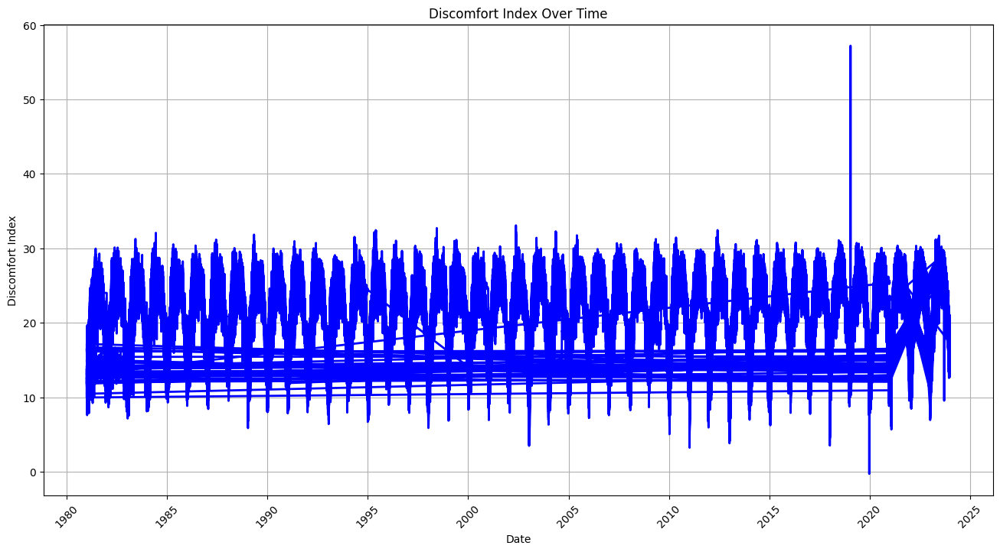

In [ ]:


plt.figure(figsize=(16, 8))
# plt.plot(df['Date'], df['Discomfort_Index'], color='b', marker='o', linestyle='-', label='Discomfort Index')
plt.plot(df['Date'], df['Discomfort_Index'], color='b', linestyle='-', linewidth=2, label='Discomfort Index')
# Customize the plot

plt.title('Discomfort Index Over Time')
plt.xlabel('Date')
plt.ylabel('Discomfort Index')
plt.xticks(rotation=45)
plt.grid(True)



# Show the plot
plt.show()

In [ ]:
# ['DHK' 'TNG' 'MYM' 'FRD' 'MDR' 'SRI' 'SYL' 'BOG' 'DNJ' 'ISD' 'RAJ' 'RNP'
#  'SYD' 'CHU' 'JSR' 'KHL' 'MNG' 'STK' 'BSL' 'BHL' 'KHP' 'PTK' 'CND' 'AMB'
#  'CTG' 'COM' 'CXB' 'FNI' 'HTY' 'KTB' 'MCT' 'RMT' 'SND' 'STN' 'TEK']
df_stn_dhk = data[data['STN'] == 'DHK']
df_stn_TNG = data[data['STN'] == 'TNG']
df_stn_MYM = data[data['STN'] == 'MYM']
df_stn_FRD = data[data['STN'] == 'FRD']
df_stn_MDR = data[data['STN'] == 'MDR']
df_stn_SRI = data[data['STN'] == 'SRI']
df_stn_SYL = data[data['STN'] == 'SYL']
df_stn_dhk = data[data['STN'] == 'DHK']
df_stn_dhk = data[data['STN'] == 'DHK']
df_stn_dhk = data[data['STN'] == 'DHK']

In [3]:
unique_values = data['STN'].unique()
region_df={}
for unique_value in unique_values:
  df_stn = data[data['STN'] == unique_value]
  region_df[unique_value]=df_stn

In [ ]:
region_df

{'DHK':         Unnamed: 0        Date  STN  MaxT  MinT   AvgT  Rainfall  Humidity  \
 0                0  1981-01-01  DHK  23.9  10.7  17.30         0        69   
 1                1  1981-01-02  DHK  24.4  12.7  18.55         0        69   
 2                2  1981-01-03  DHK  24.6  12.5  18.55         0        70   
 3                3  1981-01-04  DHK  25.6  10.6  18.10         0        70   
 4                4  1981-01-05  DHK  27.2  12.1  19.65         0        67   
 ...            ...         ...  ...   ...   ...    ...       ...       ...   
 514126      514126  2022-12-27  DHK  24.7  18.8  21.75         4        85   
 514127      514127  2022-12-28  DHK  24.5  17.7  21.10         0        81   
 514128      514128  2022-12-29  DHK  24.2  14.5  19.35         0        79   
 514129      514129  2022-12-30  DHK  22.2  14.7  18.45         0        83   
 514130      514130  2022-12-31  DHK  22.6  13.9  18.25         0        85   
 
         Discomfort_Index  
 0             

<class 'pandas.core.frame.DataFrame'>
Index: 1461 entries, 14244 to 514130
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Unnamed: 0        1461 non-null   int64  
 1   Date              1461 non-null   object 
 2   STN               1461 non-null   object 
 3   MaxT              1461 non-null   float64
 4   MinT              1461 non-null   float64
 5   AvgT              1461 non-null   float64
 6   Rainfall          1461 non-null   int64  
 7   Humidity          1461 non-null   int64  
 8   Discomfort_Index  1461 non-null   float64
dtypes: float64(4), int64(3), object(2)
memory usage: 114.1+ KB
None


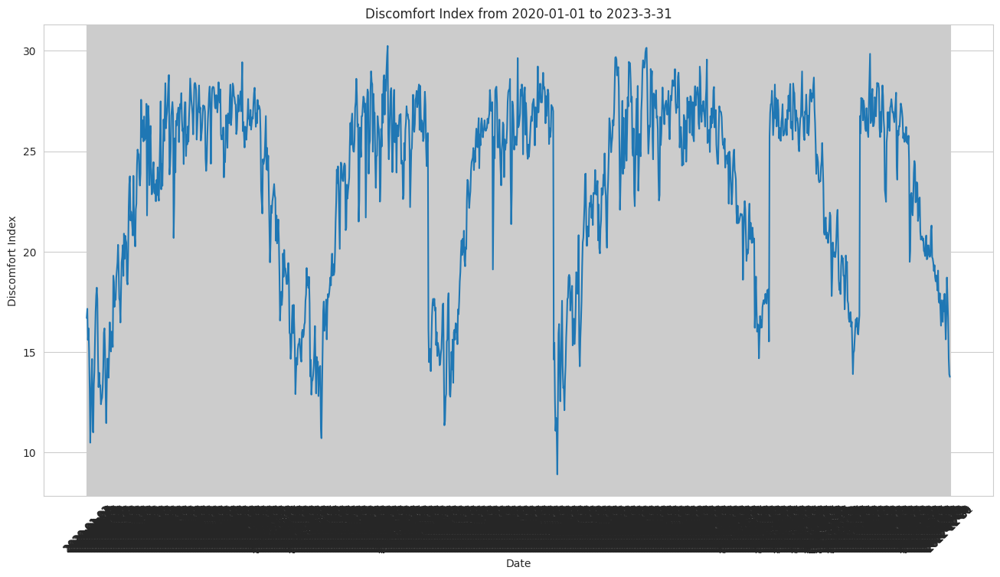

In [ ]:
# Specify the date range for the plot
strt_year=2020
end_year=2023
start_date = f'{strt_year}-01-01'  # Replace with your desired start date
end_date = f'{end_year}-3-31'    # Replace with your desired end date

df_stn_dhk=region_df['DHK']

# Filter the dataset for the specified date range
df_filtered = df_stn_dhk[(df_stn_dhk['Date'] >= start_date) & (df_stn_dhk['Date'] <= end_date)]
print(df_filtered.info())
# Set up the plot style
sns.set_style('whitegrid')

# Increase the figure size for a larger plot
plt.figure(figsize=(16, 8))  # Adjusted size: 16 inches wide, 8 inches tall

# Plot the Discomfort Index as a line graph across the filtered dates
plt.plot(df_filtered['Date'], df_filtered['Discomfort_Index'])

# Customize the plot
plt.title(f'Discomfort Index from {start_date} to {end_date}')
plt.xlabel('Date')
plt.ylabel('Discomfort Index')
plt.xticks(rotation=45)
plt.grid(True)


# Show the plot
plt.show()

In [ ]:
df_filtered

,Unnamed: 0,Date,STN,MaxT,MinT,AvgT,Rainfall,Humidity,Discomfort_Index
14244,14244,2020-01-01,DHK,28.5,14.6,21.55,0,70,16.695
14245,14245,2020-01-02,DHK,28.0,15.6,21.80,2,74,17.158
14246,14246,2020-01-03,DHK,22.5,17.0,19.75,18,89,15.608
14247,14247,2020-01-04,DHK,23.9,17.0,20.45,0,85,16.190
14248,14248,2020-01-05,DHK,22.8,16.3,19.55,0,82,15.059
...,...,...,...,...,...,...,...,...,...
514126,514126,2022-12-27,DHK,24.7,18.8,21.75,4,85,17.620
514127,514127,2022-12-28,DHK,24.5,17.7,21.10,0,81,16.717
514128,514128,2022-12-29,DHK,24.2,14.5,19.35,0,79,14.698
514129,514129,2022-12-30,DHK,22.2,14.7,18.45,0,83,13.896


In [ ]:
df_stn_dhk.info()

<class 'pandas.core.frame.DataFrame'>
Index: 15705 entries, 0 to 514130
Data columns (total 9 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Unnamed: 0        15705 non-null  int64  
 1   Date              15705 non-null  object 
 2   STN               15705 non-null  object 
 3   MaxT              15705 non-null  float64
 4   MinT              15705 non-null  float64
 5   AvgT              15705 non-null  float64
 6   Rainfall          15705 non-null  int64  
 7   Humidity          15705 non-null  int64  
 8   Discomfort_Index  15705 non-null  float64
dtypes: float64(4), int64(3), object(2)
memory usage: 1.2+ MB


In [ ]:
df=df_filtered.drop(['STN'],axis=1)
df['Date'] = pd.to_datetime(df_stn_dhk['Date'])
df['Year'] = df['Date'].dt.year
df['Decade'] = (df['Year'] // 10) * 10
df

,Unnamed: 0,Date,MaxT,MinT,AvgT,Rainfall,Humidity,Discomfort_Index,Year,Decade
13879,13879,2019-01-01,27.7,13.4,20.55,0,63,15.266,2019,2010
13880,13880,2019-01-02,27.2,13.7,20.45,0,63,15.156,2019,2010
13881,13881,2019-01-03,26.5,13.0,19.75,0,58,14.151,2019,2010
13882,13882,2019-01-04,24.8,12.9,18.85,0,61,13.302,2019,2010
13883,13883,2019-01-05,26.4,12.0,19.20,0,63,13.781,2019,2010
...,...,...,...,...,...,...,...,...,...,...
514126,514126,2022-12-27,24.7,18.8,21.75,4,85,17.620,2022,2020
514127,514127,2022-12-28,24.5,17.7,21.10,0,81,16.717,2022,2020
514128,514128,2022-12-29,24.2,14.5,19.35,0,79,14.698,2022,2020
514129,514129,2022-12-30,22.2,14.7,18.45,0,83,13.896,2022,2020


In [ ]:

decades = df['Decade'].unique()  # Get the unique decades
for decade in decades:


df_decade

,Unnamed: 0,Date,MaxT,MinT,AvgT,Rainfall,Humidity,Discomfort_Index,Year,Decade
14244,14244,2020-01-01,28.5,14.6,21.55,0,70,16.695,2020,2020
14245,14245,2020-01-02,28.0,15.6,21.80,2,74,17.158,2020,2020
14246,14246,2020-01-03,22.5,17.0,19.75,18,89,15.608,2020,2020
14247,14247,2020-01-04,23.9,17.0,20.45,0,85,16.190,2020,2020
14248,14248,2020-01-05,22.8,16.3,19.55,0,82,15.059,2020,2020
...,...,...,...,...,...,...,...,...,...,...
514126,514126,2022-12-27,24.7,18.8,21.75,4,85,17.620,2022,2020
514127,514127,2022-12-28,24.5,17.7,21.10,0,81,16.717,2022,2020
514128,514128,2022-12-29,24.2,14.5,19.35,0,79,14.698,2022,2020
514129,514129,2022-12-30,22.2,14.7,18.45,0,83,13.896,2022,2020


# graph of all region during 4 decades

In [ ]:
def draw_graph_decades(df,key):
  decades = {
    '1980s': (1980, 1989),
    '1990s': (1990, 1999),
    '2000s': (2000, 2009),
    '2010s': (2010, 2019),
    '2020s': (2020, 2030)
  }
  for decade_name, decade_range in decades.items():
    start_year, end_year = decade_range

    start_date = f'{start_year}-01-01'  # Replace with your desired start date
    end_date = f'{end_year}-12-31'    # Replace with your desired end date
    print(start_date)
    print(end_date)

    df_filtered = df[(df['Date'] >= start_date) & (df['Date'] <= end_date)]
    # print(df_filtered)
    # Set up the plot style
    sns.set_style('whitegrid')

    # Increase the figure size for a larger plot
    plt.figure(figsize=(10,6))  # Adjusted size: 16 inches wide, 8 inches tall

    # Plot the Discomfort Index as a line graph across the filtered dates
    plt.plot(df_filtered['Date'], df_filtered['Discomfort_Index'],label=f'{key}s')

    # Customize the plot
    plt.title(f'Discomfort Index from {start_date} to {end_date}')
    plt.xlabel('Date')
    plt.ylabel('Discomfort Index')
    plt.xticks(rotation=45)
    plt.grid(True)
    plt.tight_layout()
    plt.legend()

    # Show the plot
    plt.show()



1980-01-01
1989-12-31


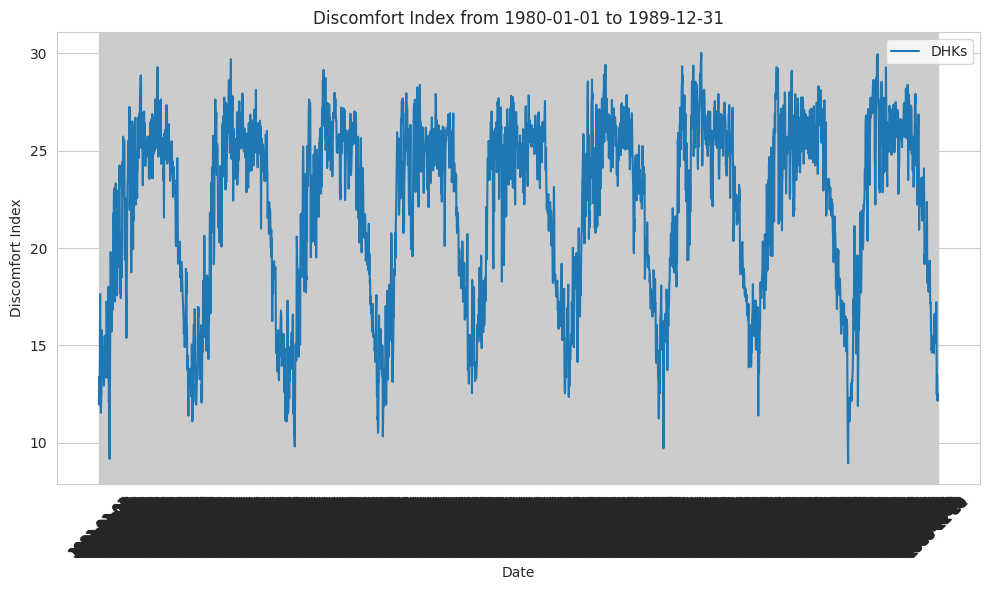

1990-01-01
1999-12-31


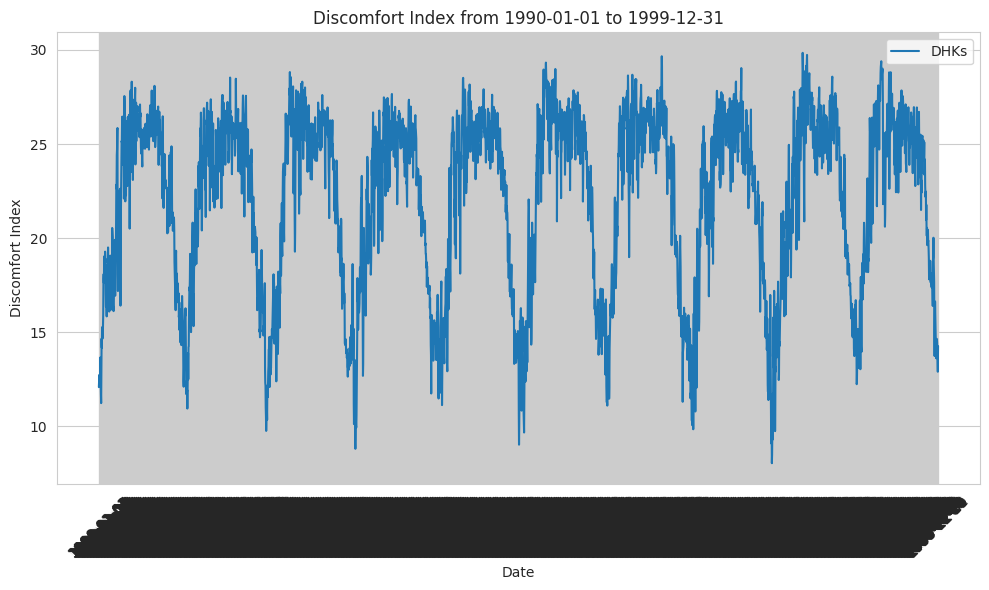

2000-01-01
2009-12-31


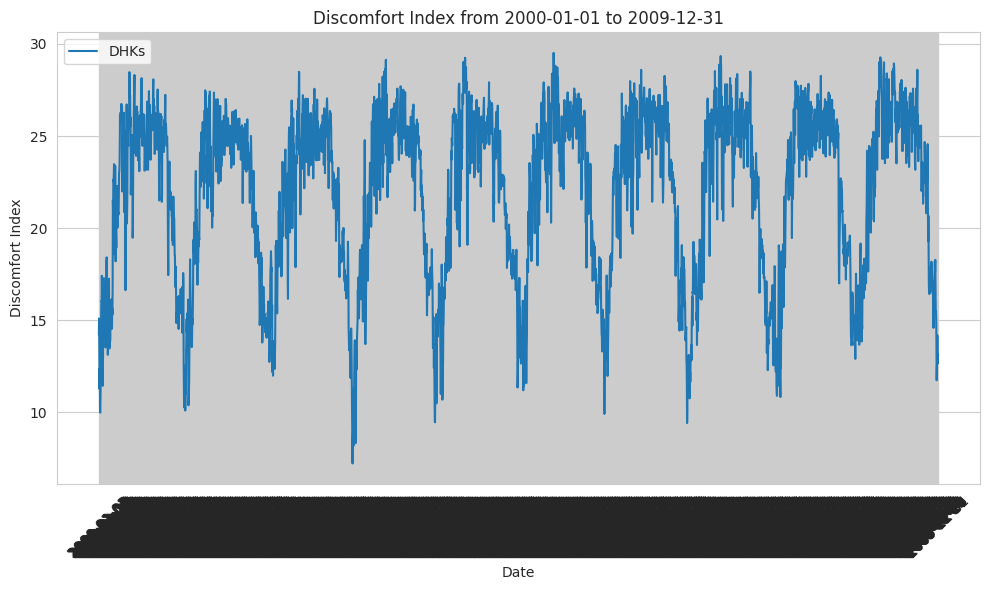

2010-01-01
2019-12-31


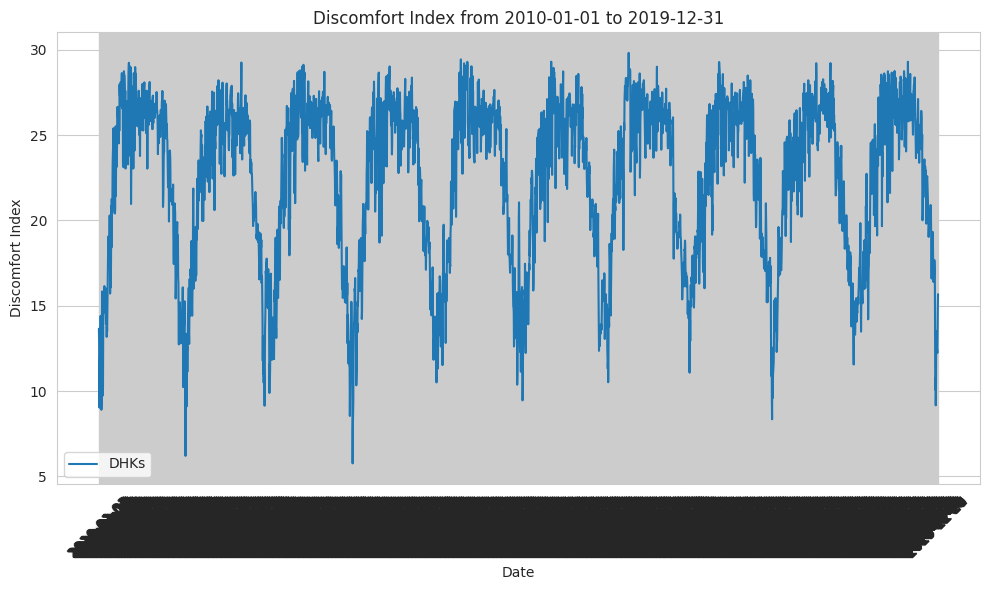

2020-01-01
2030-12-31


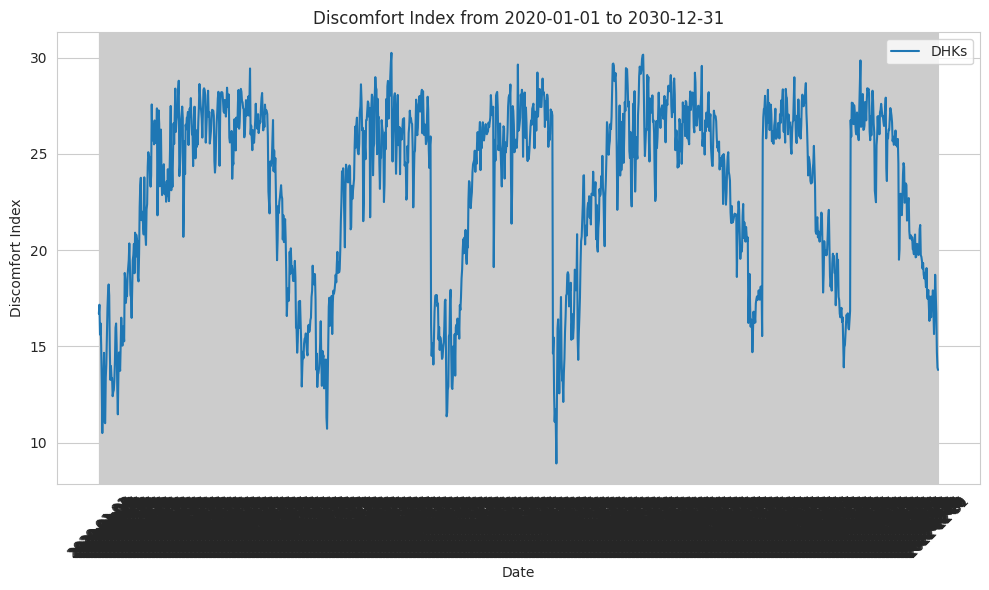

1980-01-01
1989-12-31


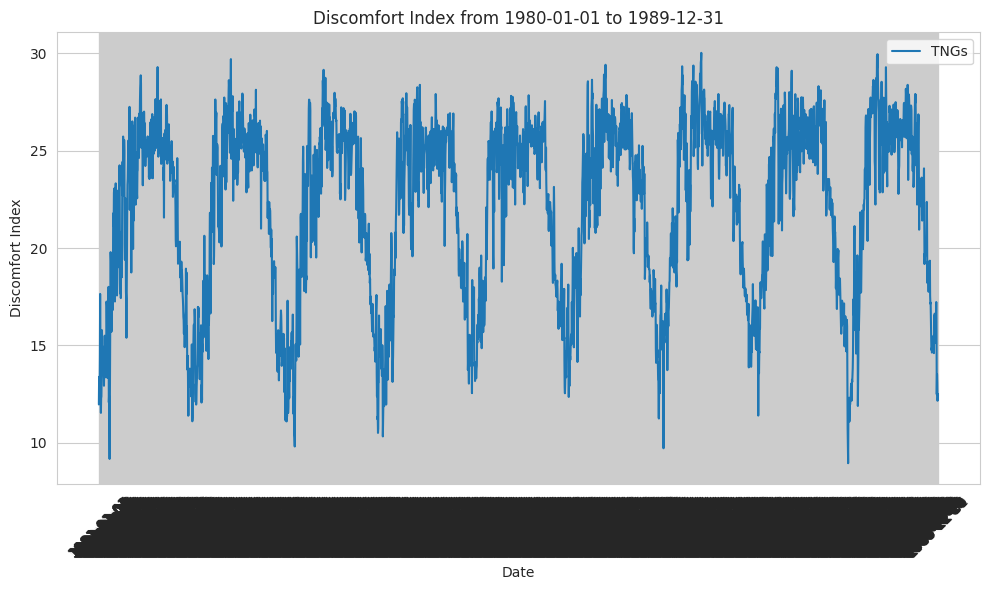

1990-01-01
1999-12-31


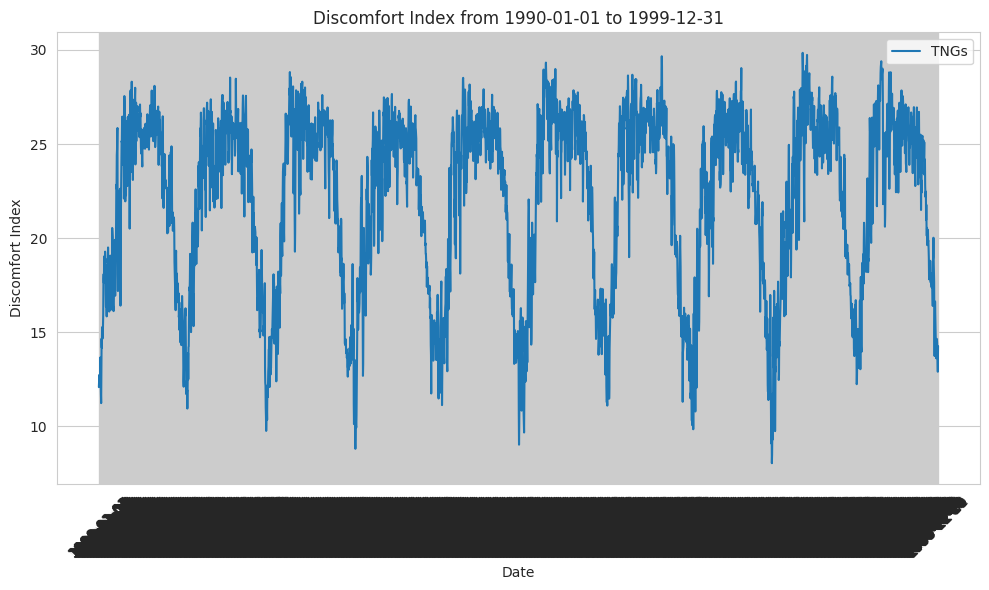

2000-01-01
2009-12-31


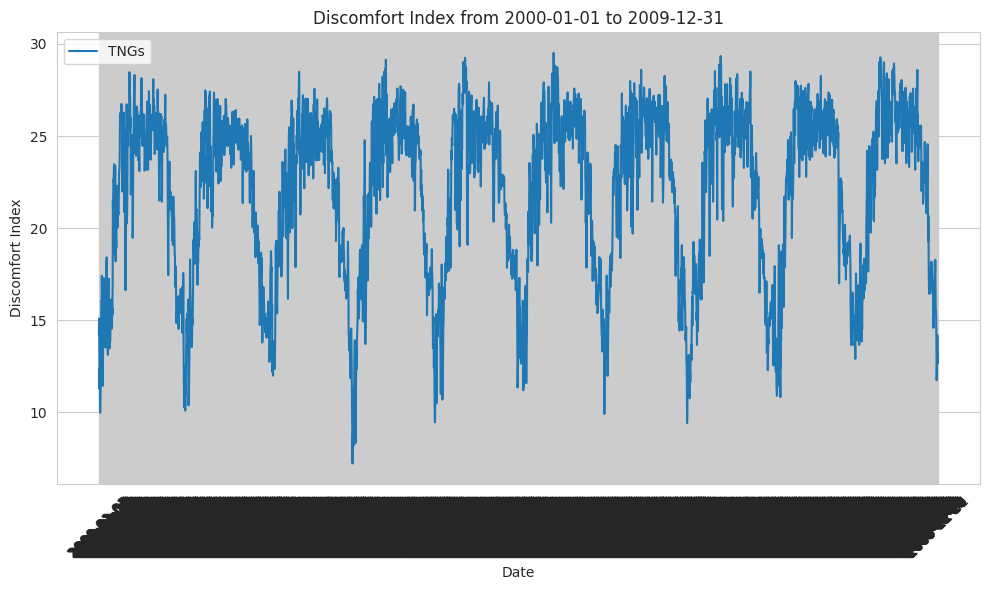

2010-01-01
2019-12-31


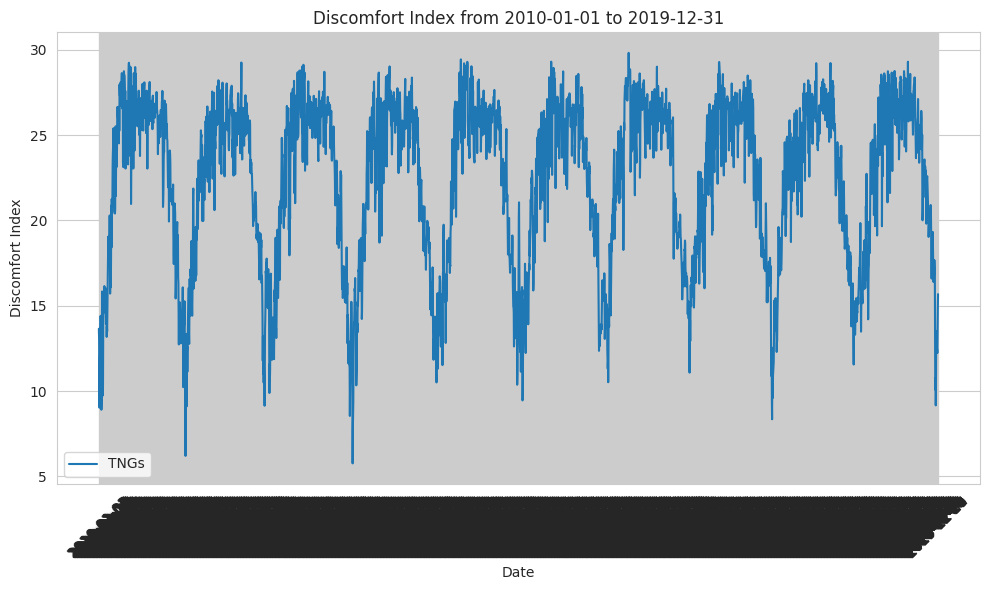

2020-01-01
2030-12-31


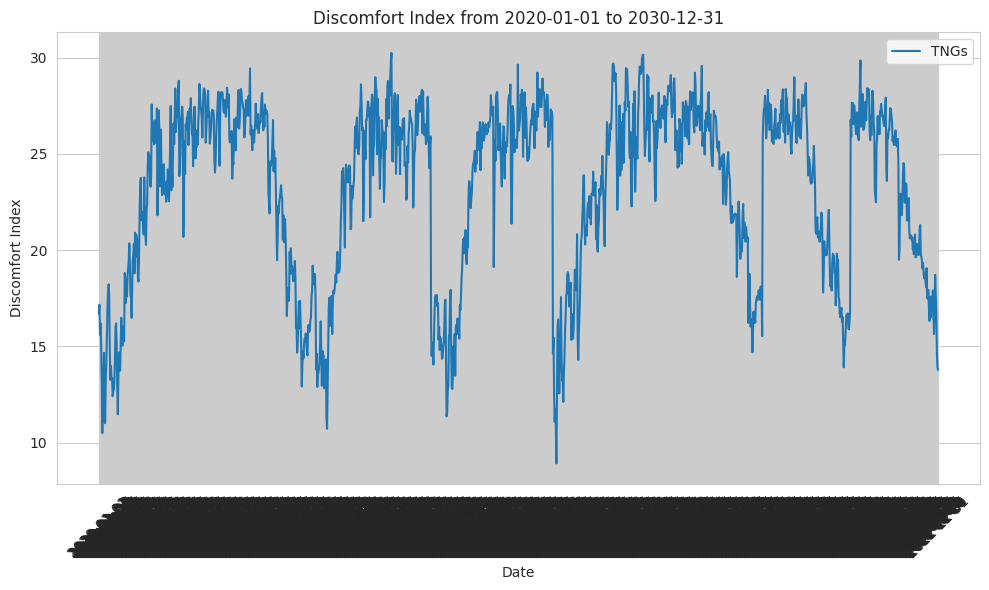

1980-01-01
1989-12-31


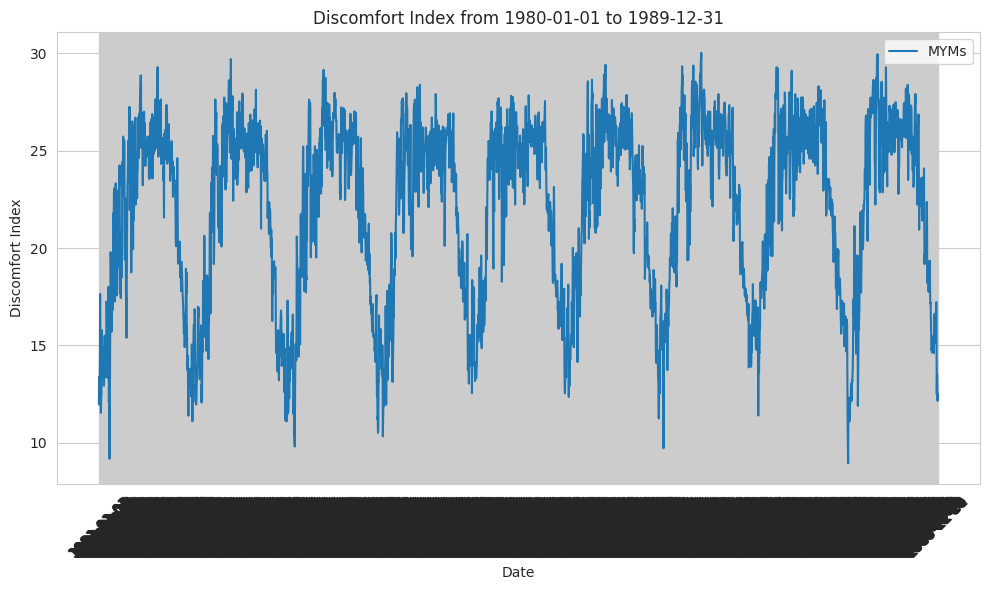

1990-01-01
1999-12-31


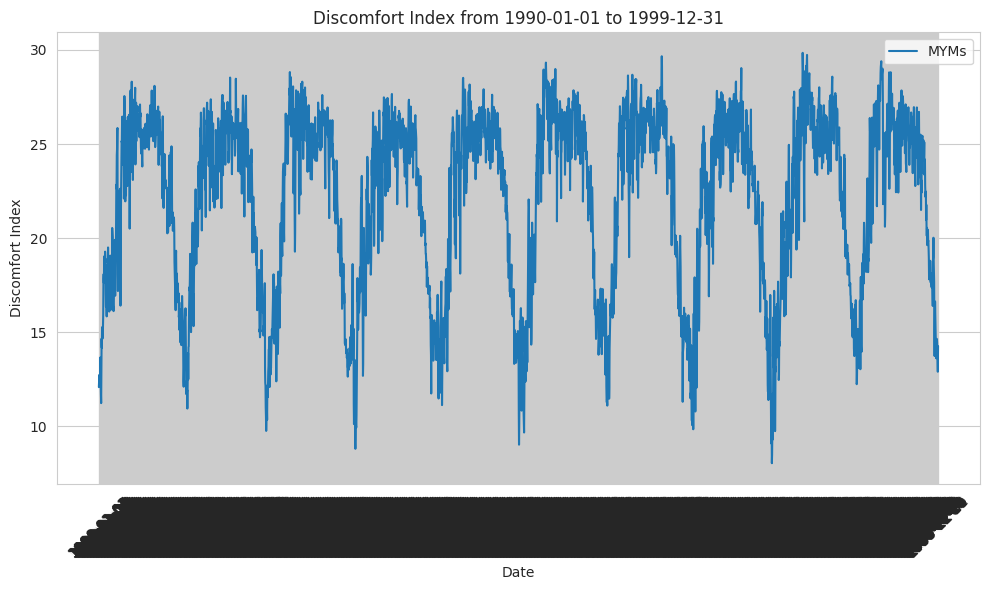

2000-01-01
2009-12-31


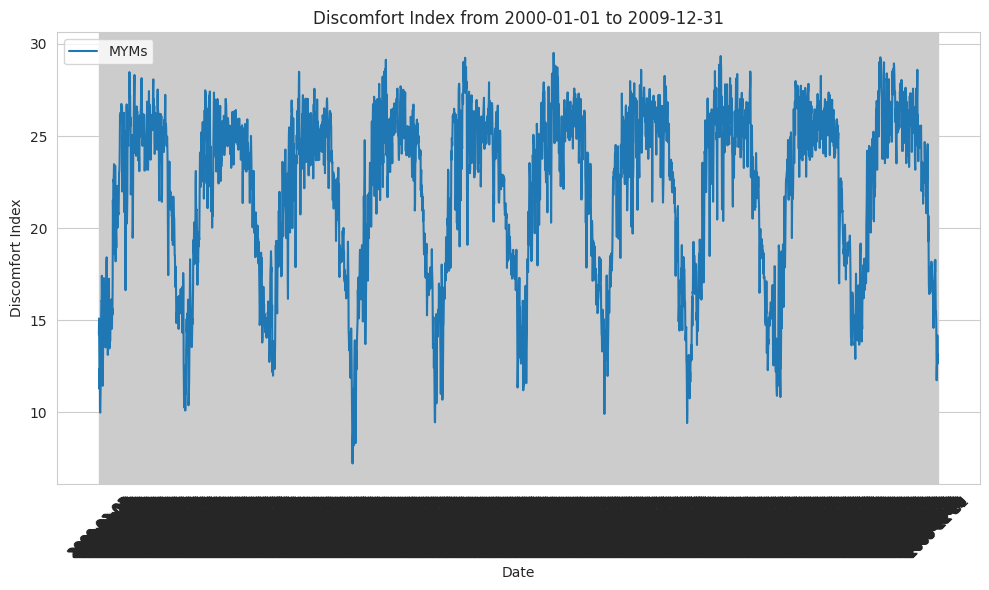

2010-01-01
2019-12-31


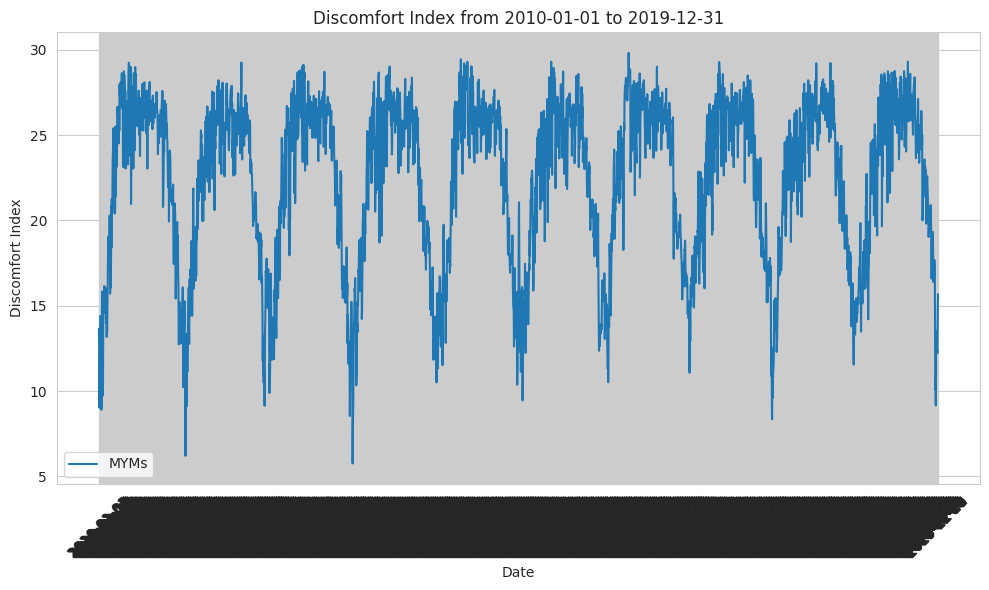

2020-01-01
2030-12-31


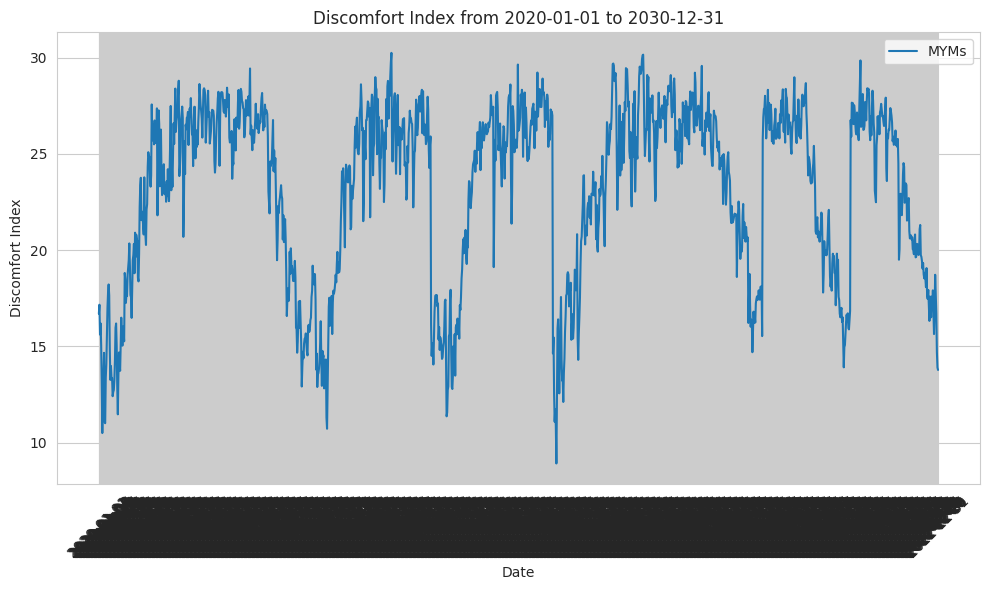

1980-01-01
1989-12-31


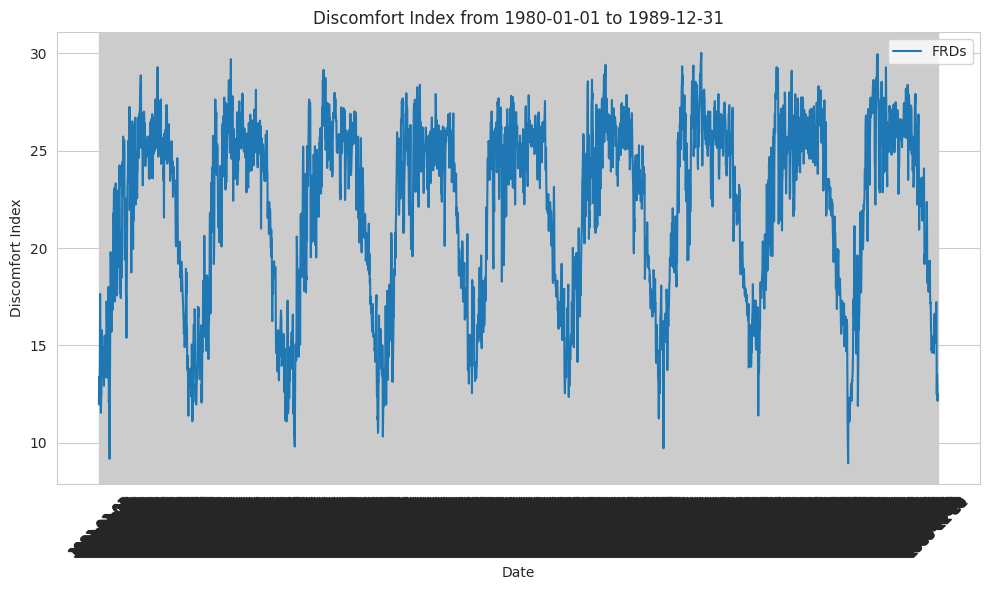

1990-01-01
1999-12-31


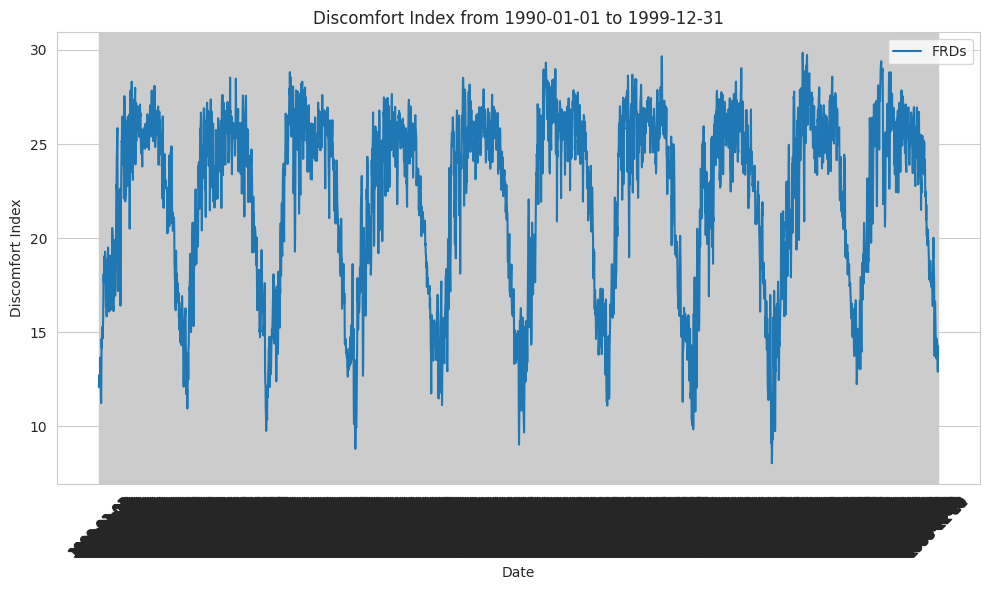

2000-01-01
2009-12-31


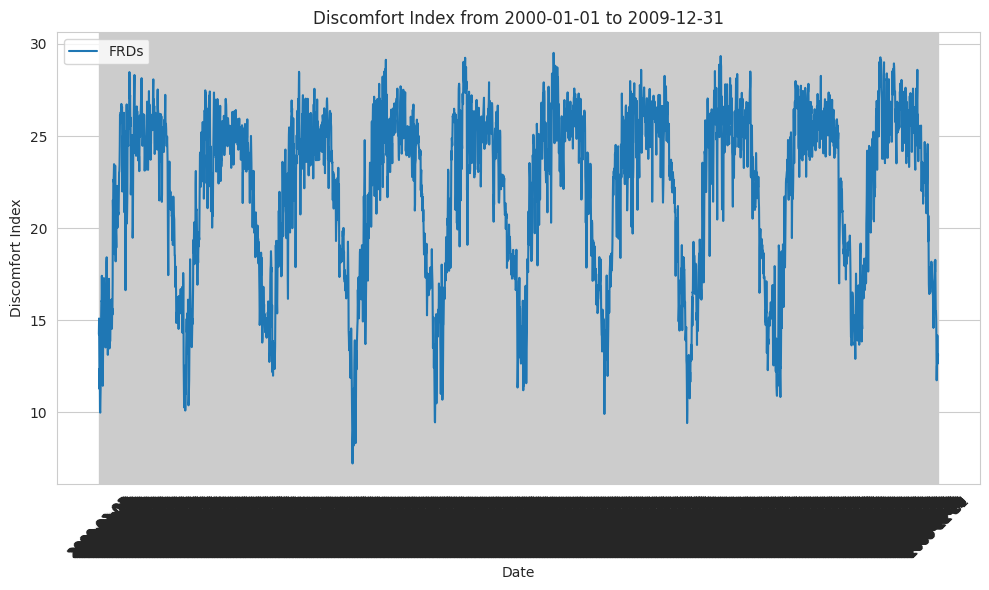

2010-01-01
2019-12-31


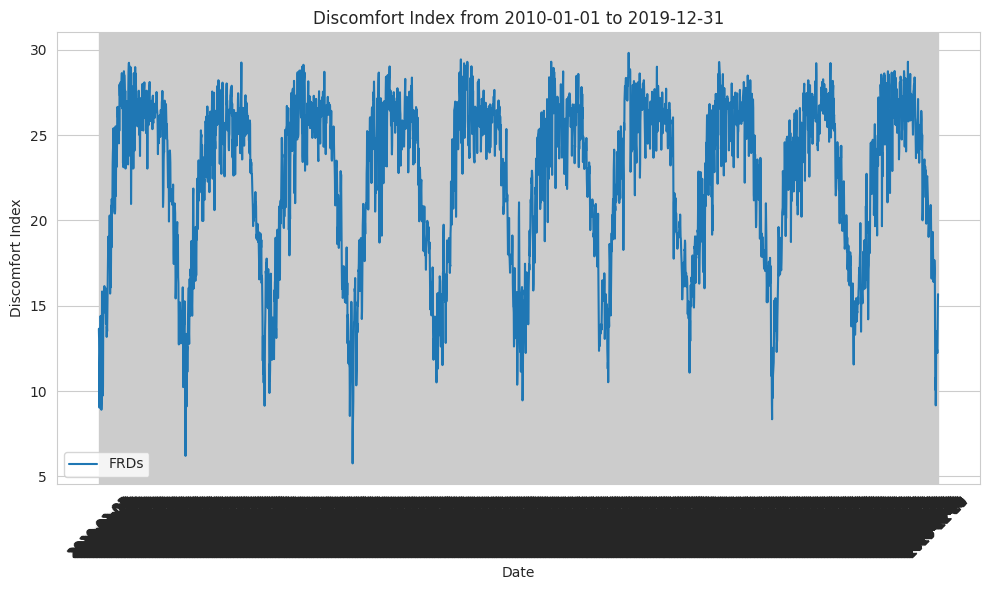

2020-01-01
2030-12-31


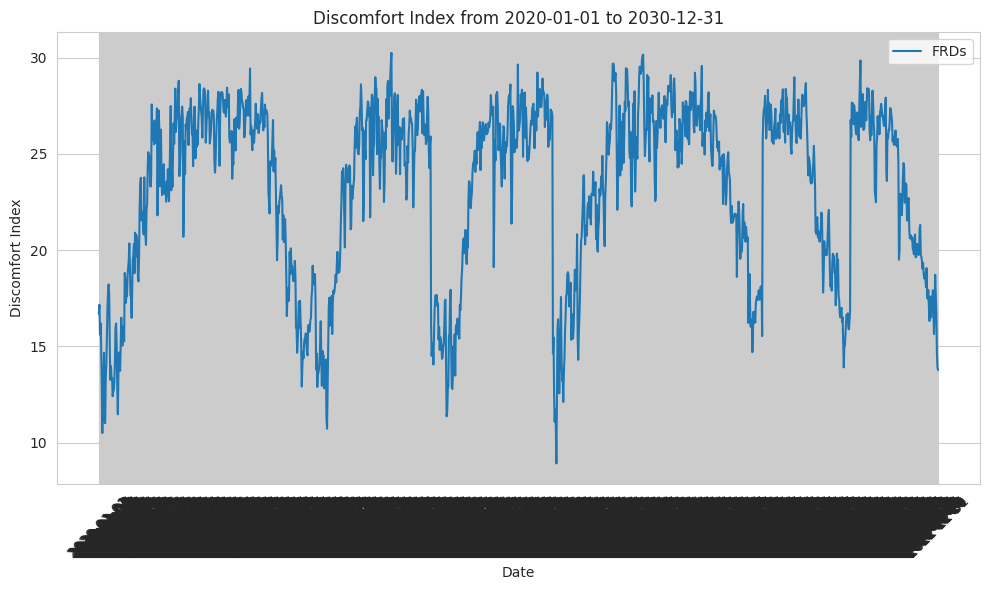

1980-01-01
1989-12-31


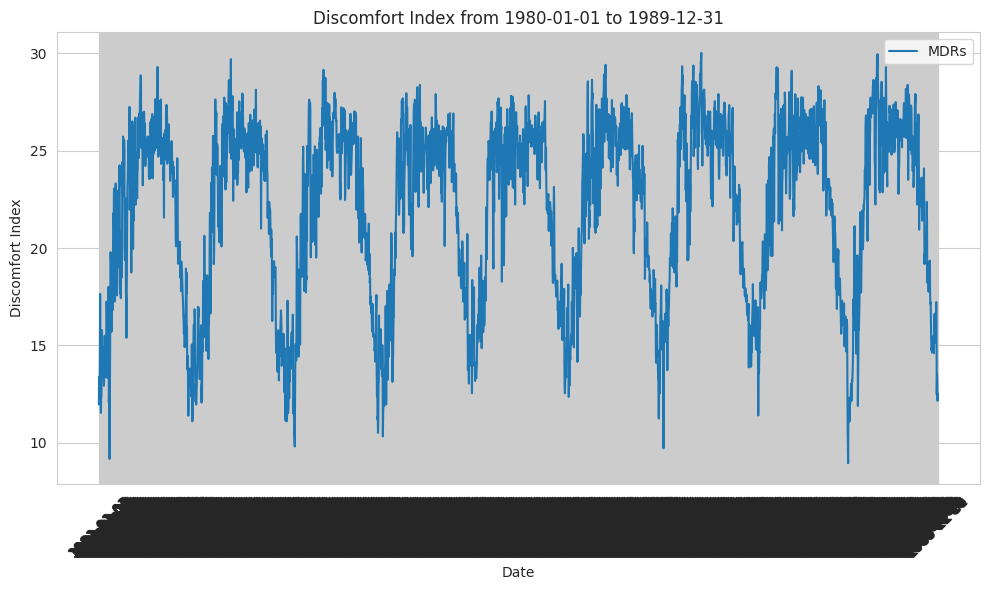

1990-01-01
1999-12-31


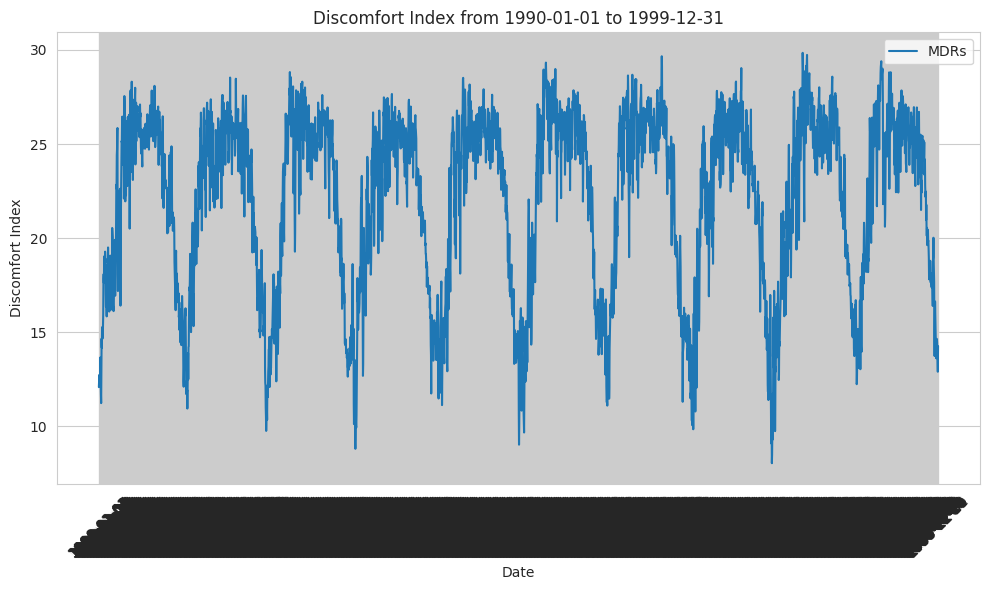

2000-01-01
2009-12-31


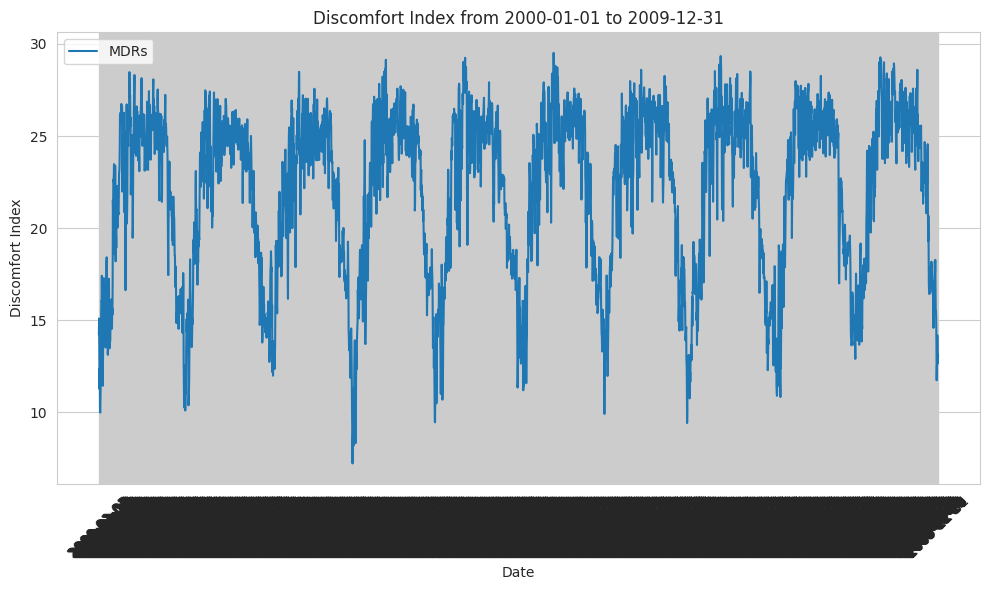

2010-01-01
2019-12-31


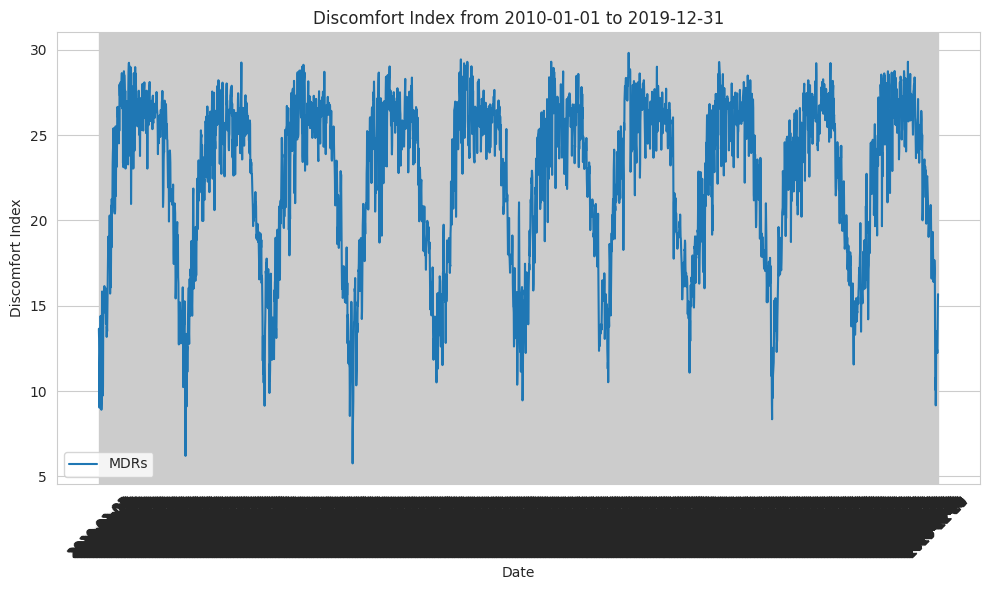

2020-01-01
2030-12-31


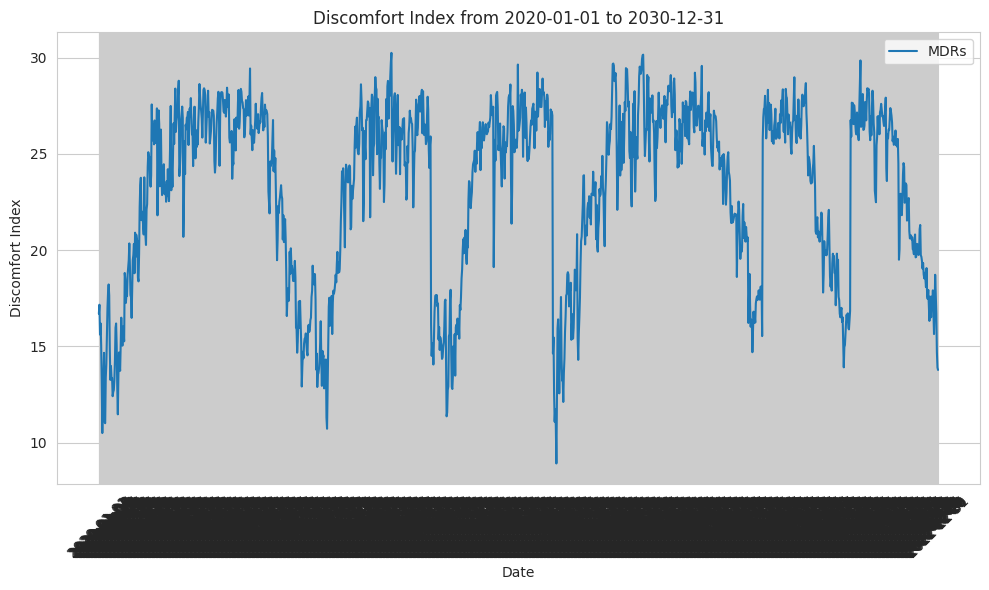

1980-01-01
1989-12-31


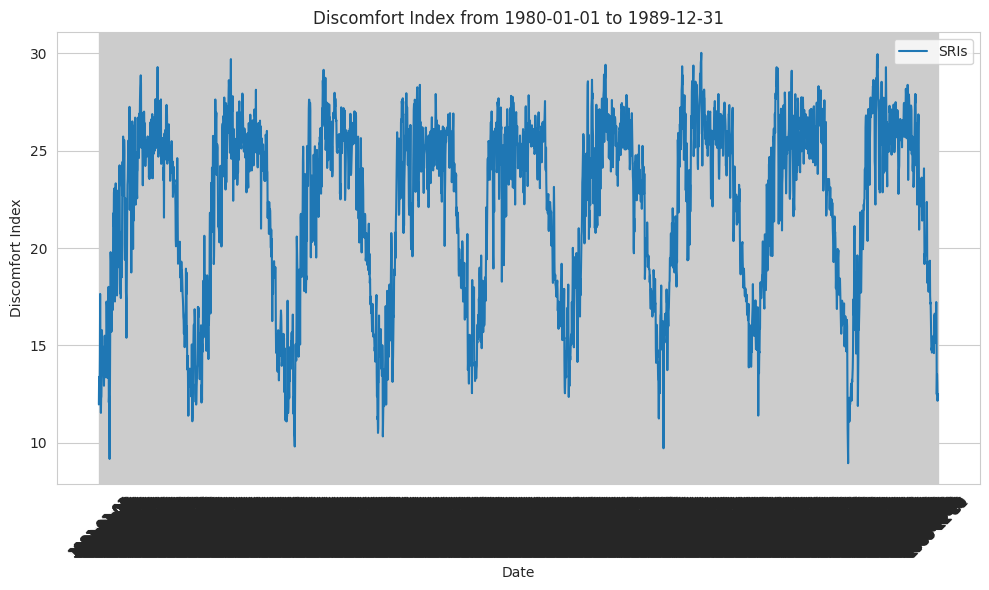

1990-01-01
1999-12-31


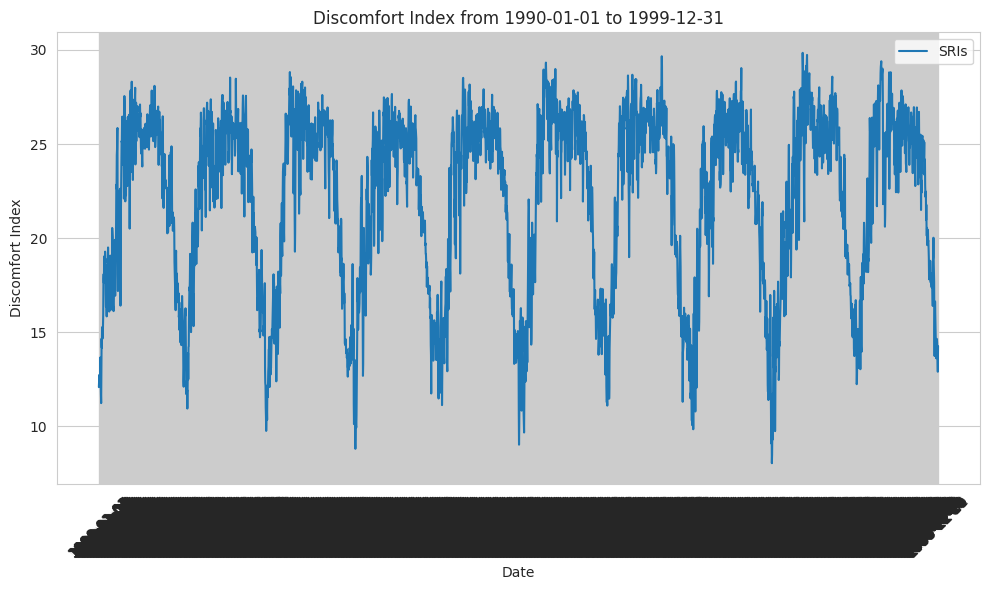

2000-01-01
2009-12-31


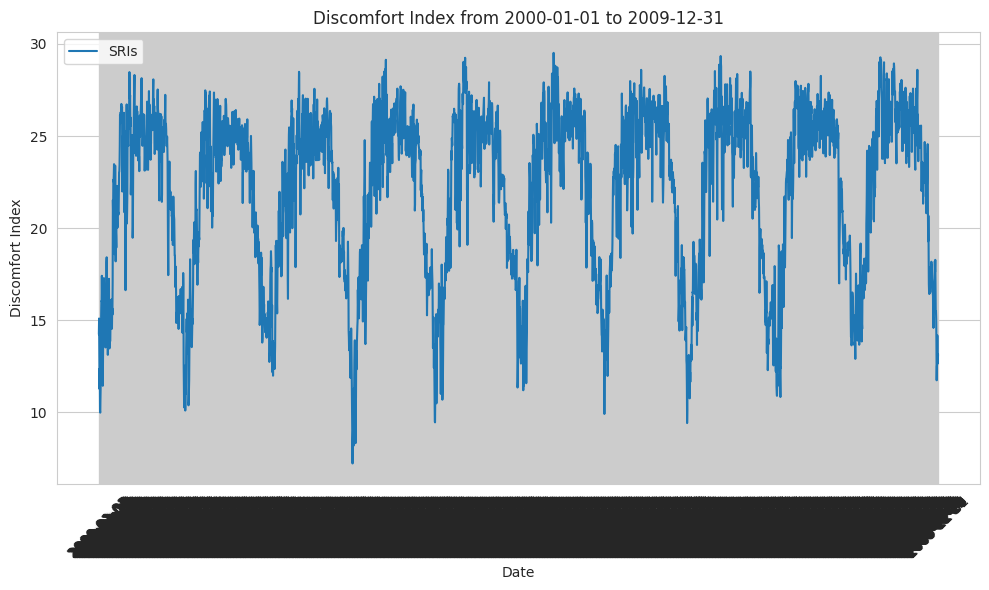

2010-01-01
2019-12-31


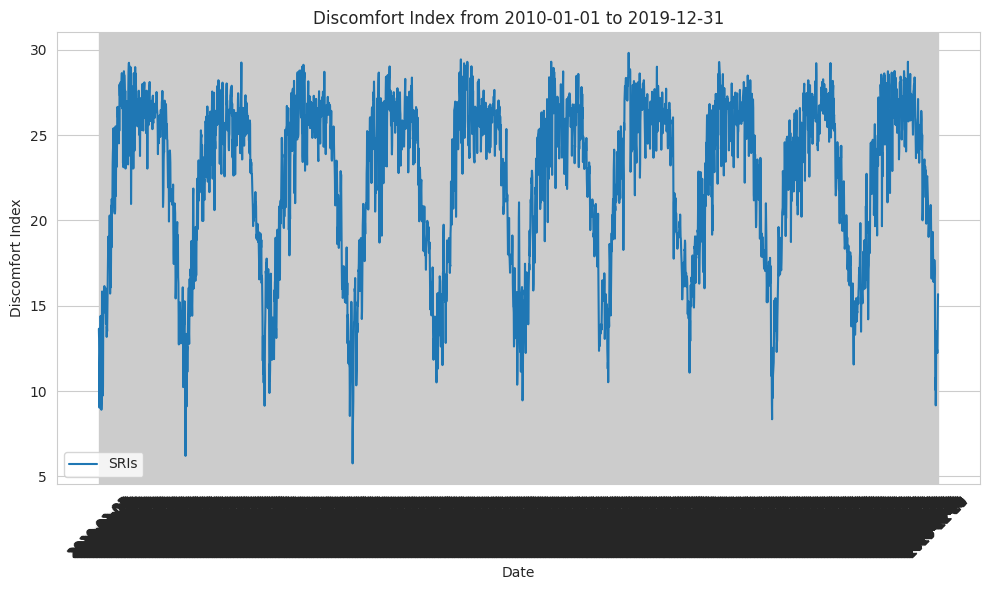

2020-01-01
2030-12-31


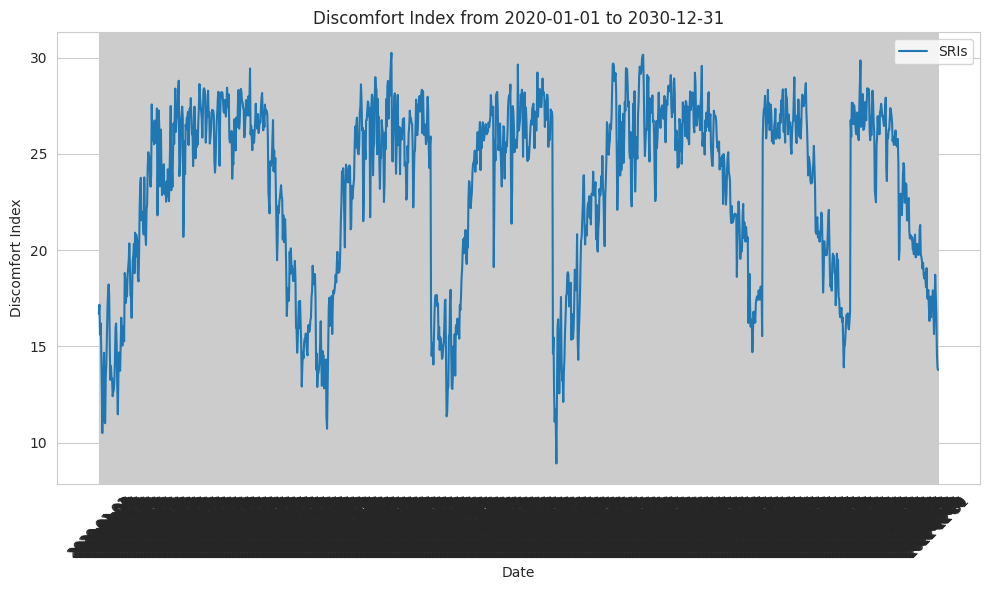

1980-01-01
1989-12-31


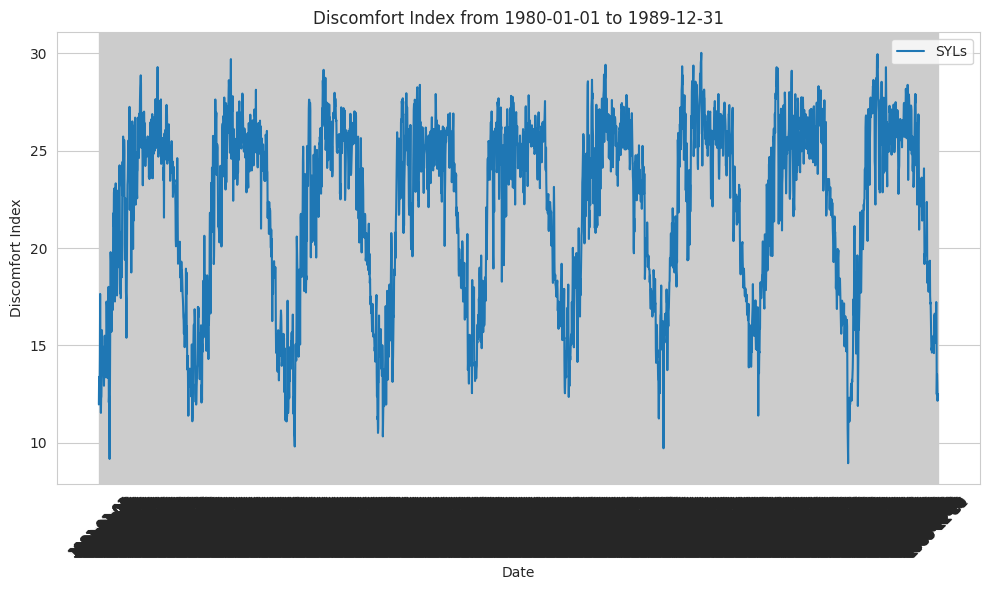

1990-01-01
1999-12-31


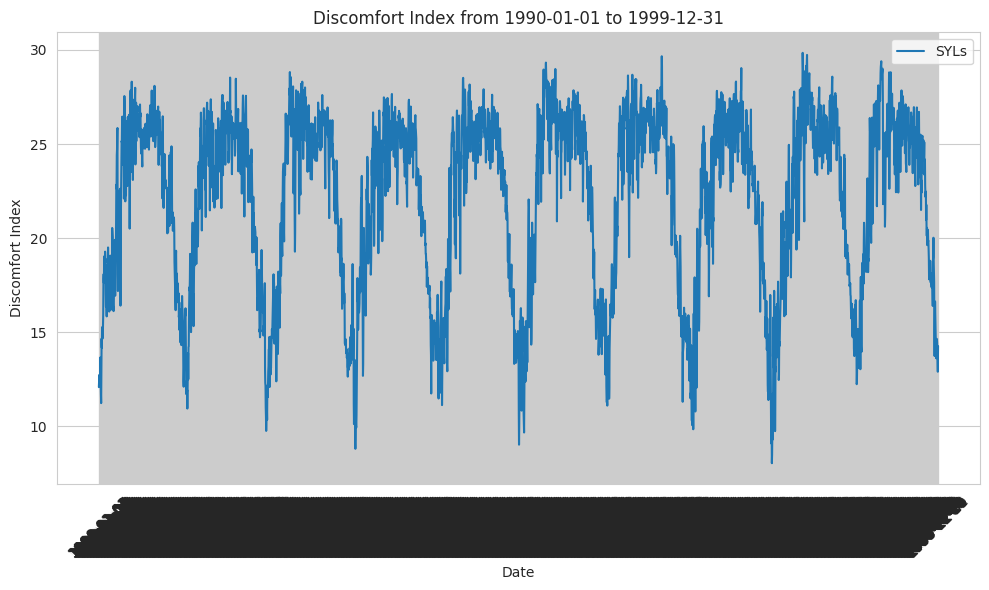

2000-01-01
2009-12-31


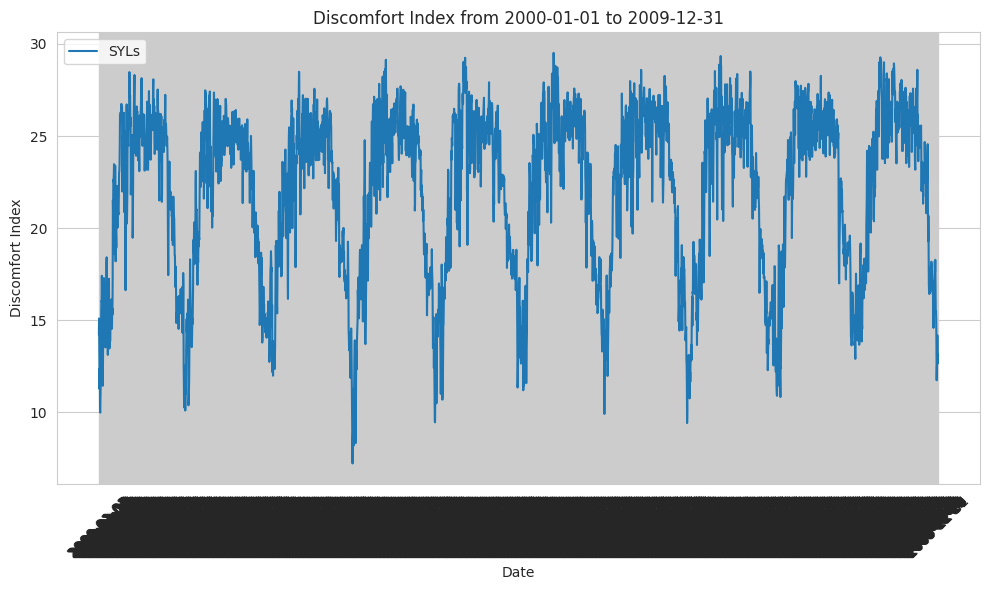

2010-01-01
2019-12-31


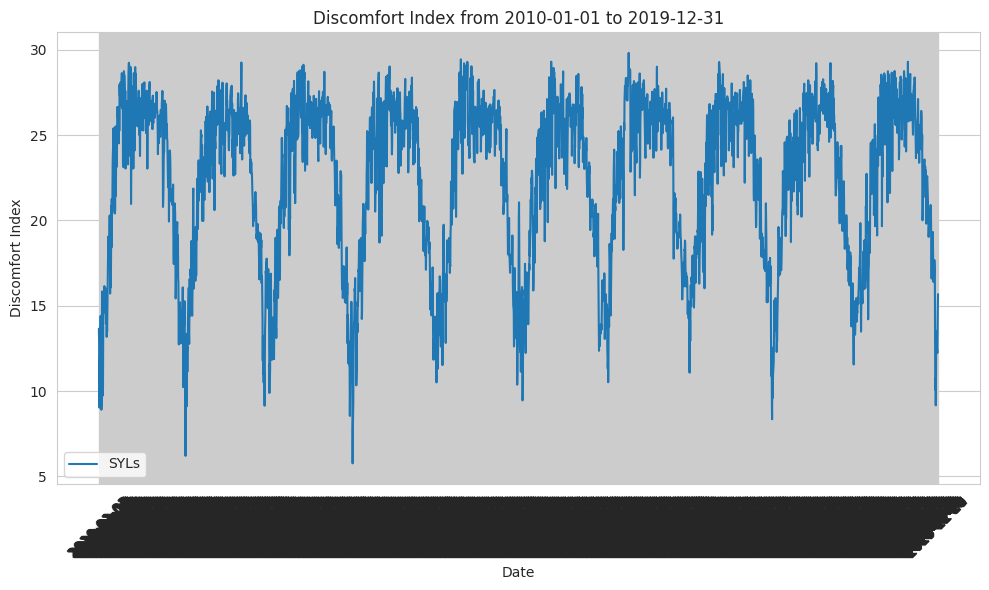

2020-01-01
2030-12-31


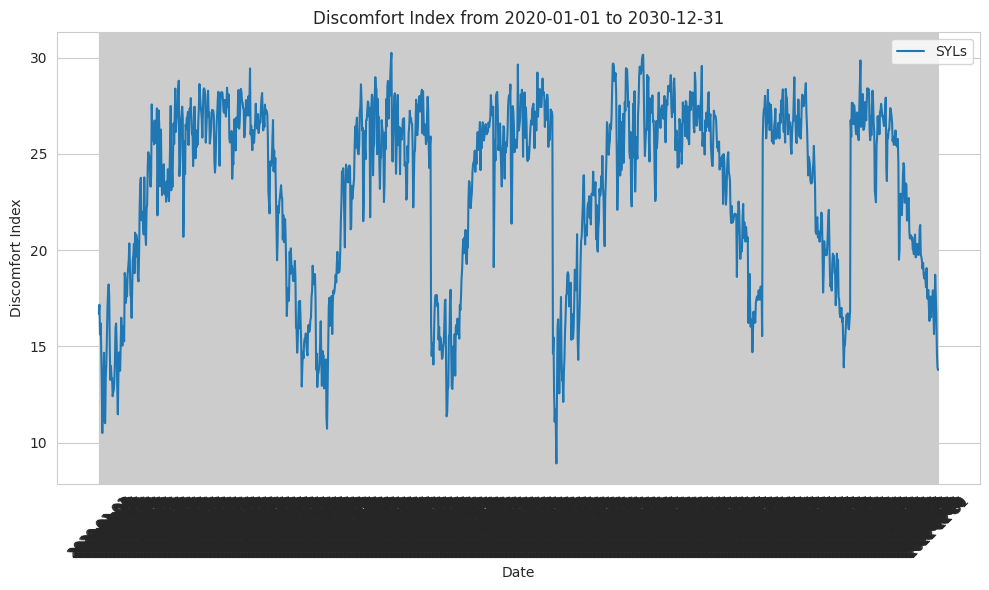

1980-01-01
1989-12-31


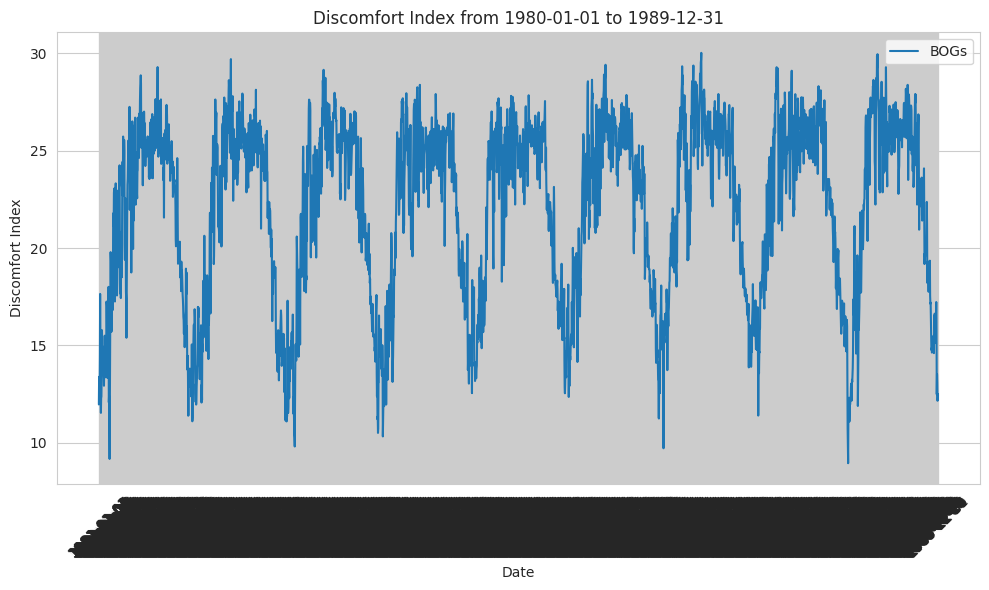

1990-01-01
1999-12-31


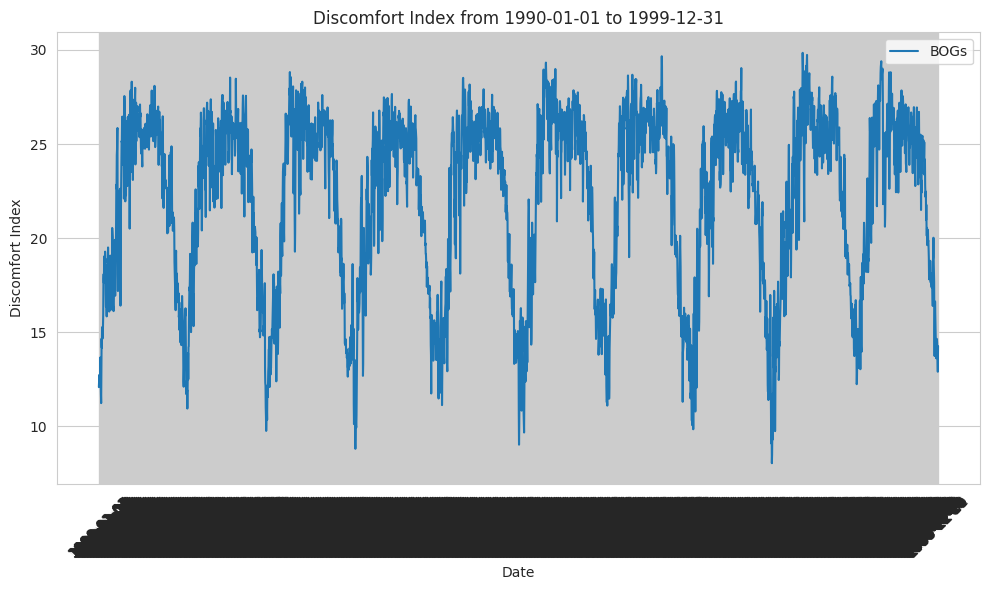

2000-01-01
2009-12-31


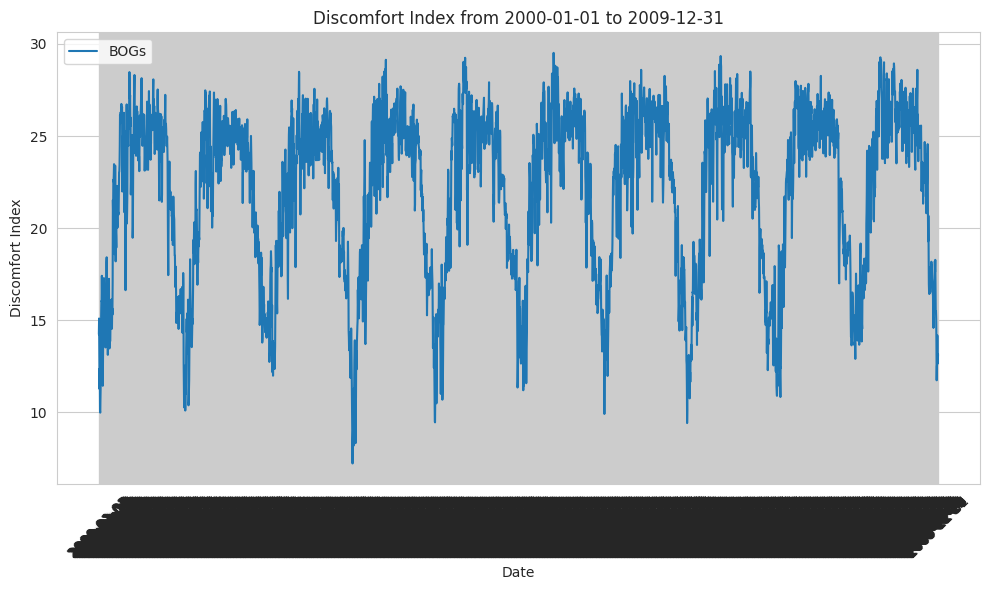

2010-01-01
2019-12-31


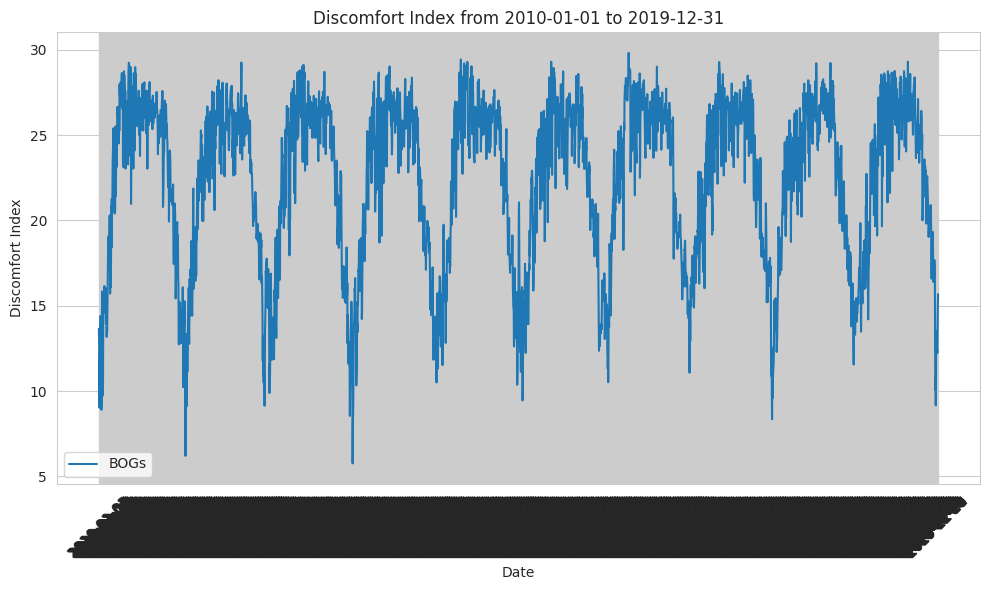

2020-01-01
2030-12-31


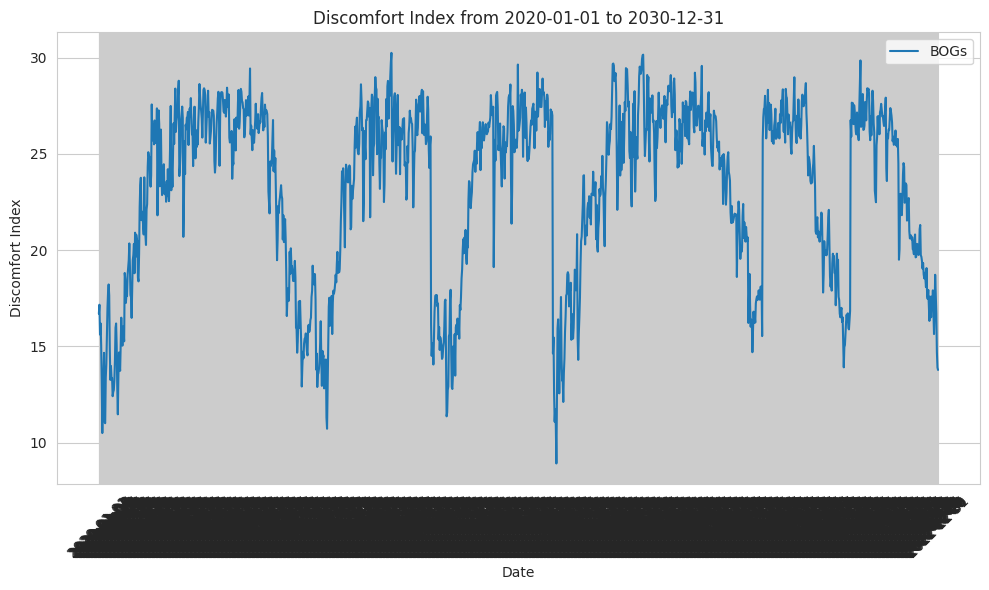

1980-01-01
1989-12-31


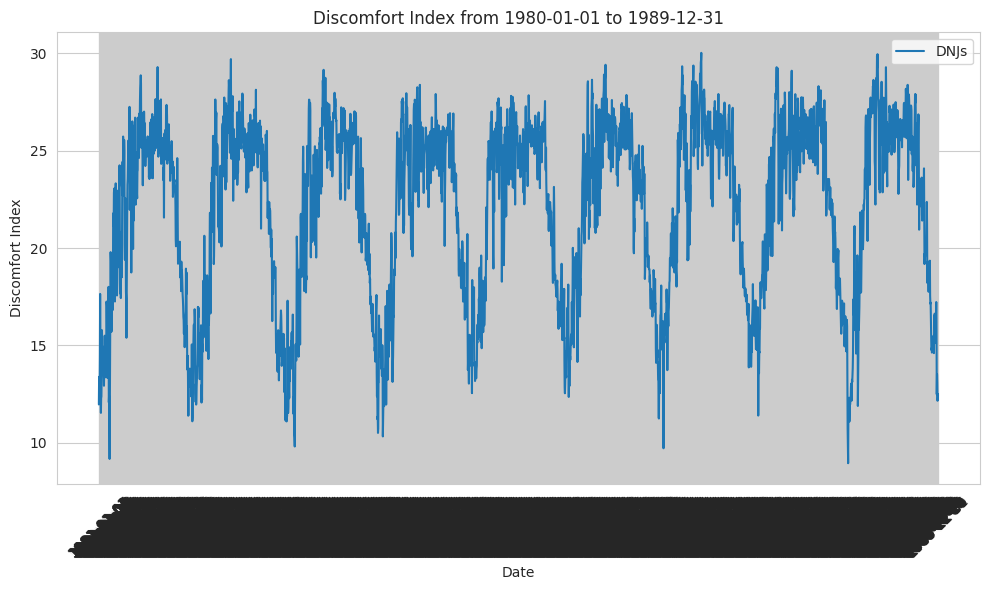

1990-01-01
1999-12-31


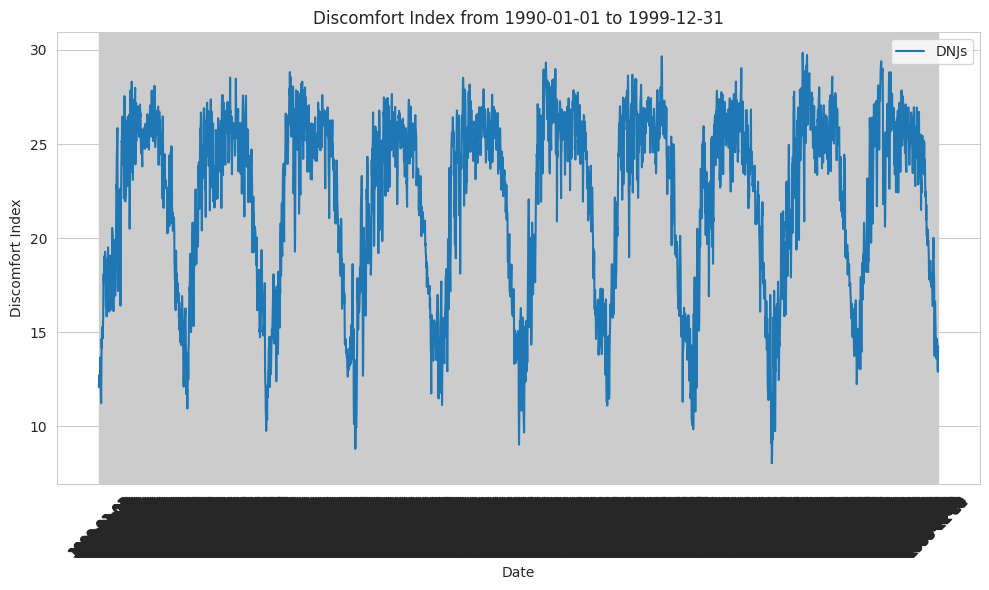

2000-01-01
2009-12-31


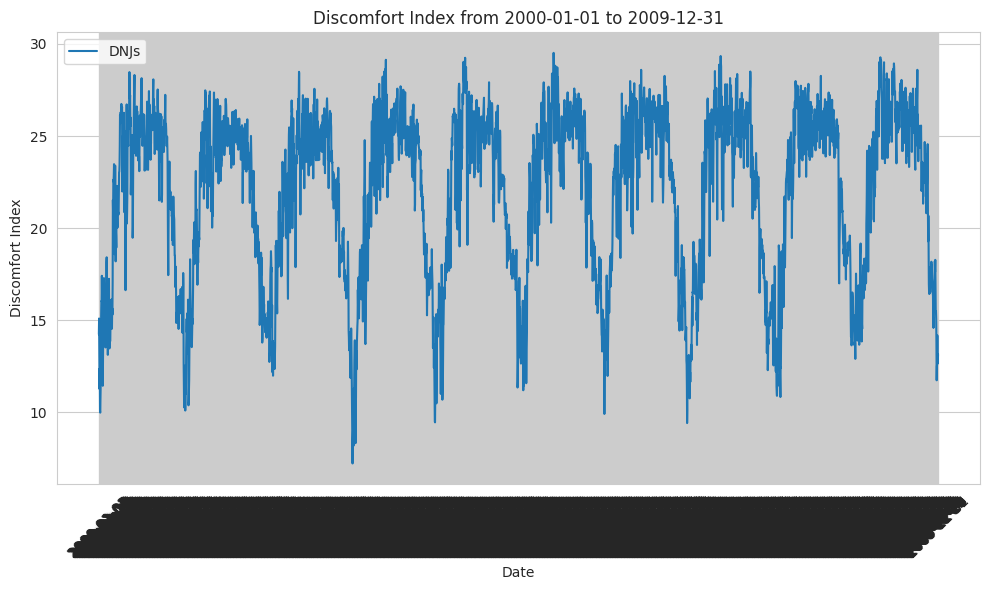

2010-01-01
2019-12-31


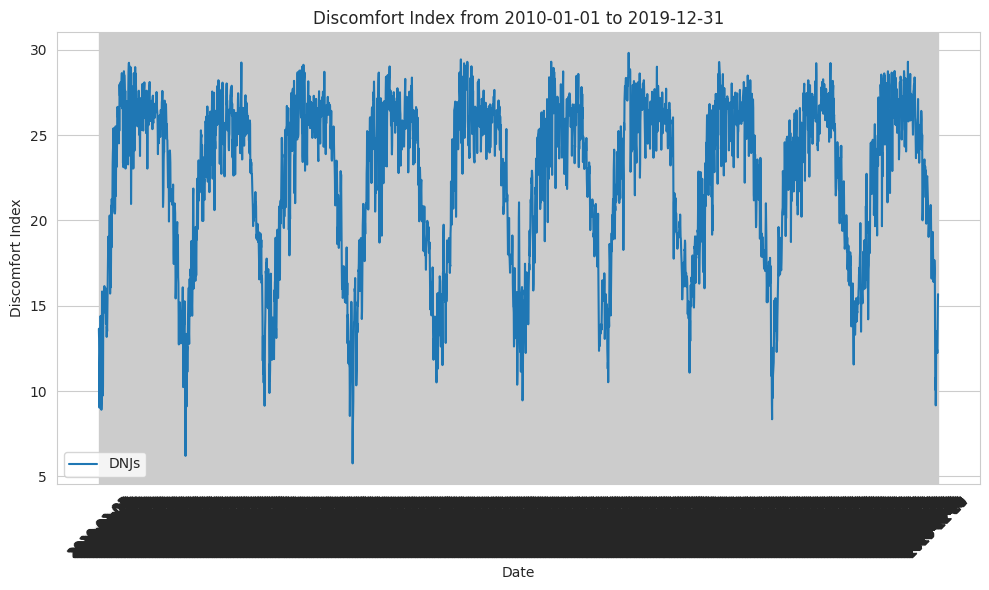

2020-01-01
2030-12-31


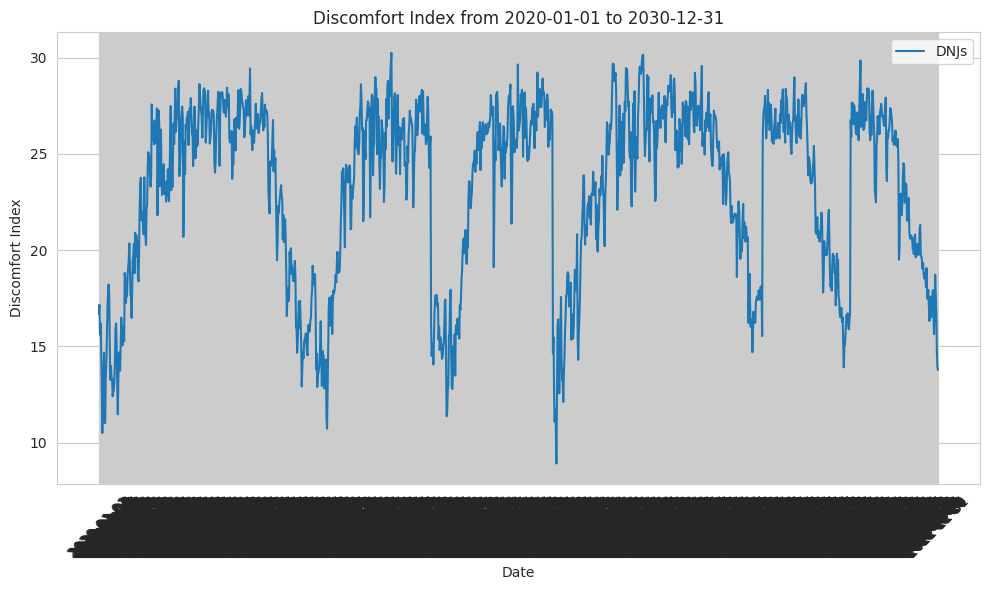

1980-01-01
1989-12-31


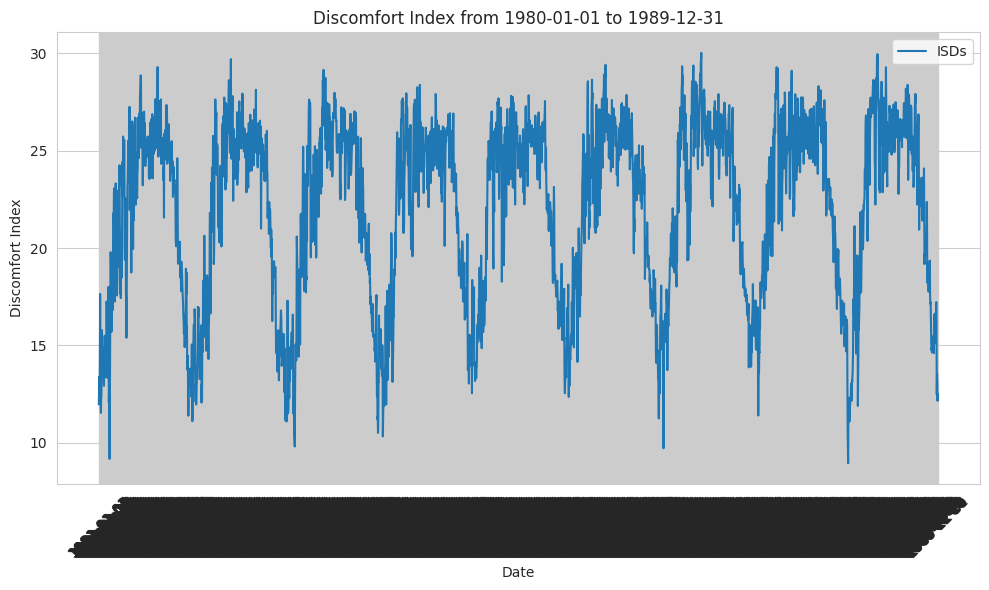

1990-01-01
1999-12-31


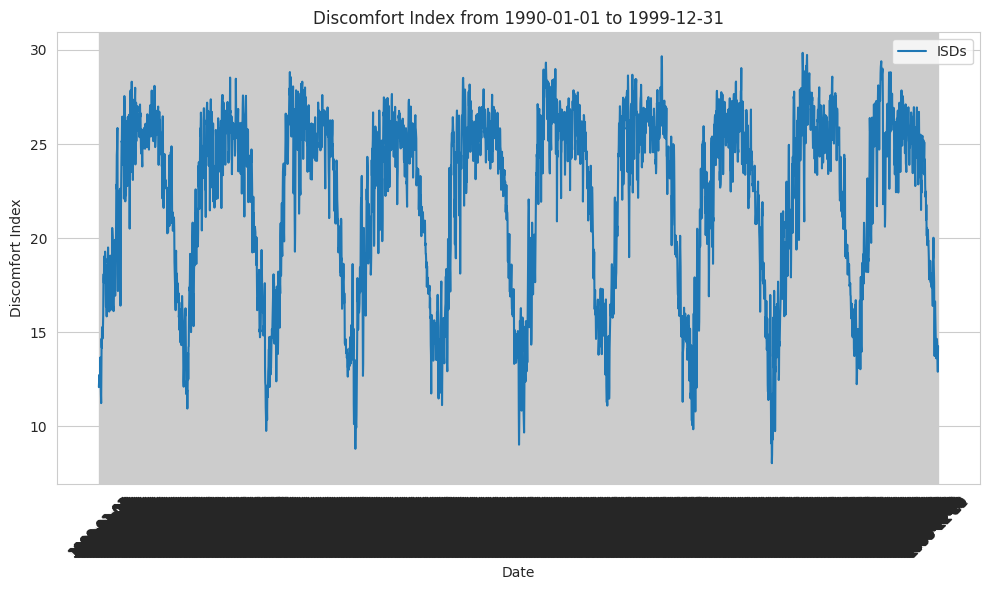

2000-01-01
2009-12-31


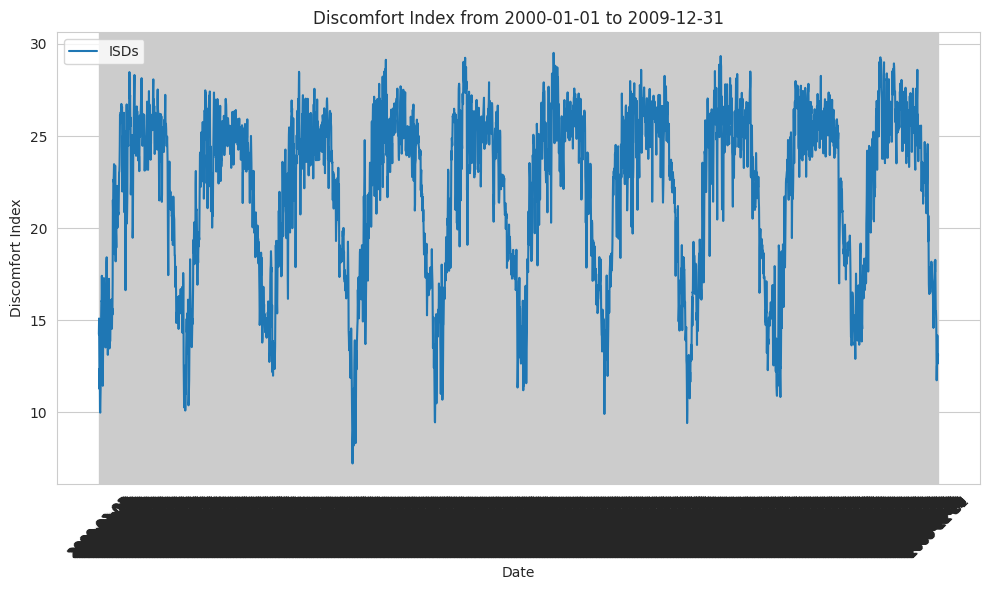

2010-01-01
2019-12-31


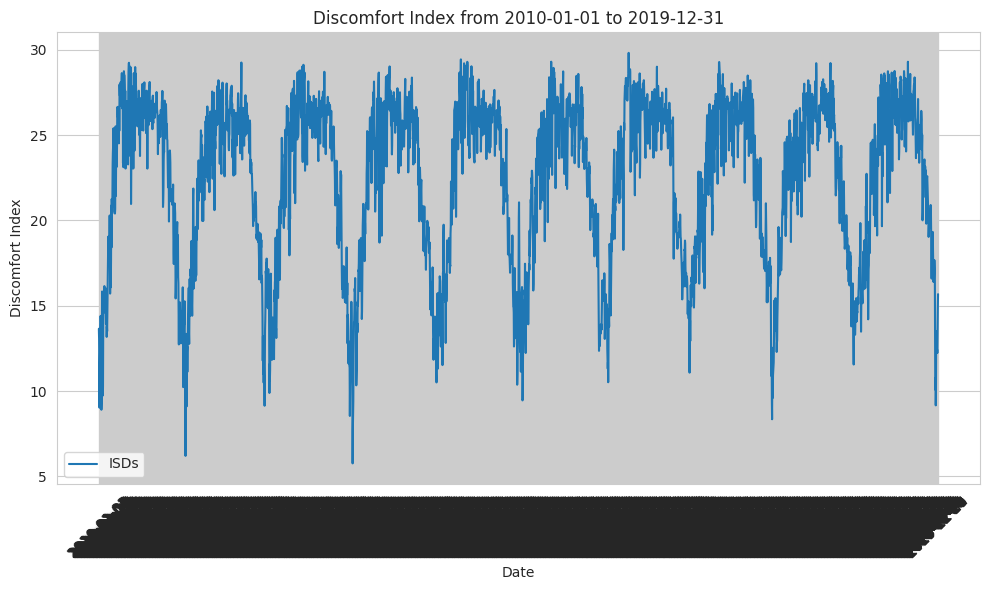

2020-01-01
2030-12-31


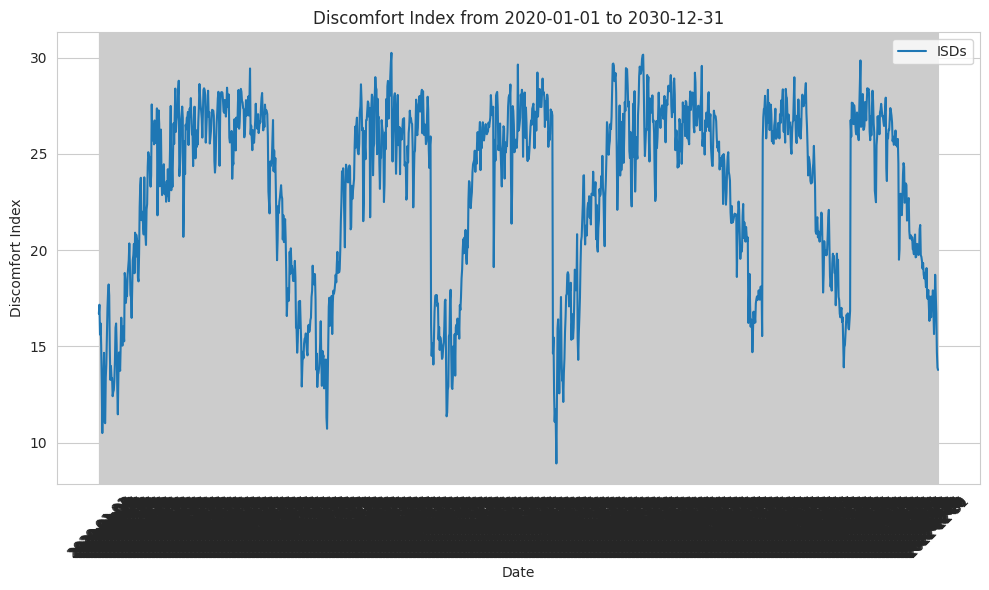

1980-01-01
1989-12-31


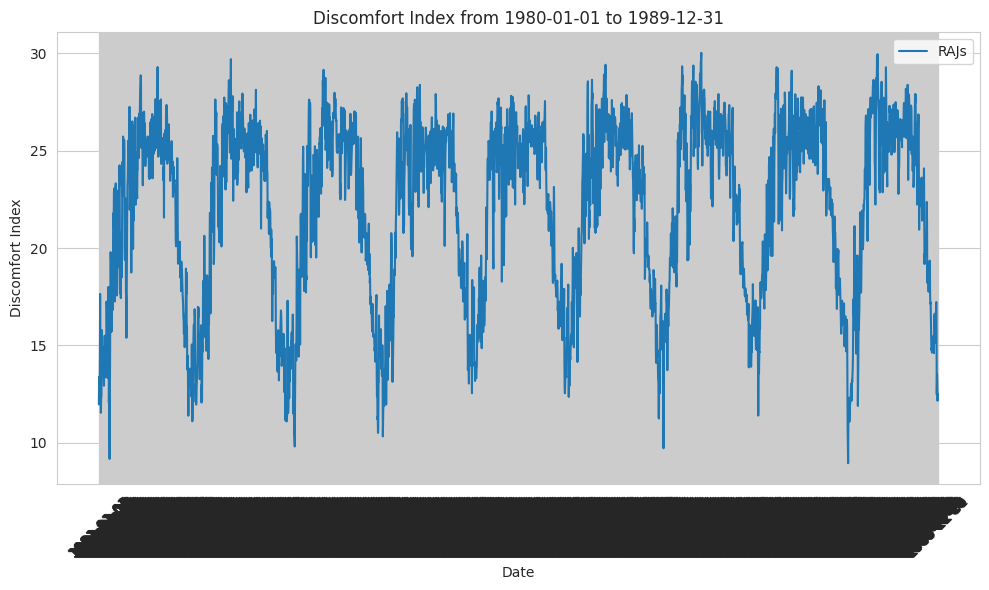

1990-01-01
1999-12-31


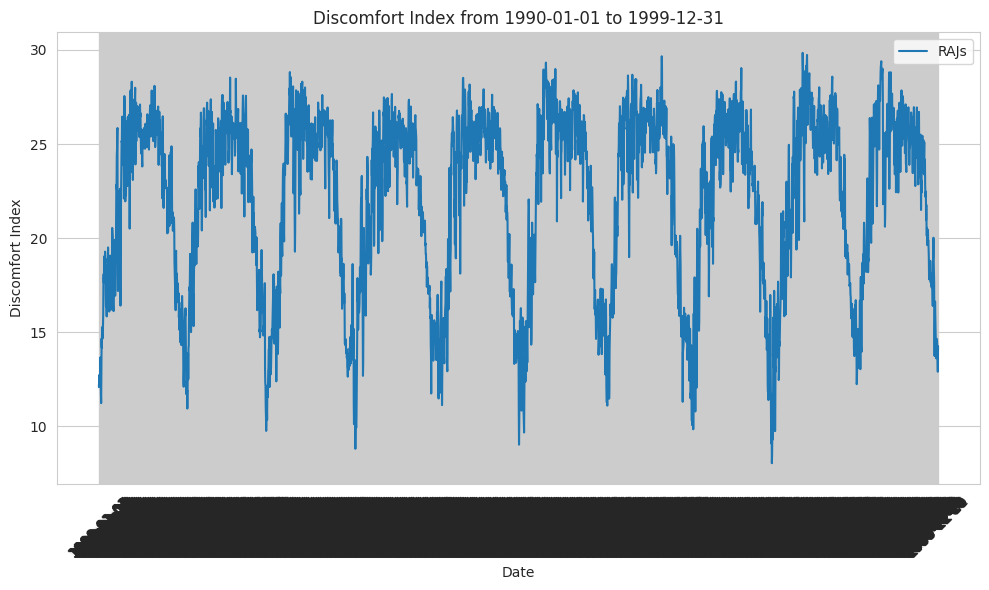

2000-01-01
2009-12-31


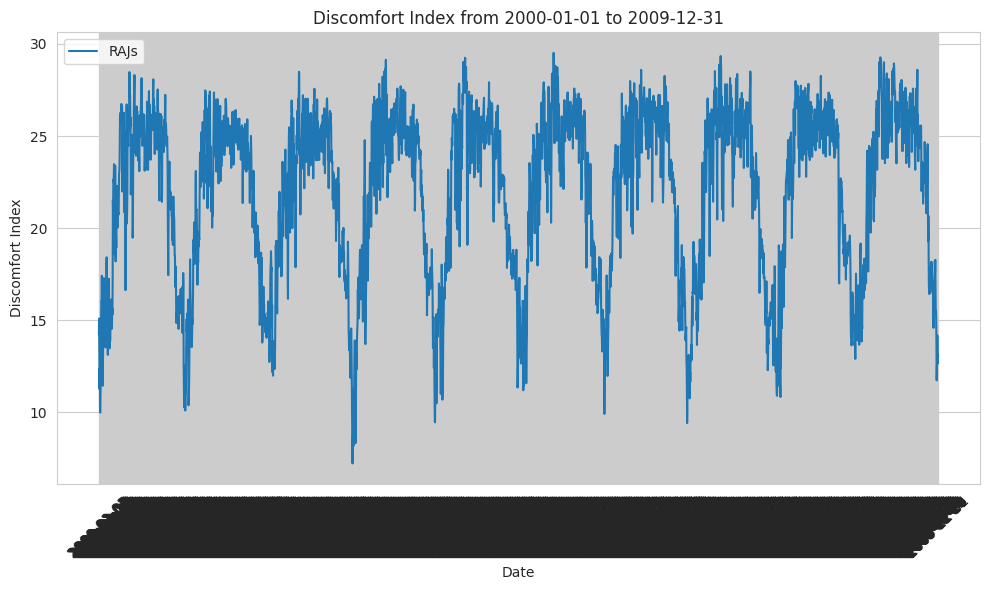

2010-01-01
2019-12-31


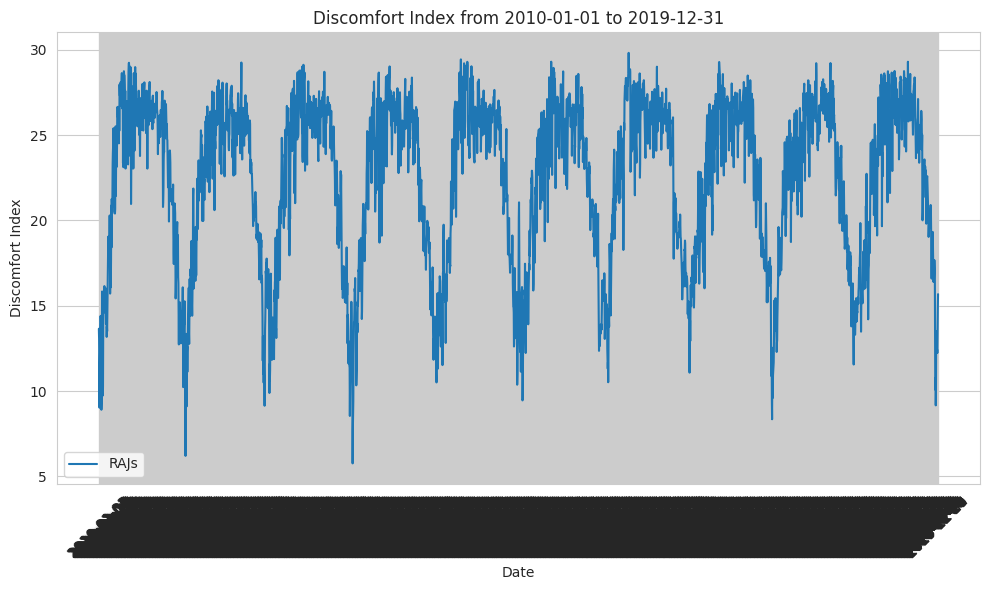

2020-01-01
2030-12-31


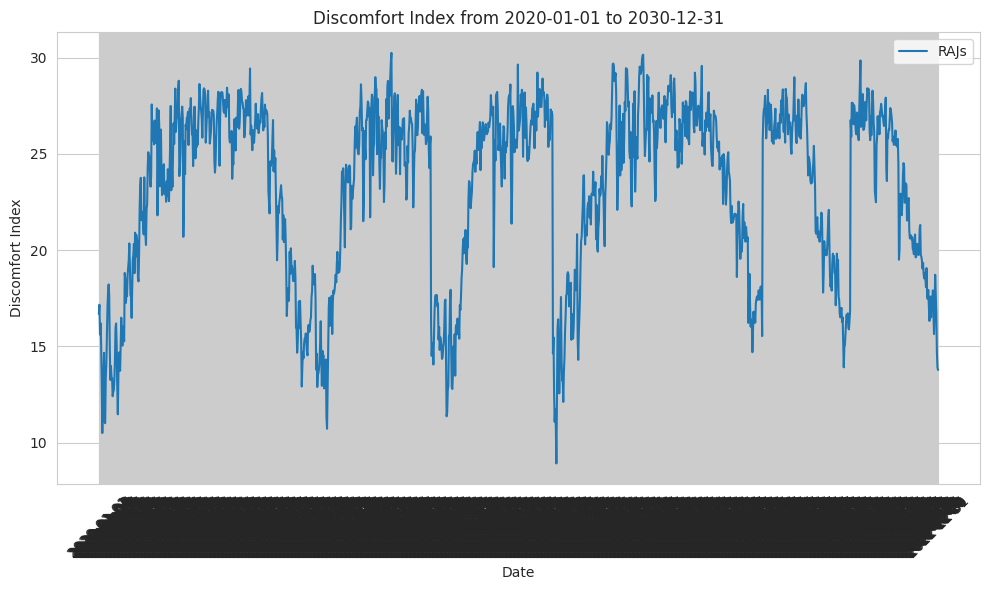

1980-01-01
1989-12-31


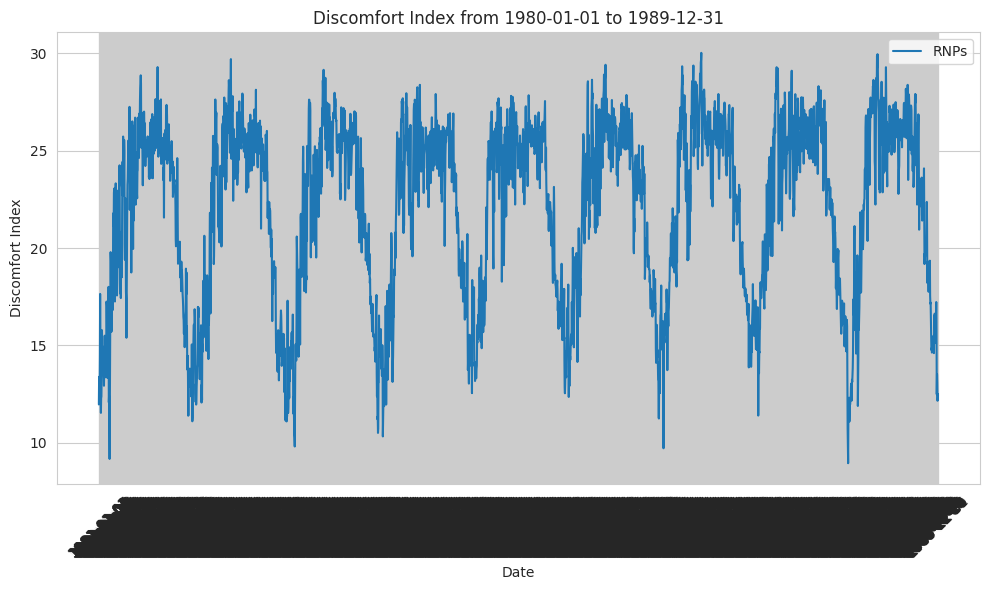

1990-01-01
1999-12-31


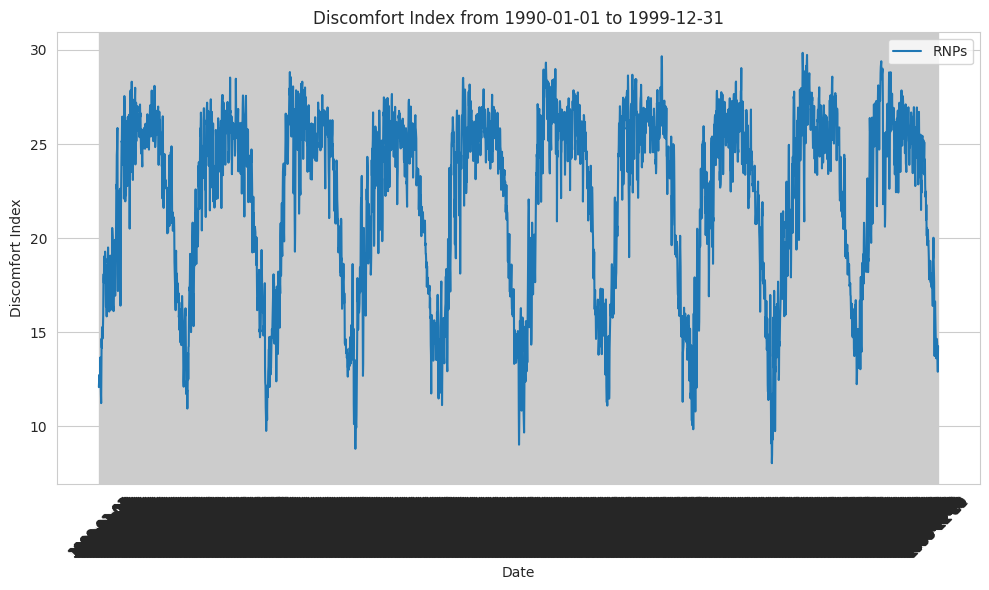

2000-01-01
2009-12-31


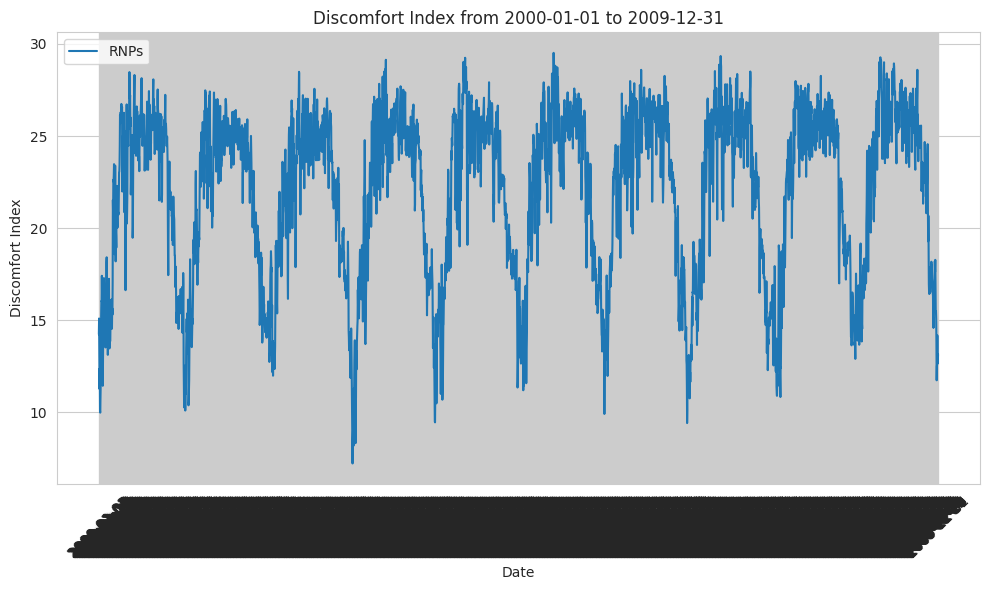

2010-01-01
2019-12-31


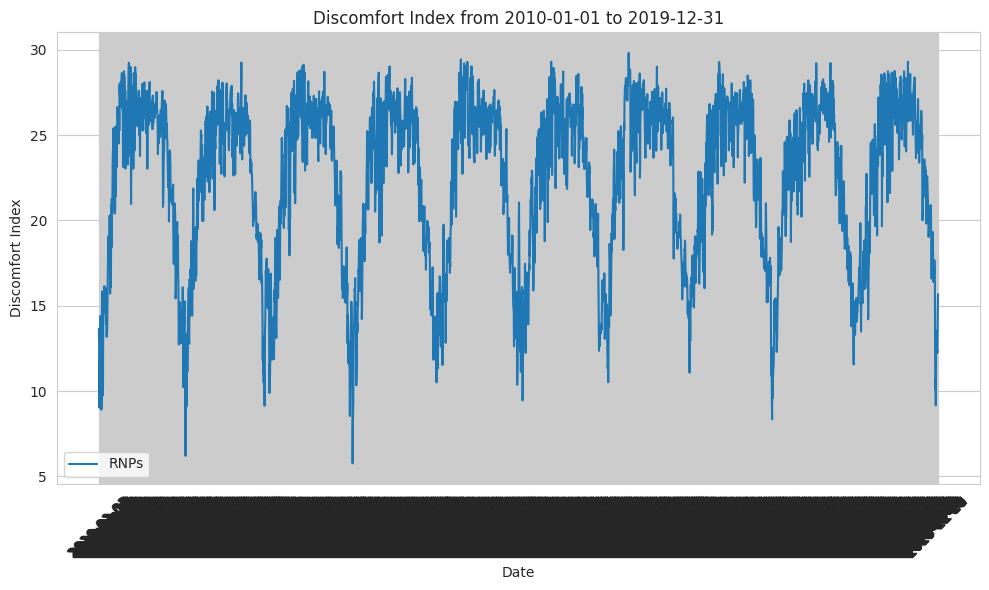

2020-01-01
2030-12-31


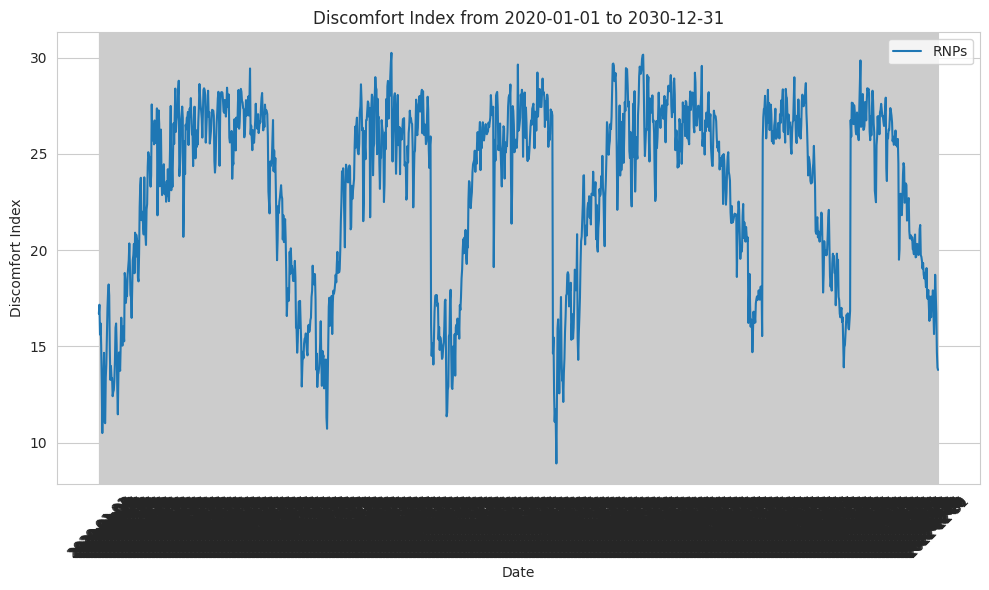

1980-01-01
1989-12-31


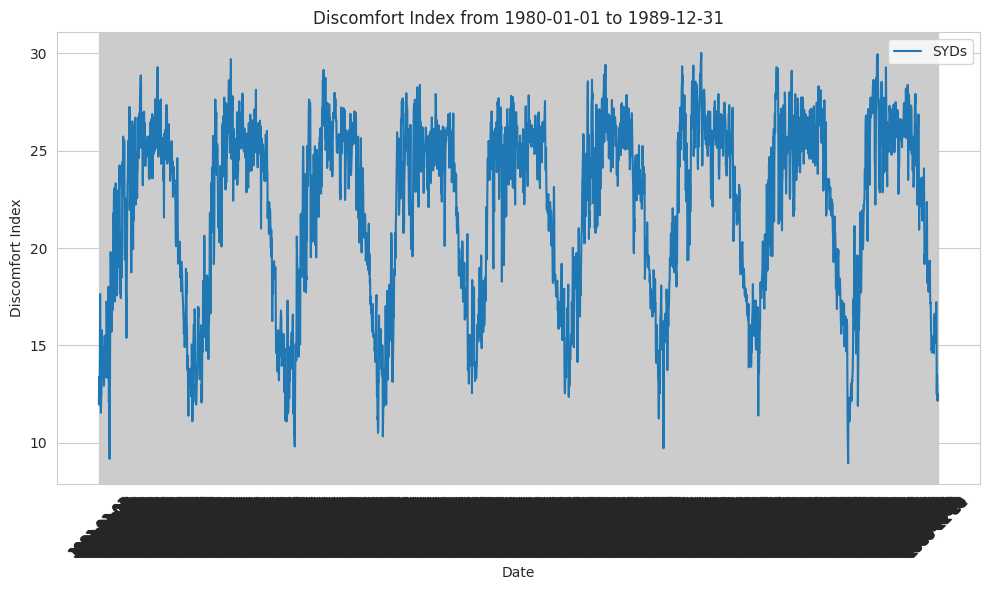

1990-01-01
1999-12-31


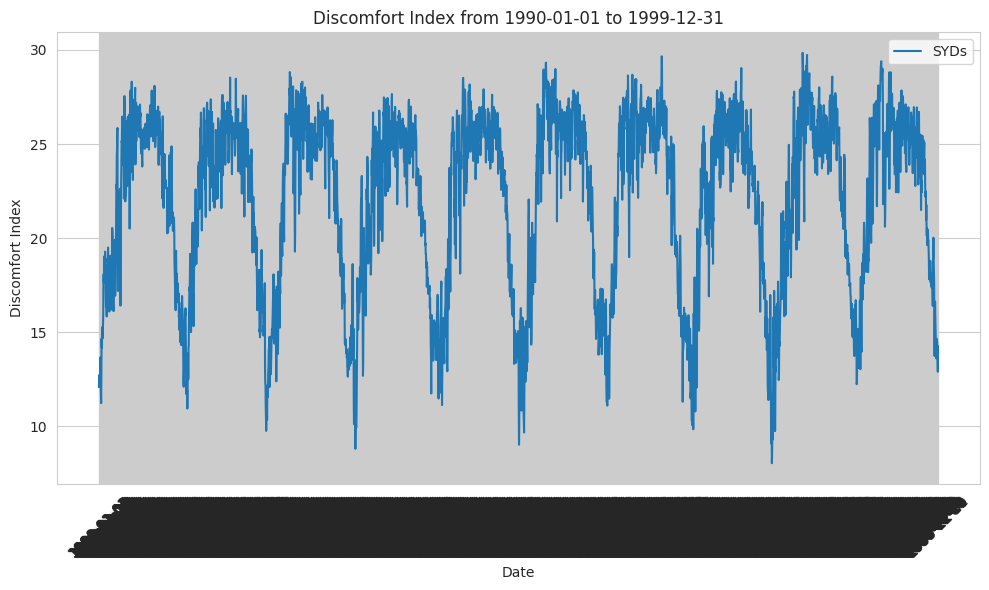

2000-01-01
2009-12-31


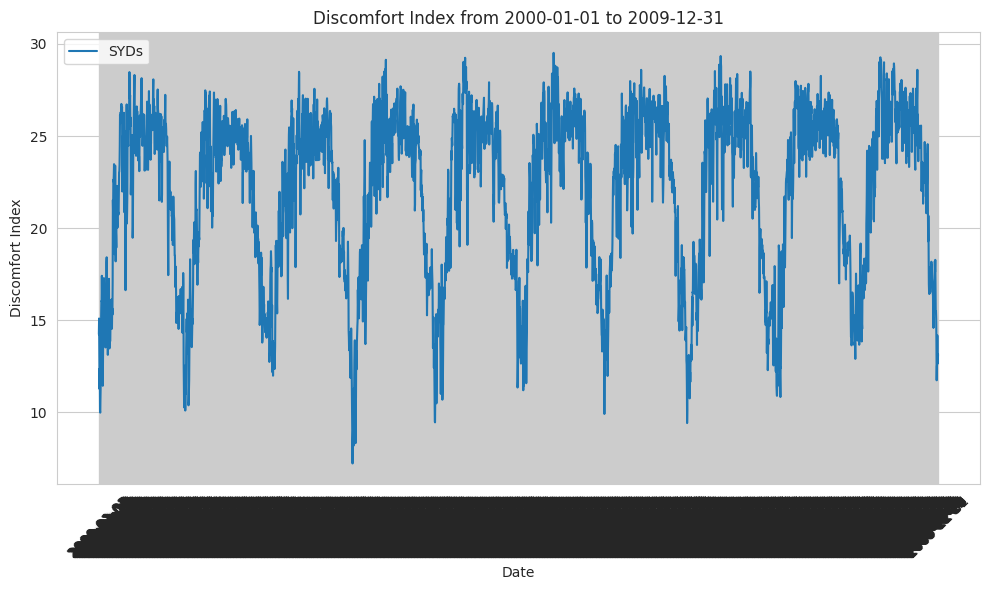

2010-01-01
2019-12-31


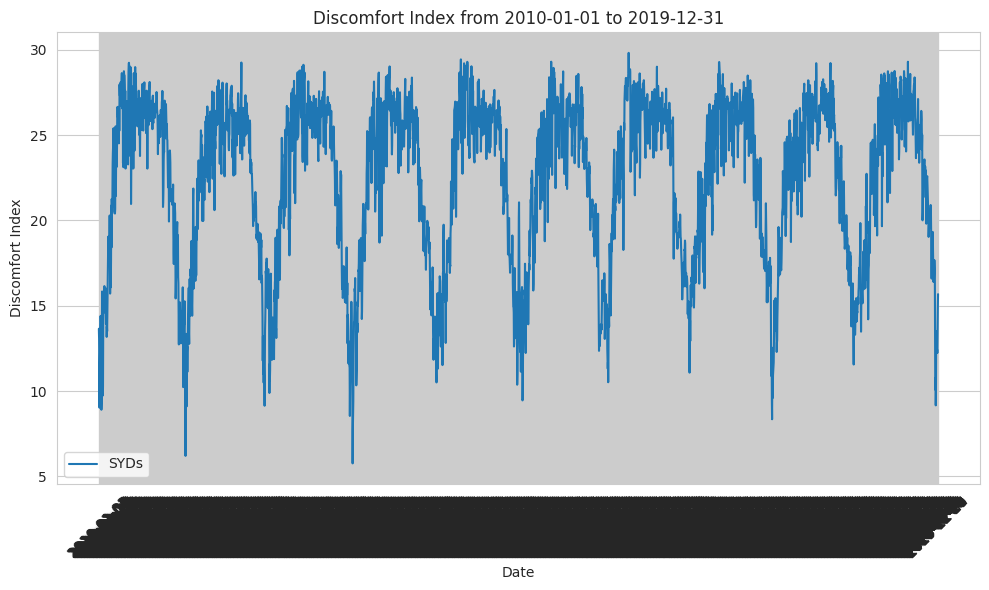

2020-01-01
2030-12-31


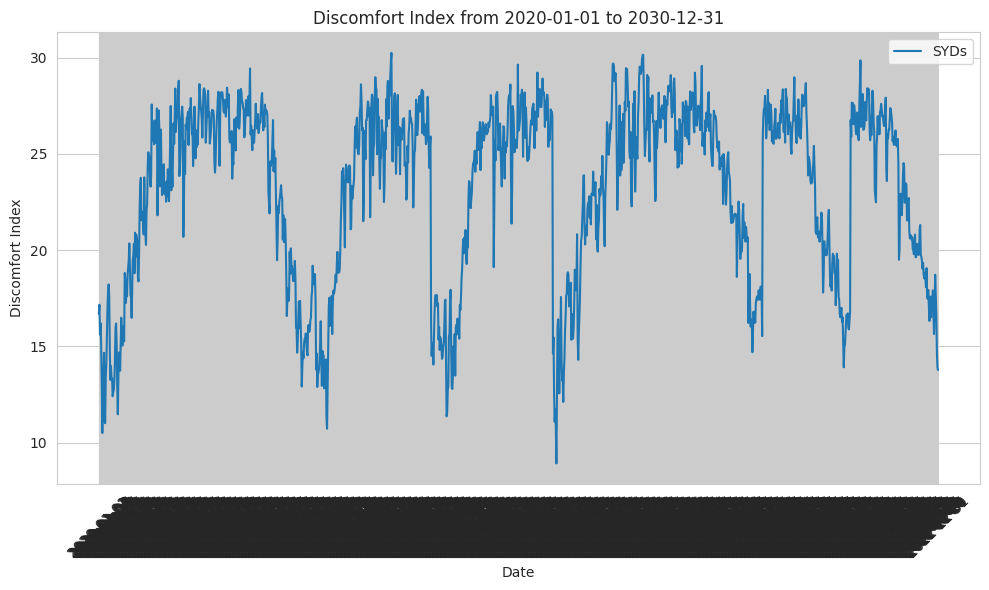

1980-01-01
1989-12-31


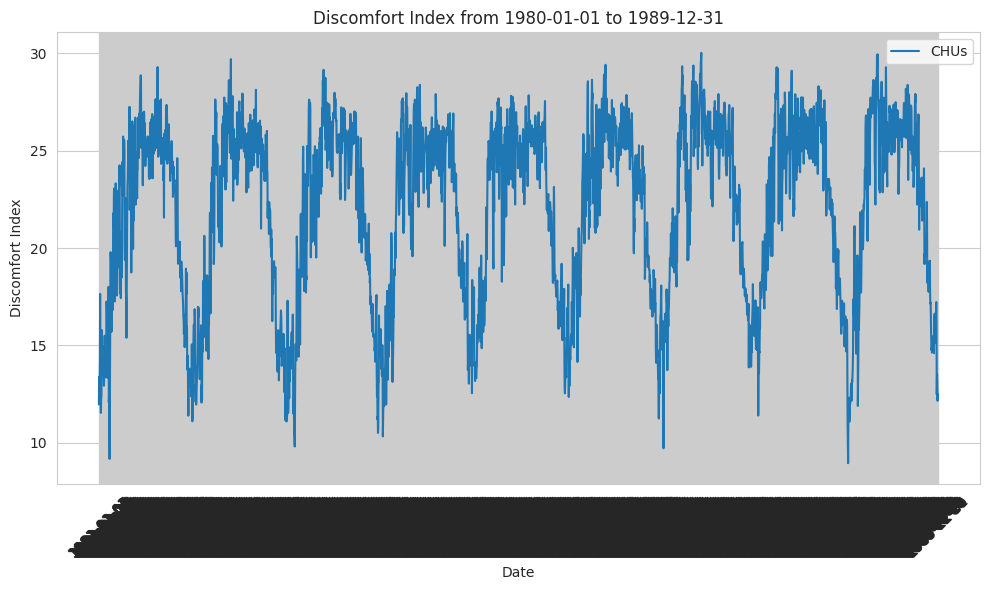

1990-01-01
1999-12-31


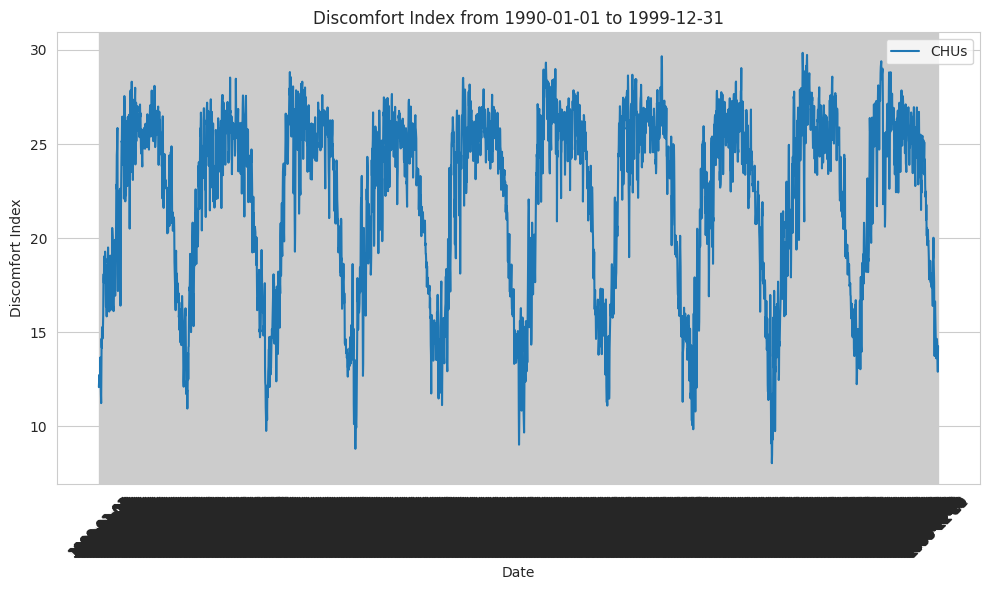

2000-01-01
2009-12-31


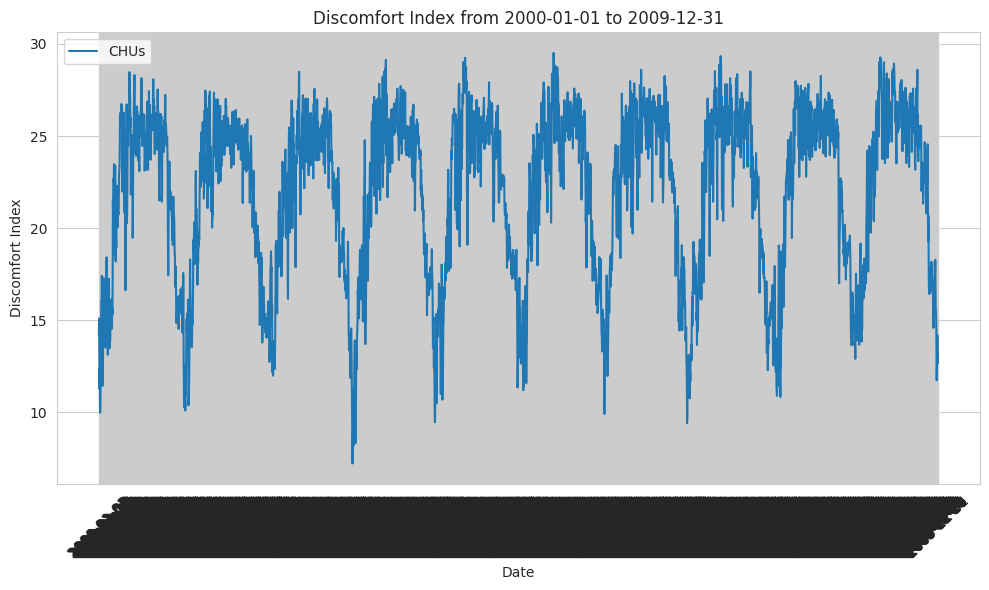

2010-01-01
2019-12-31


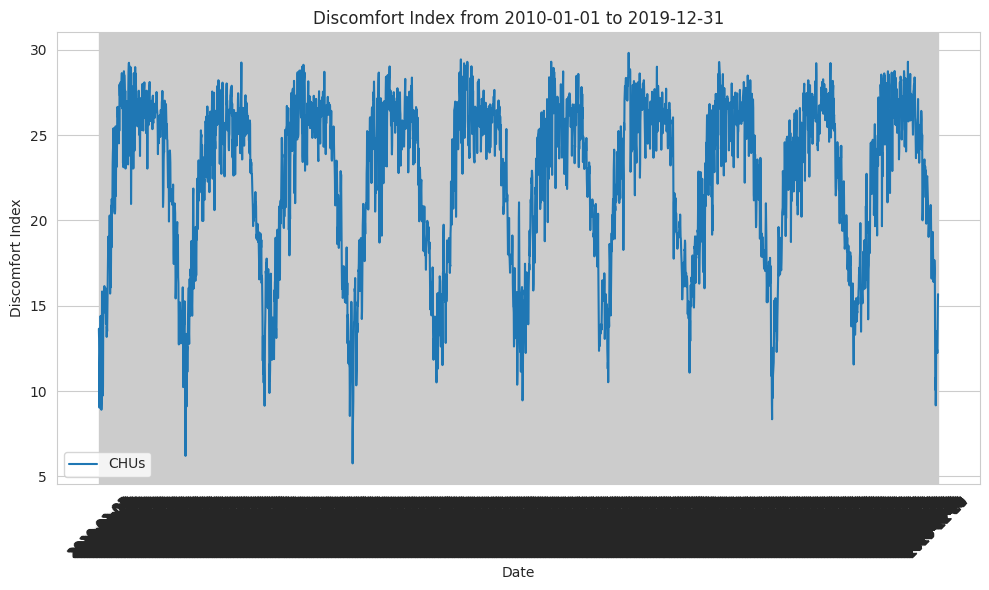

2020-01-01
2030-12-31


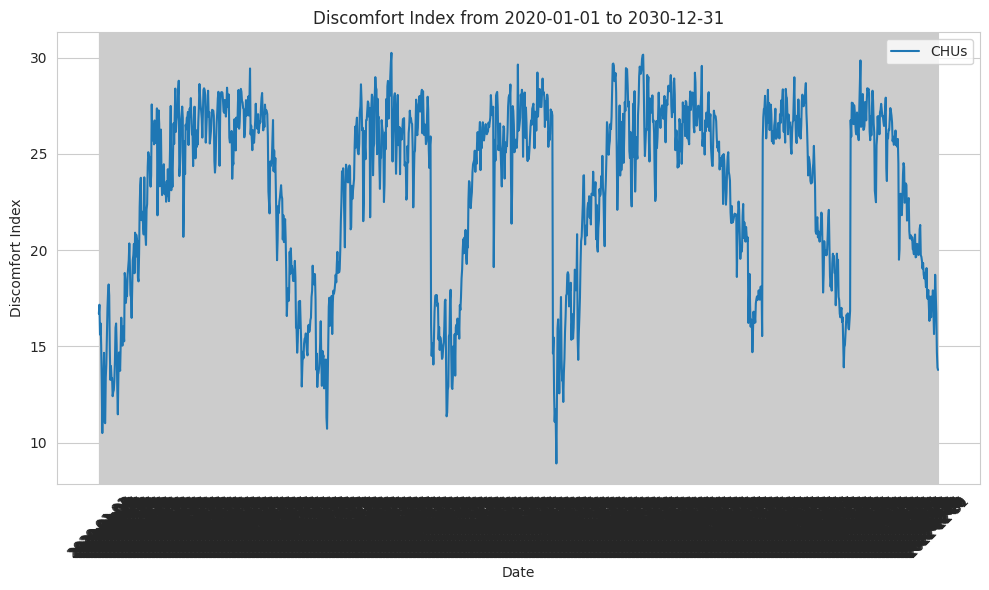

1980-01-01
1989-12-31


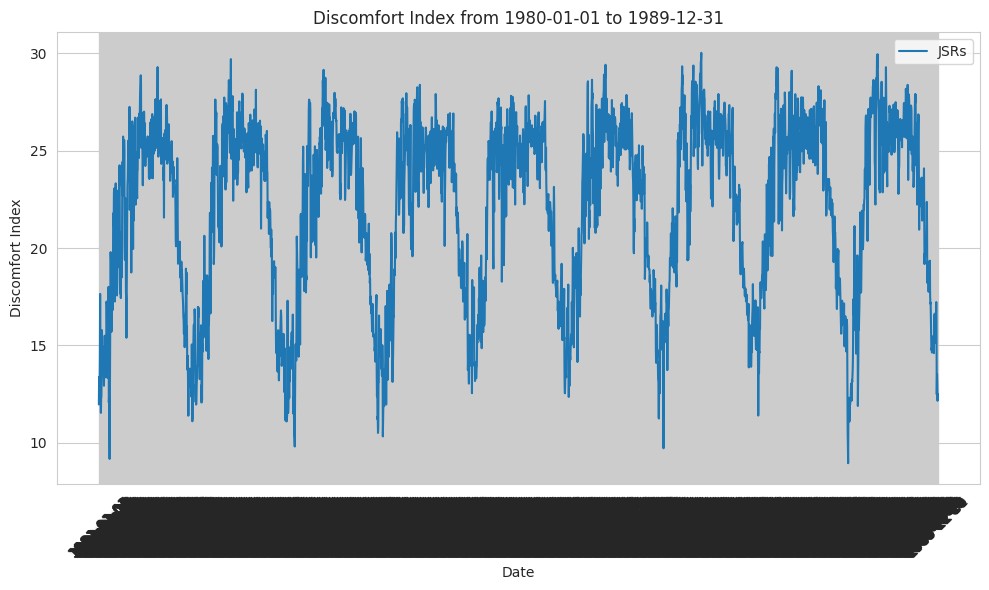

1990-01-01
1999-12-31


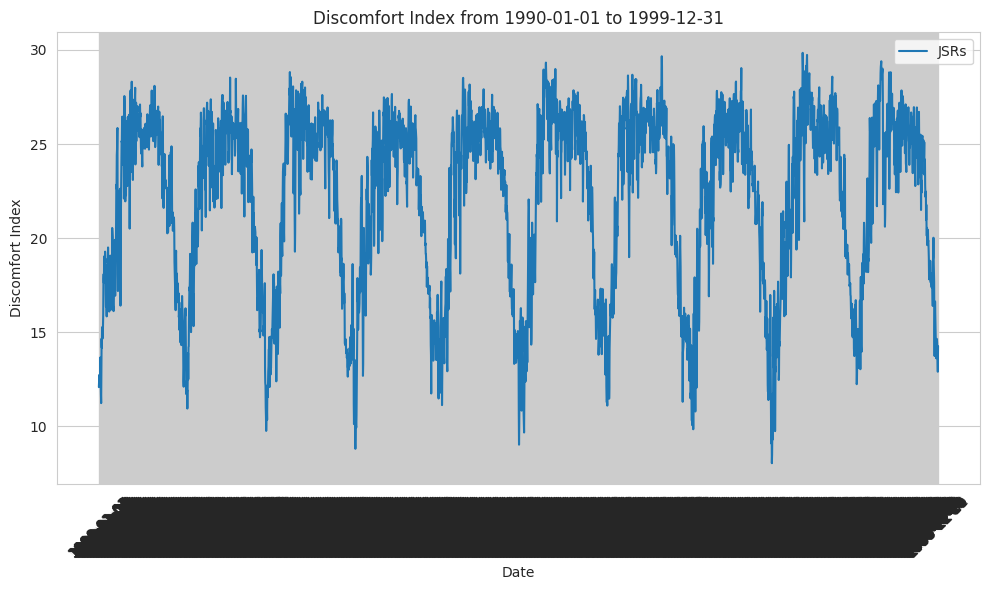

2000-01-01
2009-12-31


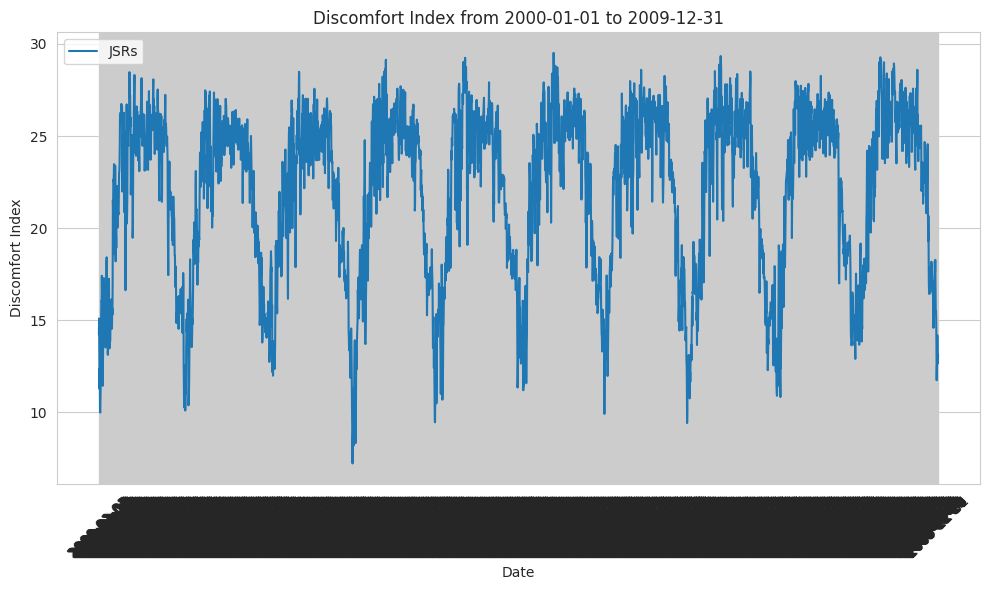

2010-01-01
2019-12-31


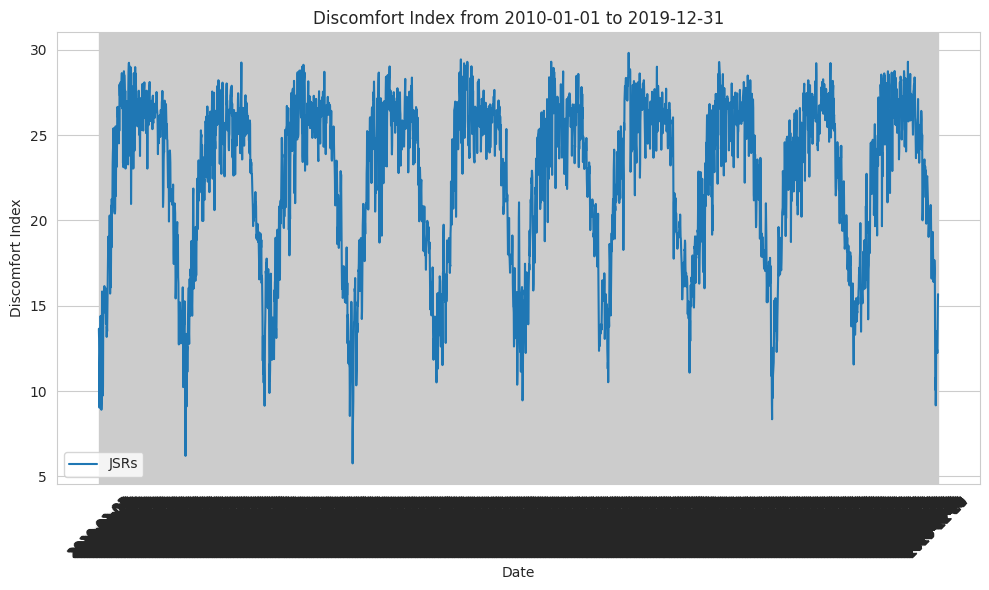

2020-01-01
2030-12-31


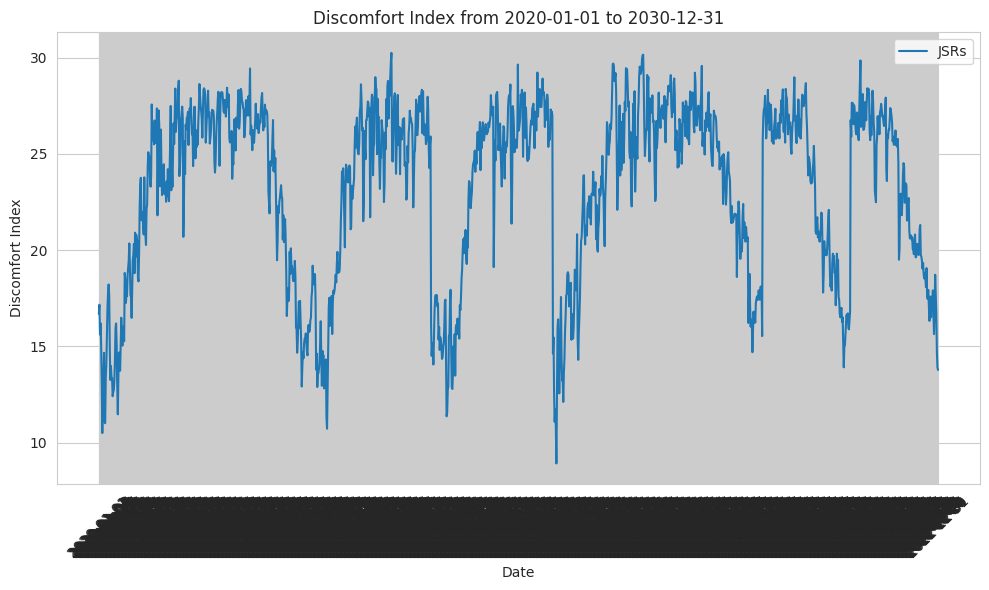

1980-01-01
1989-12-31


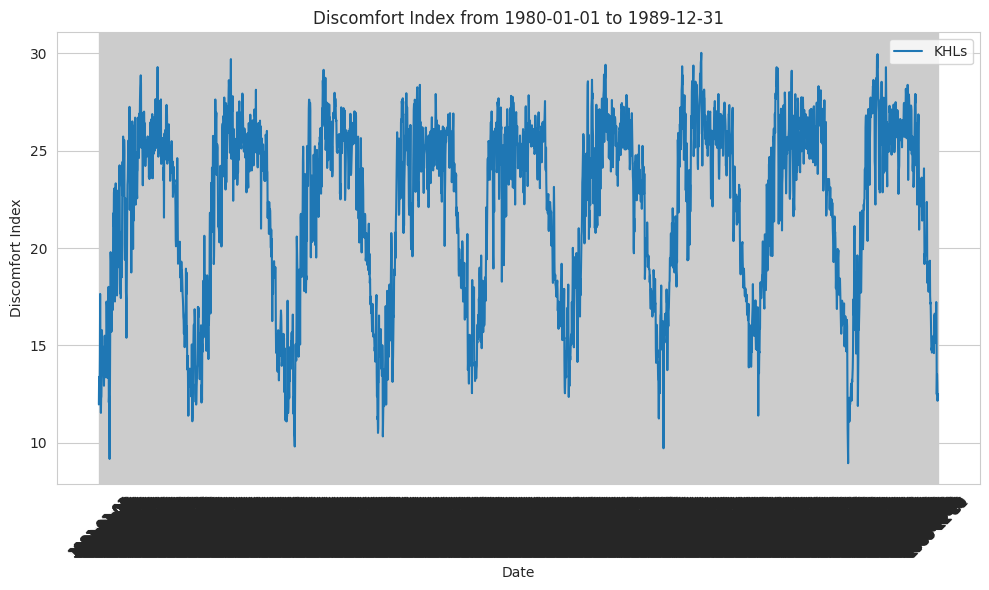

1990-01-01
1999-12-31


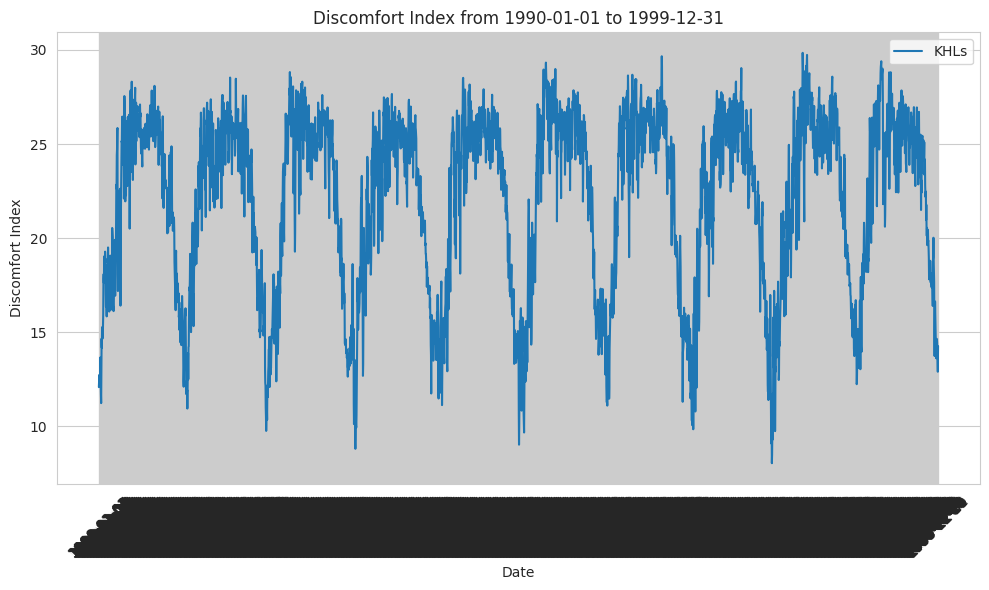

2000-01-01
2009-12-31


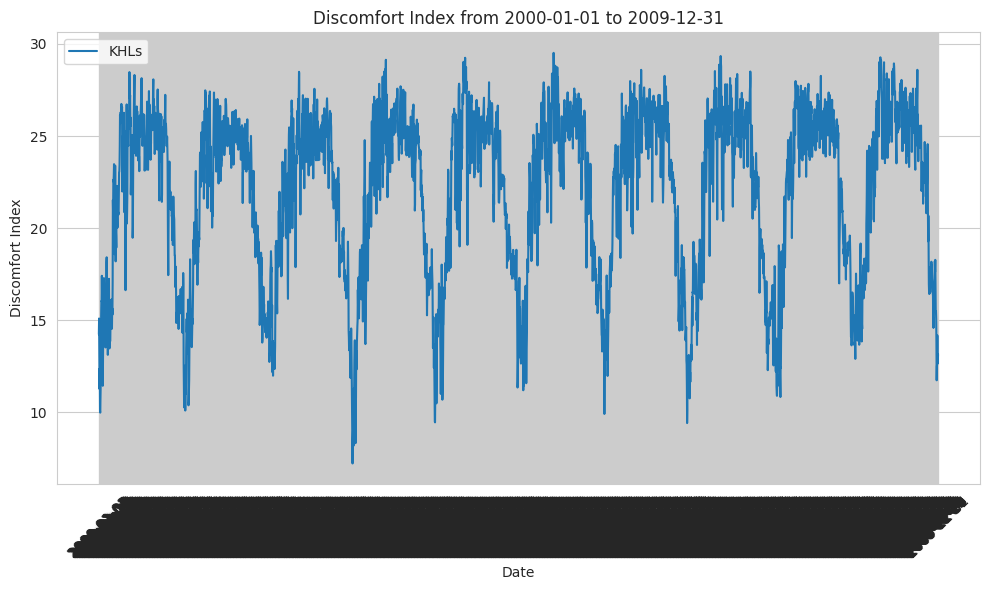

2010-01-01
2019-12-31


In [ ]:
# draw_graph_decades(df_stn_dhk)
for key in region_df:
  # print(region_df[key])
  # print(key)
  draw_graph_decades(region_df[key],key)

# test code

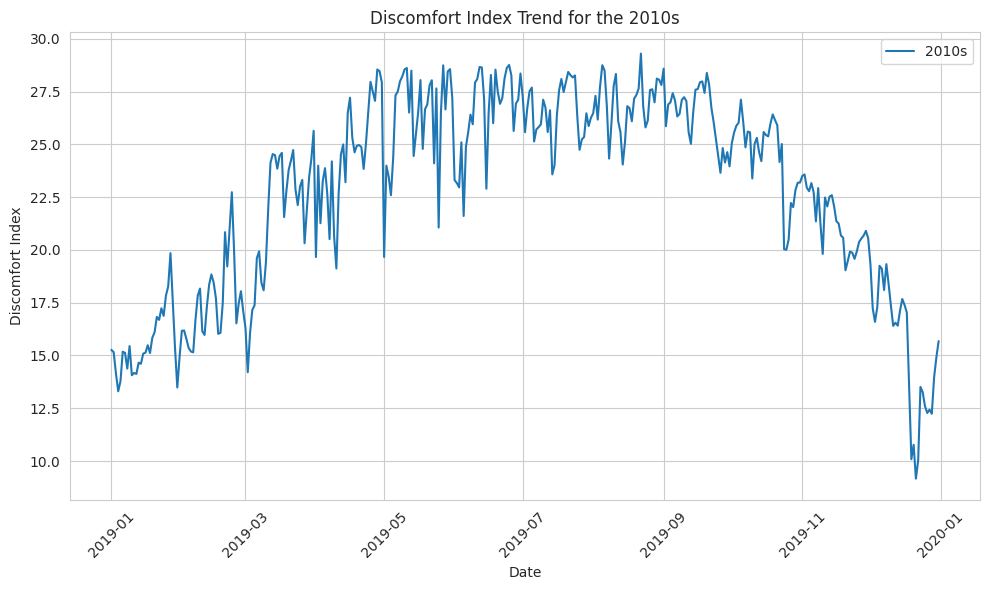

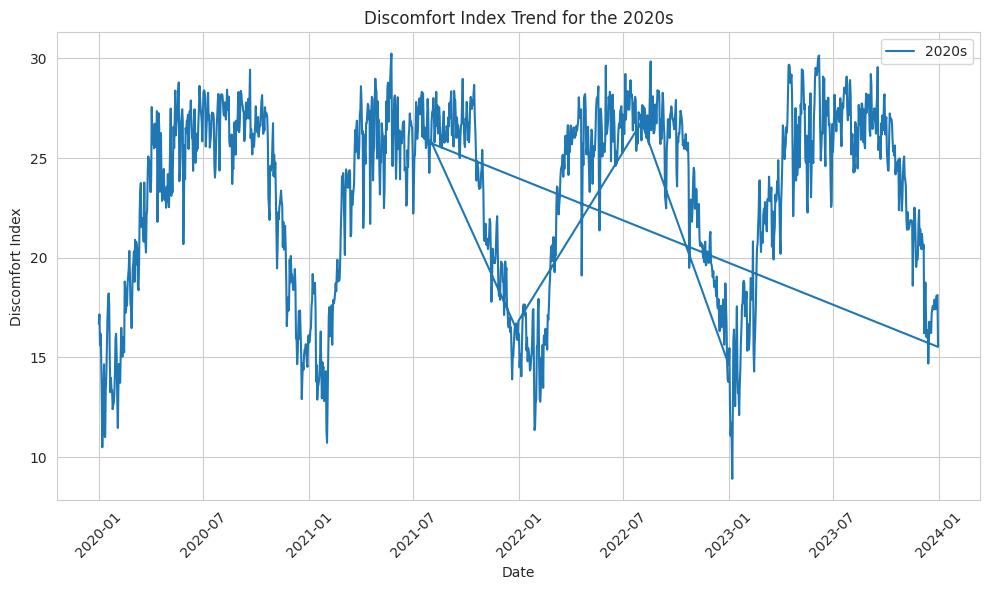

In [ ]:
decades = df['Decade'].unique()
for decade in decades:
  df_decade = df[df['Decade'] == decade]  # Filter the DataFrame for the current decade
  df_decade.to_csv(f'dataset_{decade}s.csv', index=False)  # Save to a CSV file
  plt.figure(figsize=(10, 6))
  plt.plot(df_decade['Date'], df_decade['Discomfort_Index'], label=f'{decade}s')
  plt.title(f'Discomfort Index Trend for the {decade}s')
  plt.xlabel('Date')
  plt.ylabel('Discomfort Index')
  plt.xticks(rotation=45)
  plt.grid(True)
  plt.tight_layout()
  plt.legend()
  plt.show()

In [ ]:
!pip install pymannkendall

In [ ]:
import pymannkendall as mk
from statsmodels.tsa.stattools import adfuller
def kendall_test(df,decade):
  discomfort_indx=df['Discomfort_Index']
  if(len(discomfort_indx)==0):
    print(f"not enough data. Found total: {len(discomfort_indx)}")
    return
  result = mk.original_test(discomfort_indx)
  # result = adfuller(discomfort_indx)
  print(key)
  print(result)
  print("-----------")

In [ ]:
def kendall_test_decades(df,key):
  decades = {
    '1980s': (1980, 1989),
    '1990s': (1990, 1999),
    '2000s': (2000, 2009),
    '2010s': (2010, 2019),
    '2020s': (2020, 2030)
  }
  for decade_name, decade_range in decades.items():
    start_year, end_year = decade_range

    start_date = f'{start_year}-01-01'  # Replace with your desired start date
    end_date = f'{end_year}-12-31'    # Replace with your desired end date
    print(start_date)
    print(end_date)

    df_filtered = df[(df['Date'] >= start_date) & (df['Date'] <= end_date)]
    print(key)
    print(f'Discomfort Index from {start_date} to {end_date}')
    kendall_test(df_filtered,decade_name)

  print("---------------------------------------------------------------")



In [ ]:
from sklearn.linear_model import LinearRegression
import pandas as pd

def find_coefficient_by_decades(df, key):
    # Define the decades and their respective ranges
    decades = {
        '1980s': (1980, 1989),
        '1990s': (1990, 1999),
        '2000s': (2000, 2009),
        '2010s': (2010, 2019),
        '2020s': (2020, 2030)
    }

    # Convert the 'Date' column to datetime format
    df['Date'] = pd.to_datetime(df['Date'])

    for decade_name, decade_range in decades.items():
        start_year, end_year = decade_range

        # Define the start and end dates for filtering
        start_date = f'{start_year}-01-01'
        end_date = f'{end_year}-12-31'

        # Filter the dataframe for the current decade
        df_filtered = df[(df['Date'] >= start_date) & (df['Date'] <= end_date)]

        # Check if there is enough data to perform regression
        if df_filtered.empty:
            print(f"No data available for the decade: {decade_name}")
            continue

        # Convert date to numeric format (e.g., days since the earliest date in the filtered data)
        df_filtered['date_numeric'] = (df_filtered['Date'] - df_filtered['Date'].min()).dt.days

        # Define the independent variable (date_numeric) and dependent variable (key)
        X = df_filtered[['date_numeric']]
        y = df_filtered['Discomfort_Index']

        # Initialize and fit the linear regression model
        model = LinearRegression()
        model.fit(X, y)

        # Get the coefficient
        coefficient = model.coef_[0]
        intercept=model.intercept_

        # Print the coefficient for the current decade
        print(f"Coefficient for {key} from {start_date} to {end_date} ({decade_name}) --> slope: {coefficient} and intercept: {intercept}")

    print("---------------------------------------------------------------")


In [ ]:
import warnings

# Ignore all warnings
warnings.filterwarnings('ignore')

In [ ]:
for key in region_df:
  # print(region_df[key])
  # print(key)
  # kendall_test_decades(region_df[key],key)
  find_coefficient_by_decades(region_df[key],key)


Coefficient for DHK from 1980-01-01 to 1989-12-31 (1980s) --> slope: 0.0005447018928491594 and intercept: 21.293003679613786
Coefficient for DHK from 1990-01-01 to 1999-12-31 (1990s) --> slope: 0.00024308427301315103 and intercept: 21.750680656328626
Coefficient for DHK from 2000-01-01 to 2009-12-31 (2000s) --> slope: 0.0003468511658377516 and intercept: 21.49087999291583
Coefficient for DHK from 2010-01-01 to 2019-12-31 (2010s) --> slope: 0.00019576277424566453 and intercept: 22.190466380915748
Coefficient for DHK from 2020-01-01 to 2030-12-31 (2020s) --> slope: 0.0010223153681339686 and intercept: 22.446624223425108
---------------------------------------------------------------
Coefficient for TNG from 1980-01-01 to 1989-12-31 (1980s) --> slope: 0.0010182281908545688 and intercept: 21.037210758937785
Coefficient for TNG from 1990-01-01 to 1999-12-31 (1990s) --> slope: 0.0002944533040576276 and intercept: 21.132164431011255
Coefficient for TNG from 2000-01-01 to 2009-12-31 (2000s) --

In [ ]:
import matplotlib.pyplot as plt
def temp_plot(df, key):
  plt.figure(figsize=(16, 8))
  plt.plot(df['Date'], df['MaxT'], marker='o',  label=f'Max Temp',color='red')
  plt.plot(df['Date'], df['MinT'], marker='^',  label=f'Min Temp',color='blue')
  plt.plot(df['Date'], df['AvgT'], marker='s',  label=f'Avg Temp',color='green')

  # Customize the plot
  plt.title(f'Temperature Variations of {key}')
  plt.xlabel('Date')
  plt.ylabel('Temperature (°C)')
  plt.legend(loc='best')
  plt.grid(True)

  # Display the plot
  plt.show()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def temp_plot2(df, key):
    # print(df.info())
    temp_df=df
    # Ensure 'Date' is in datetime format
    temp_df['Date'] = pd.to_datetime(temp_df['Date'])

    # Drop non-numeric columns
    numeric_df = temp_df.select_dtypes(include=['float64', 'int64'])

    # Set 'Date' as the index for resampling
    temp_df.set_index('Date', inplace=True)
    numeric_df.set_index(temp_df.index, inplace=True)

    # Aggregate the data to get one average temperature point per year
    yearly_avg = numeric_df.resample('Y').mean()

    # Plotting
    plt.figure(figsize=(16, 8))
    # plt.plot(temp_df.index, temp_df['MaxT'], marker='o', label='Max Temp', color='red')
    # plt.plot(temp_df.index, temp_df['MinT'], marker='^', label='Min Temp', color='blue')
    # plt.plot(temp_df.index, temp_df['AvgT'], marker='s', label='Avg Temp', color='green')

    # Plot the yearly average temperature as points
    plt.plot(yearly_avg.index, yearly_avg['MaxT'], marker='o', color='red', linestyle='', label='Yearly Max Temp')
    plt.plot(yearly_avg.index, yearly_avg['MinT'], marker='^', color='blue', linestyle='', label='Yearly Min Temp')
    plt.plot(yearly_avg.index, yearly_avg['AvgT'], marker='s', color='green', linestyle='', label='Yearly Avg Temp')

    # Customize the plot
    plt.title(f'Temperature Variations of {key}')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend(loc='best')
    plt.grid(True)

    # Display the plot
    plt.show()


In [ ]:
region_df

{'DHK':         Unnamed: 0        Date  STN  MaxT  MinT   AvgT  Rainfall  Humidity  \
 0                0  1981-01-01  DHK  23.9  10.7  17.30         0        69   
 1                1  1981-01-02  DHK  24.4  12.7  18.55         0        69   
 2                2  1981-01-03  DHK  24.6  12.5  18.55         0        70   
 3                3  1981-01-04  DHK  25.6  10.6  18.10         0        70   
 4                4  1981-01-05  DHK  27.2  12.1  19.65         0        67   
 ...            ...         ...  ...   ...   ...    ...       ...       ...   
 514126      514126  2022-12-27  DHK  24.7  18.8  21.75         4        85   
 514127      514127  2022-12-28  DHK  24.5  17.7  21.10         0        81   
 514128      514128  2022-12-29  DHK  24.2  14.5  19.35         0        79   
 514129      514129  2022-12-30  DHK  22.2  14.7  18.45         0        83   
 514130      514130  2022-12-31  DHK  22.6  13.9  18.25         0        85   
 
         Discomfort_Index  
 0             

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

def temp_plot23(df, key):
    # Ensure 'Date' is in datetime format
    df['Date'] = pd.to_datetime(df['Date'])

    # Drop non-numeric columns
    numeric_df = df.select_dtypes(include=['float64', 'int64'])

    # Set 'Date' as the index for resampling
    df.set_index('Date', inplace=True)
    numeric_df.set_index(df.index, inplace=True)

    # Aggregate the data to get one average temperature point per year
    yearly_avg = numeric_df.resample('Y').mean()

    # Function to fit and plot a regression line
    def plot_regression(x, y, color, label):
        # x = x.values.reshape(-1, 1)  # Reshape for sklearn
        mask = y.notna()
        x = x[mask]
        y = y[mask]
        x = x.map(pd.Timestamp.toordinal).values.reshape(-1, 1)
        model = LinearRegression()
        model.fit(x, y)
        y_pred = model.predict(x)

        x = pd.Series(x.flatten()) # Flatten the array and convert to Series
        x = x.map(pd.Timestamp.fromordinal) #
        plt.plot(x, y_pred, color=color, linestyle='--', label=f'{label} Regression Line')

    # Plotting
    plt.figure(figsize=(16, 8))

    # Plot yearly average temperature as points
    plt.plot(yearly_avg.index, yearly_avg['MaxT'], marker='o', color='red', linestyle='', label='Yearly Max Temp')
    plt.plot(yearly_avg.index, yearly_avg['MinT'], marker='^', color='blue', linestyle='', label='Yearly Min Temp')
    plt.plot(yearly_avg.index, yearly_avg['AvgT'], marker='s', color='green', linestyle='', label='Yearly Avg Temp')

    # Fit and plot regression lines
    plot_regression(yearly_avg.index, yearly_avg['MaxT'], 'red', 'Max Temp')
    plot_regression(yearly_avg.index, yearly_avg['MinT'], 'blue', 'Min Temp')
    plot_regression(yearly_avg.index, yearly_avg['AvgT'], 'green', 'Avg Temp')

    # Customize the plot
    plt.title(f'Temperature Variations of {key}')
    plt.xlabel('Date')
    plt.ylabel('Temperature (°C)')
    plt.legend(loc='best')
    plt.grid(True)

    # Display the plot
    plt.show()

# Example usage
# temp_plot2(df, 'Temperature Data')


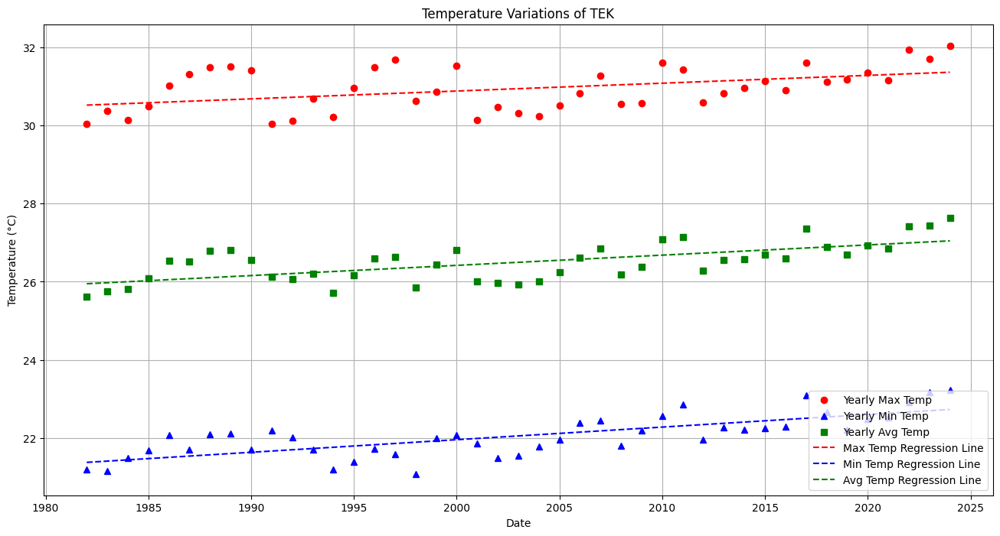

In [ ]:
temp_data=region_df['DHK'].copy()
temp_plot23(temp_data,key)

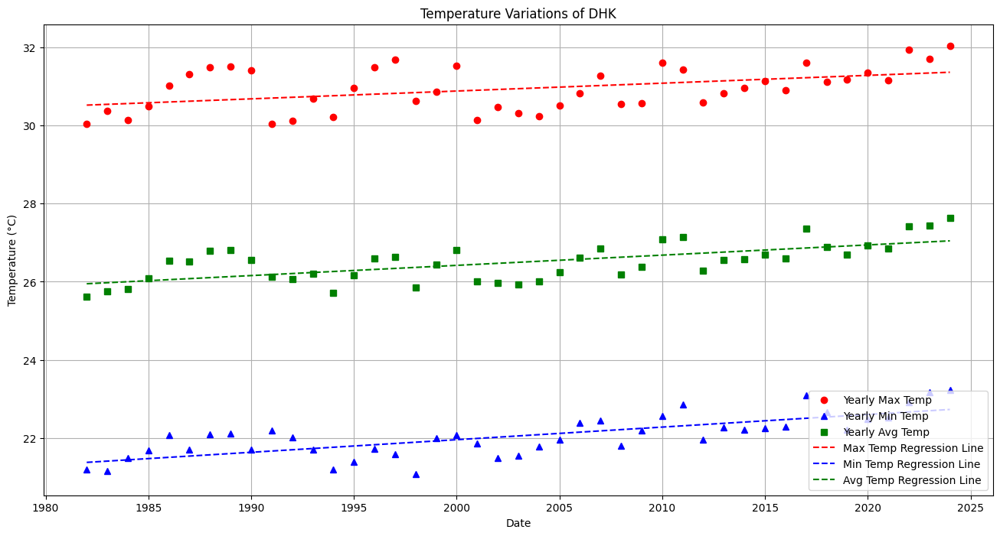

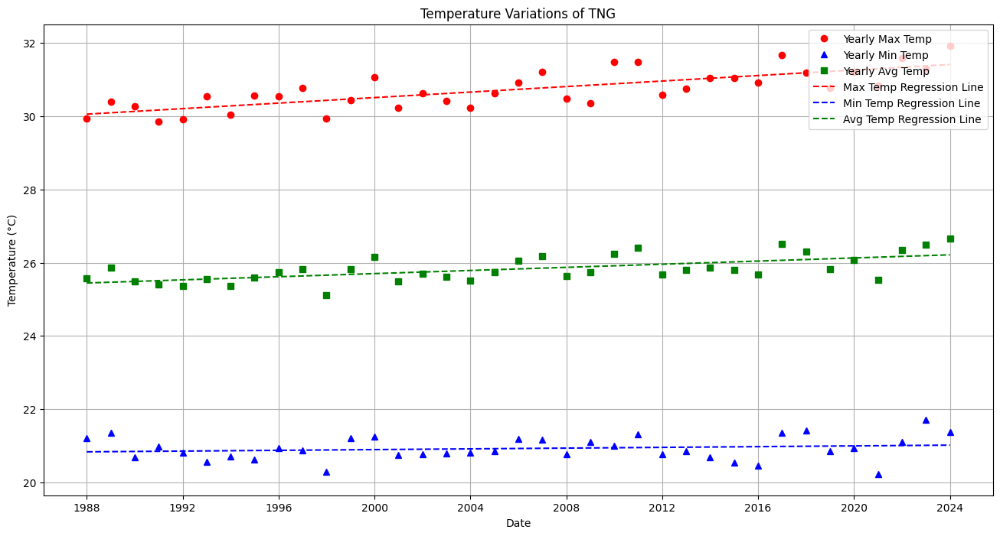

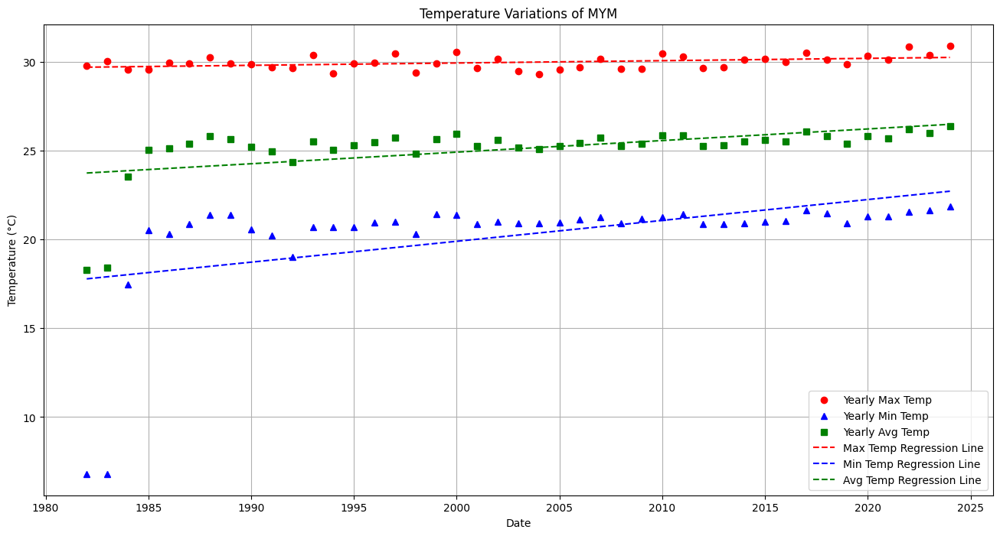

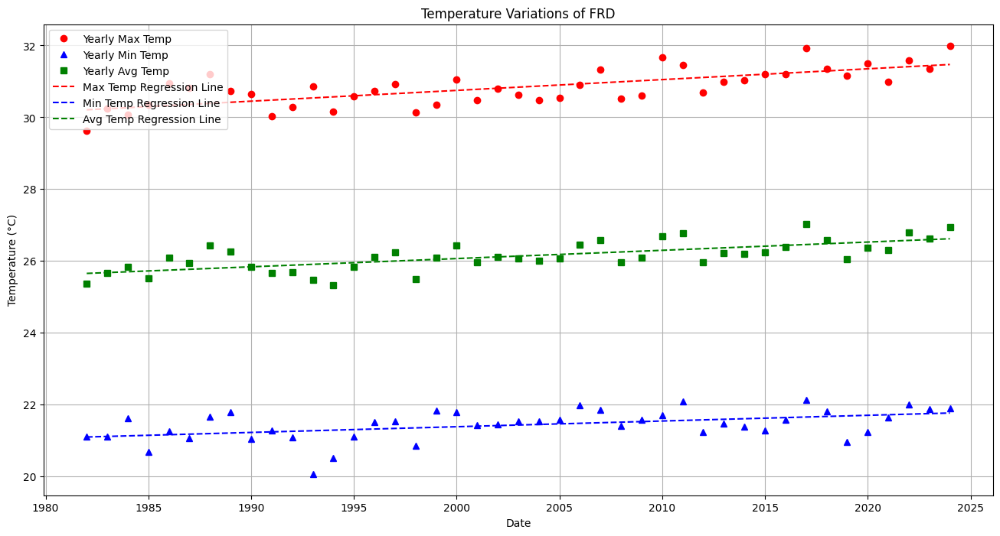

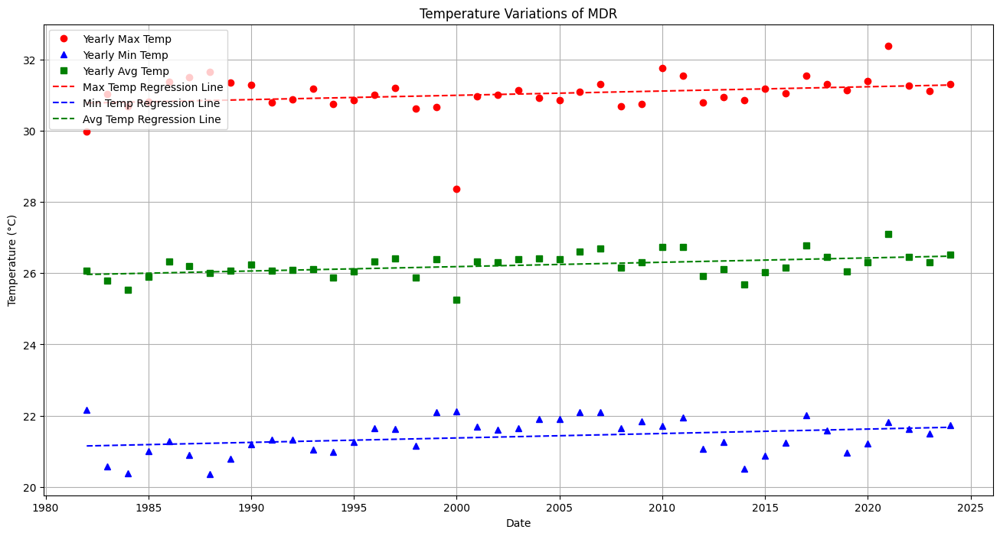

...

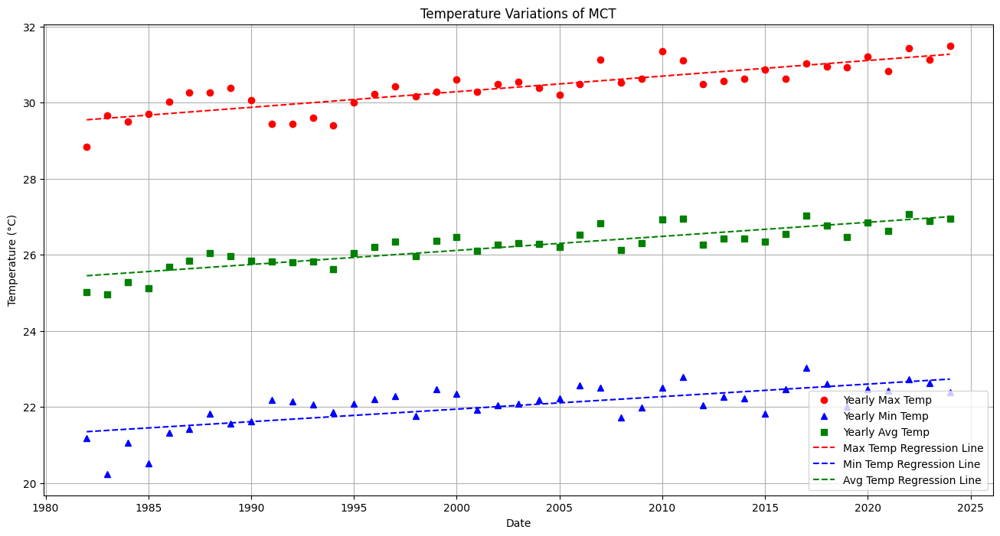

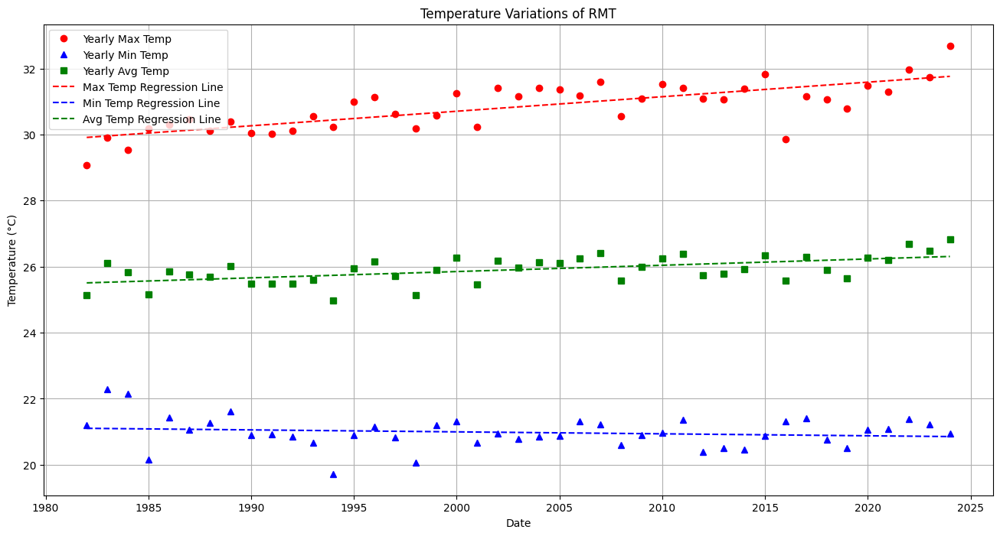

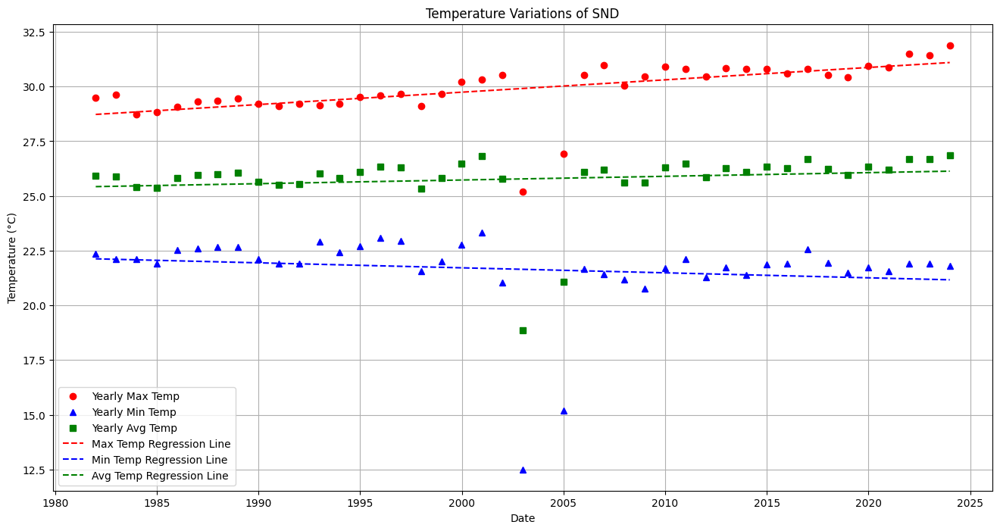

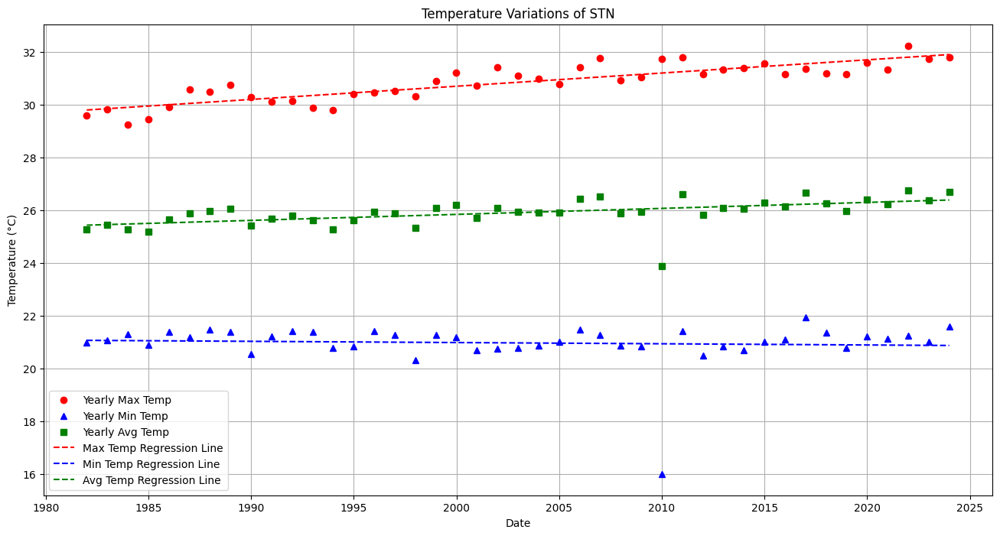

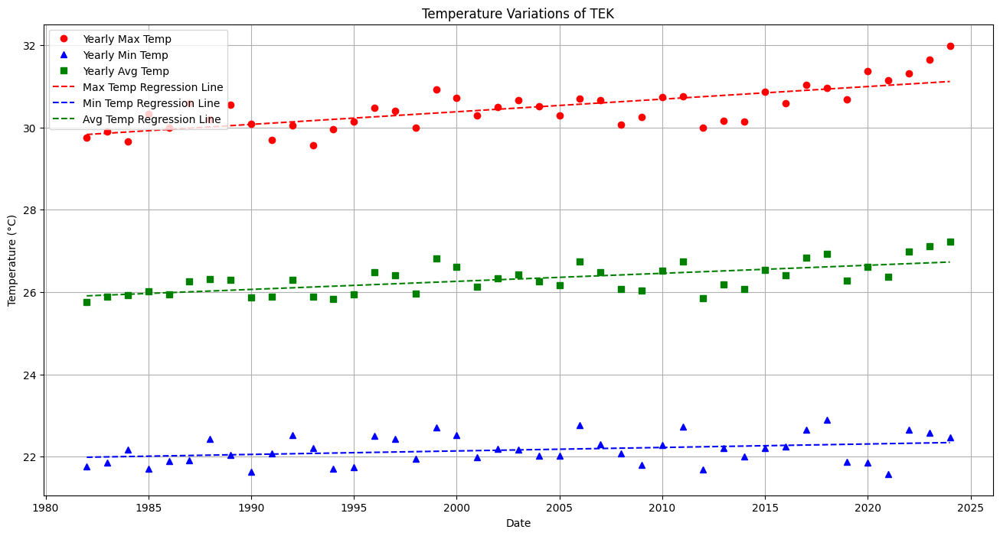

In [ ]:
for key in region_df:
  # print(region_df[key])
  # print(key)
  # kendall_test_decades(region_df[key],key)
  # find_coefficient_by_decades(region_df[key],key)
  temp_data=region_df[key].copy()
  temp_plot23(temp_data,key)




In [ ]:
# adf_result = adfuller(data)
for key in region_df:
  df=region_df[key]
  discomfort_indx=df['Discomfort_Index']
  result = adfuller(discomfort_indx)
  print(key)
  print(result)
  print("-----------")

DHK
(-12.514481574676951, 2.6299582650909383e-23, 43, 15661, {'1%': -3.430767621617927, '5%': -2.861724571260862, '10%': -2.5668682427279705}, 53779.28467878789)
-----------
TNG
(-11.502596674565616, 4.454175579764407e-21, 41, 13472, {'1%': -3.430835491866786, '5%': -2.8617545646156537, '10%': -2.5668842078760785}, 45718.13204574389)
-----------
MYM
(-11.242528295652418, 1.792368001799271e-20, 43, 15661, {'1%': -3.430767621617927, '5%': -2.861724571260862, '10%': -2.5668682427279705}, 52189.83018098565)
-----------
FRD
(-12.98560754907981, 2.8826831569203826e-24, 43, 15661, {'1%': -3.430767621617927, '5%': -2.861724571260862, '10%': -2.5668682427279705}, 52922.11813844129)
-----------
MDR
(-12.948788493483866, 3.410941052428338e-24, 43, 16026, {'1%': -3.4307581085568586, '5%': -2.861720367175314, '10%': -2.566866004946816}, 52795.141682635454)
-----------
SRI
(-11.274722233262727, 1.5064425204596364e-20, 40, 15299, {'1%': -3.430777504904586, '5%': -2.8617289389451064, '10%': -2.5668705

# Season wise

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

def plot_regression(x, y, color, label):
    # x = x.values.reshape(-1, 1)  # Reshape for sklearn
    mask = y.notna()
    x = x[mask]
    y = y[mask]
    x = x.map(pd.Timestamp.toordinal).values.reshape(-1, 1)
    model = LinearRegression()
    model.fit(x, y)
    y_pred = model.predict(x)

    x = pd.Series(x.flatten()) # Flatten the array and convert to Series
    x = x.map(pd.Timestamp.fromordinal) #
    plt.plot(x, y_pred, color=color, linestyle='--', label=f'{label} Regression Line')


def plot_discomfort_index_by_season(df,key):
    # Ensure 'Date' is in datetime format
    df['Date'] = pd.to_datetime(df['Date'])

    # Define decades and seasons
    decades = {
        '1980s': (1980, 1989),
        '1990s': (1990, 1999),
        '2000s': (2000, 2009),
        '2010s': (2010, 2019),
        '2020s': (2020, 2030)
    }
    seasons = {
        'Dry': ((11,12, 1, 2)),      # Nov to Feb
        'Summer': (3,4, 5, 6),         # Mar to Jun
        'Monsoon': (7,8,9, 10)               # July to Oct
    }

    # Iterate over each decade
    for decade_name, (start_year, end_year) in decades.items():
        # Filter the data for each decade
        df_decade = df[(df['Date'].dt.year >= start_year) & (df['Date'].dt.year <= end_year)]

        # Iterate over each season
        plt.figure(figsize=(12, 6))
        for season_name, months in seasons.items():
            # Filter the data for each season
            df_season = df_decade[df_decade['Date'].dt.month.isin(months)]

            # Group by month and calculate the average Discomfort_Index
            df_season_avg = df_season.groupby(df_season['Date'].dt.to_period('M'))['Discomfort_Index'].mean().reset_index()
            df_season_avg['Date'] = df_season_avg['Date'].dt.to_timestamp()  # Convert Period back to Timestamp for plotting

            # print(len(df_season_avg['Date']))
            if(len(df_season_avg['Date'])== 0):

              continue
            # Plotting
            if(season_name=='Dry'):
              plt.plot(df_season_avg['Date'], df_season_avg['Discomfort_Index'], marker='o',color="red", linestyle='', label=f'{season_name}of {key}')
              plot_regression(df_season_avg['Date'], df_season_avg['Discomfort_Index'],color="red",label=season_name)

            elif(season_name=='Monsoon'):
              plt.plot(df_season_avg['Date'], df_season_avg['Discomfort_Index'], marker='s',color="blue", linestyle='', label=f'{season_name}of {key}')
              plot_regression(df_season_avg['Date'], df_season_avg['Discomfort_Index'],color="blue",label=season_name)
            else:
              plt.plot(df_season_avg['Date'], df_season_avg['Discomfort_Index'], marker='^',color="green", linestyle='', label=f'{season_name}of {key}')
              plot_regression(df_season_avg['Date'], df_season_avg['Discomfort_Index'],color="green",label=season_name)

            # # Plotting
            # plt.figure(figsize=(12, 6))
            # plt.plot(df_season['Date'], df_season['Discomfort_Index'], marker='o', linestyle='-', label=f'{season_name} of {key}')

            # Customize the plot
            plt.title(f'Discomfort Index for in the {decade_name} of {key}')
            plt.xlabel('Date')
            plt.ylabel('Discomfort Index')
            plt.legend(loc='best')
            plt.grid(True)

        # Show the plot
        plt.show()

# Example usage
# plot_discomfort_index_by_season(df)


0
0
0


<Figure size 1200x600 with 0 Axes>

36
36
36


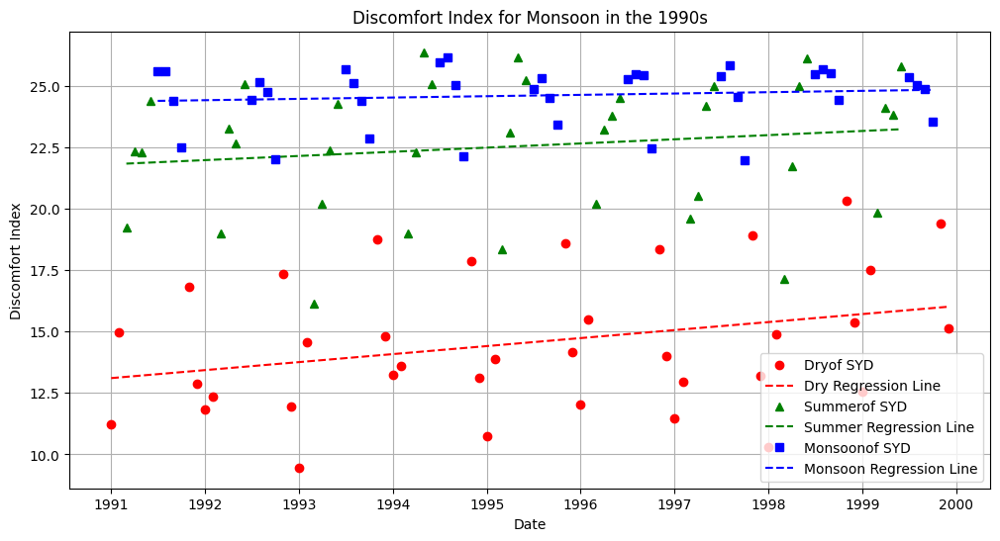

40
40
40


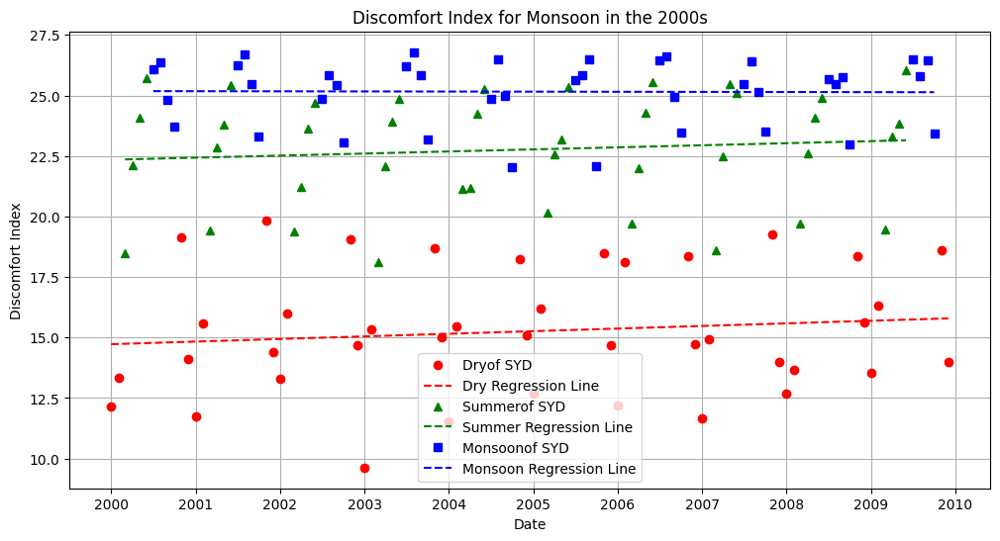

40
40
40


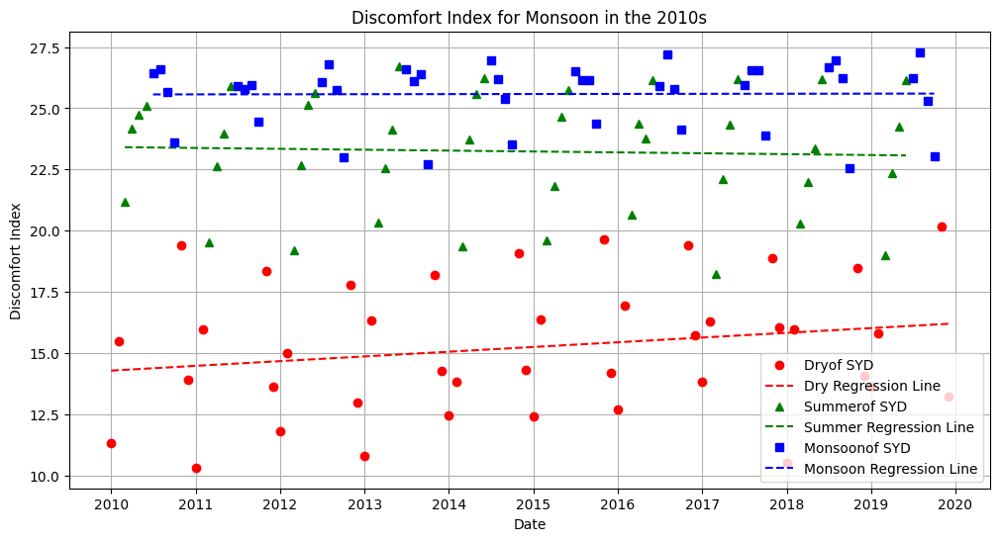

16
16
16


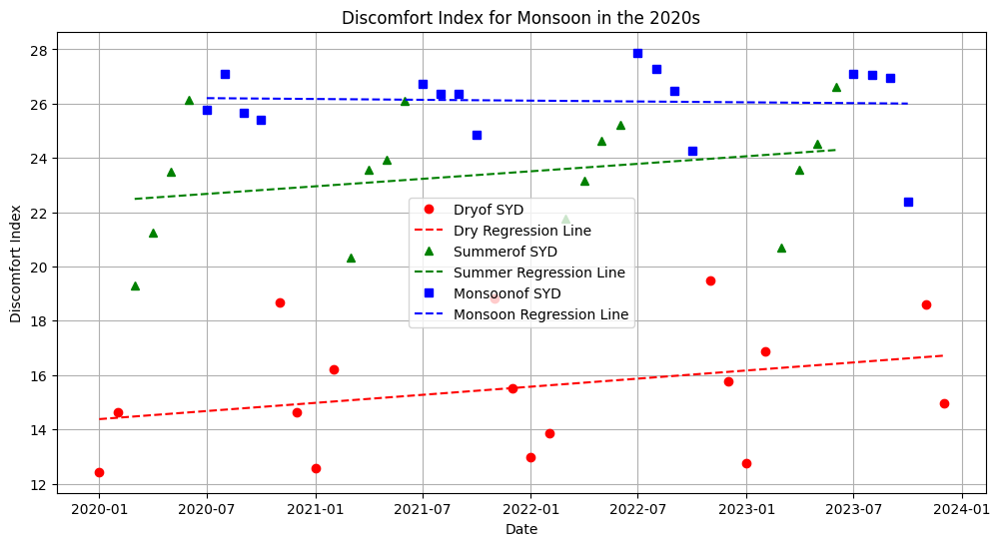

In [ ]:
temp_data=region_df['SYD'].copy()
plot_discomfort_index_by_season(temp_data,'SYD')

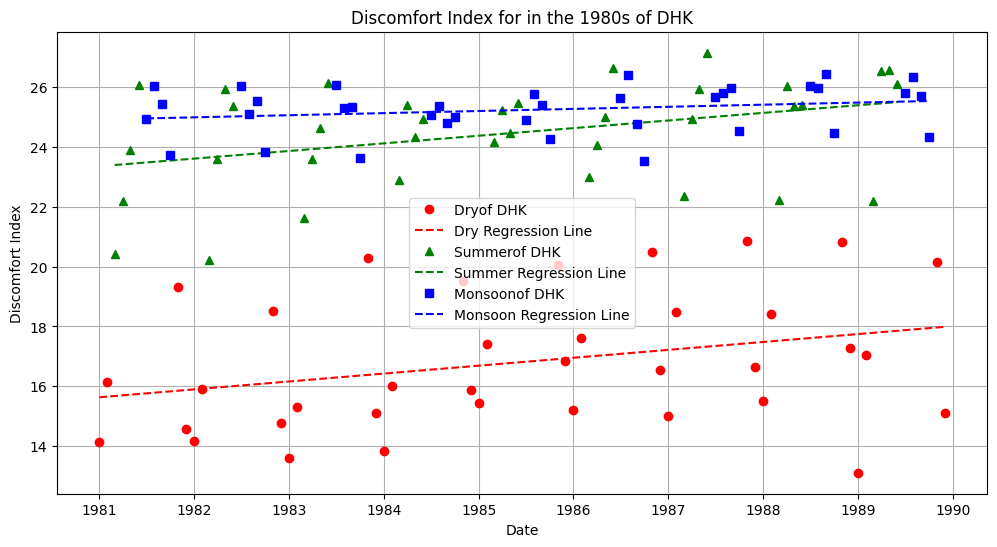

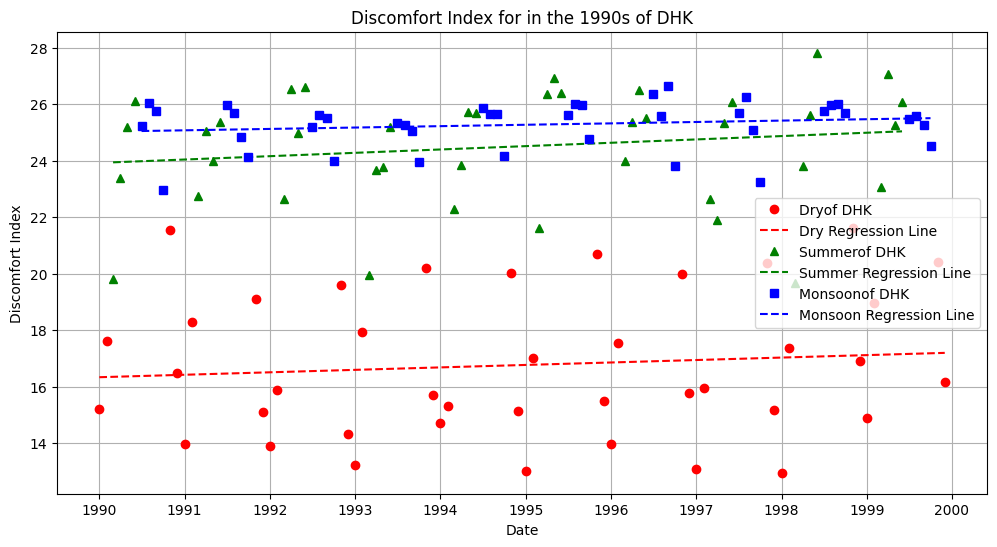

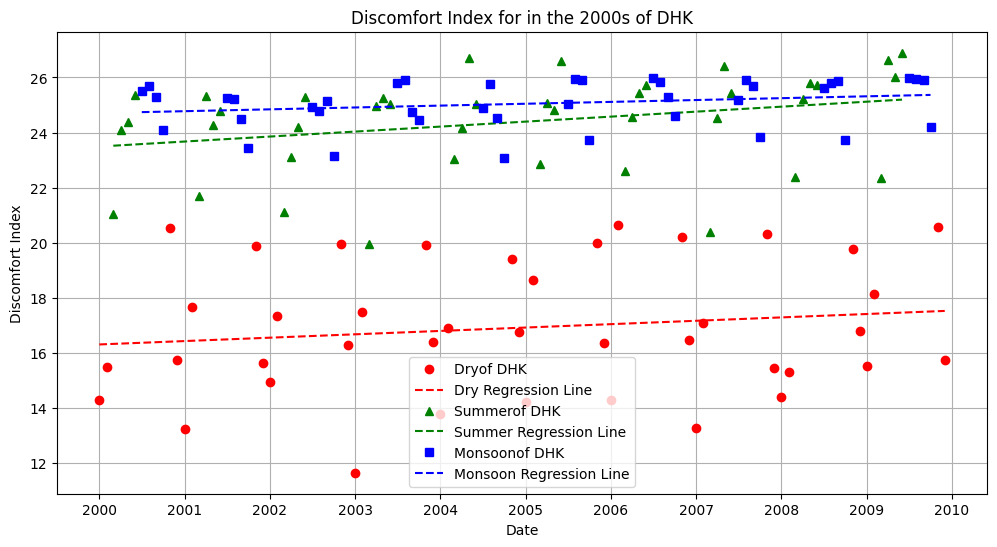

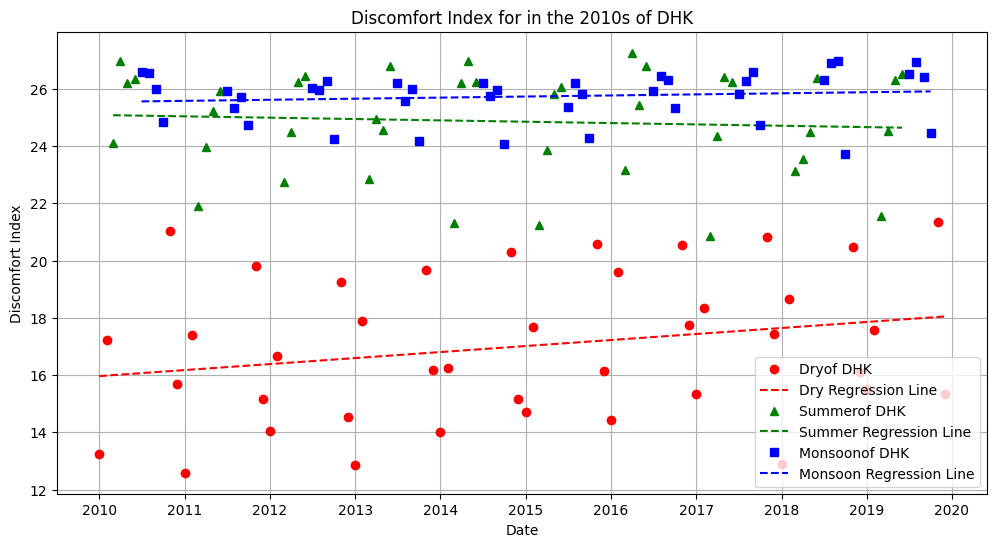

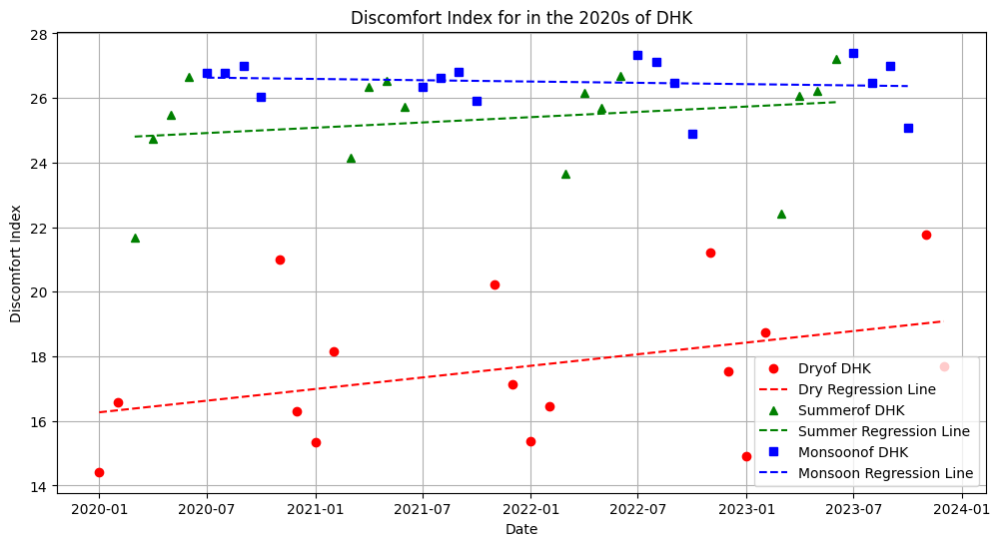

...

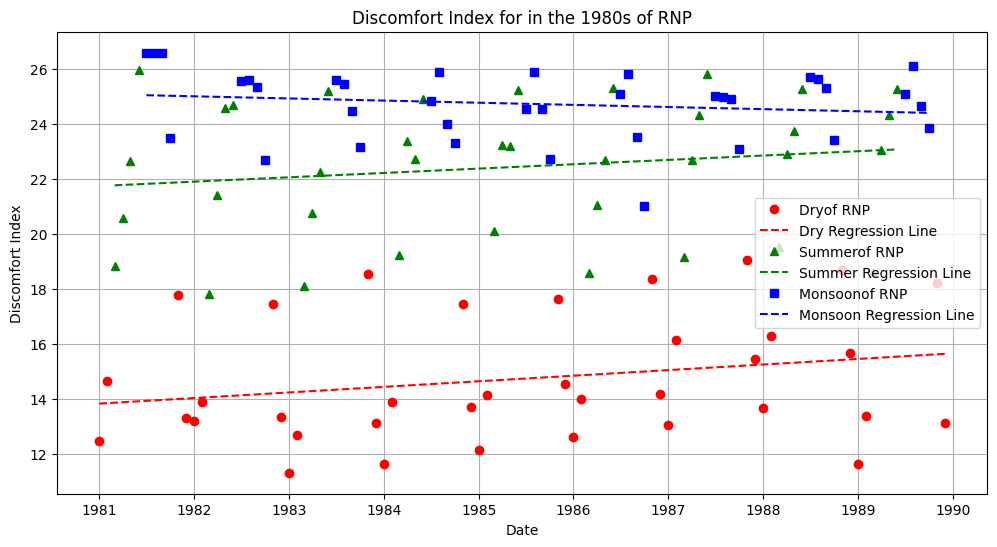

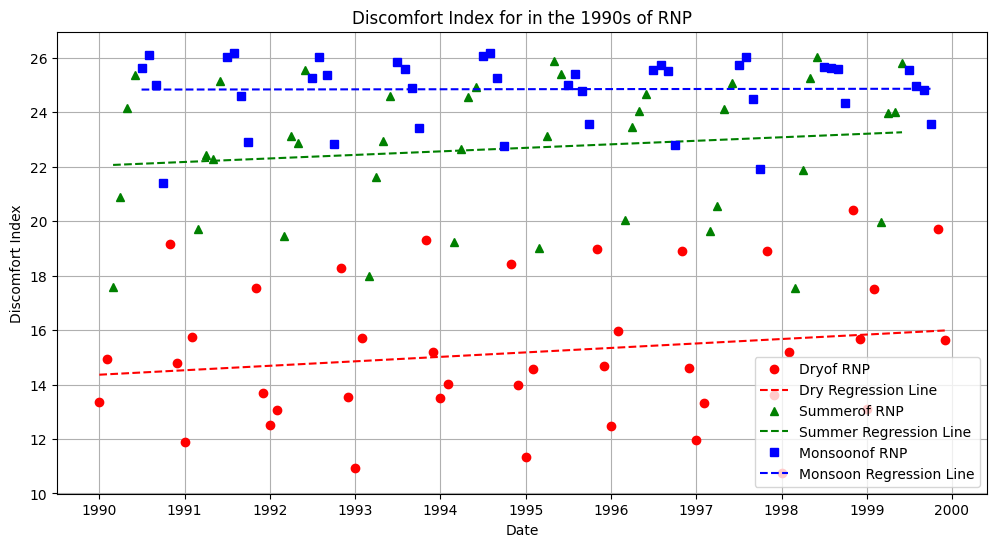

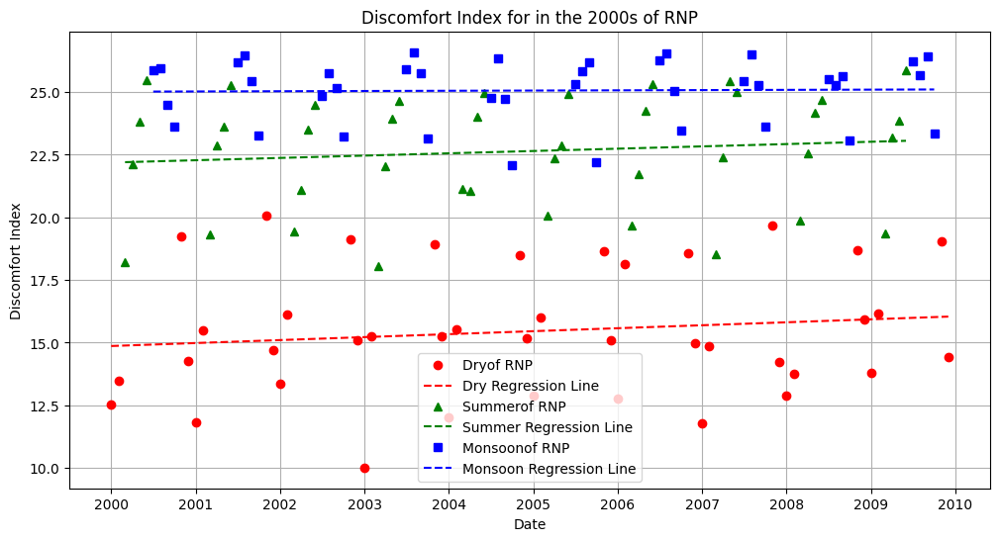

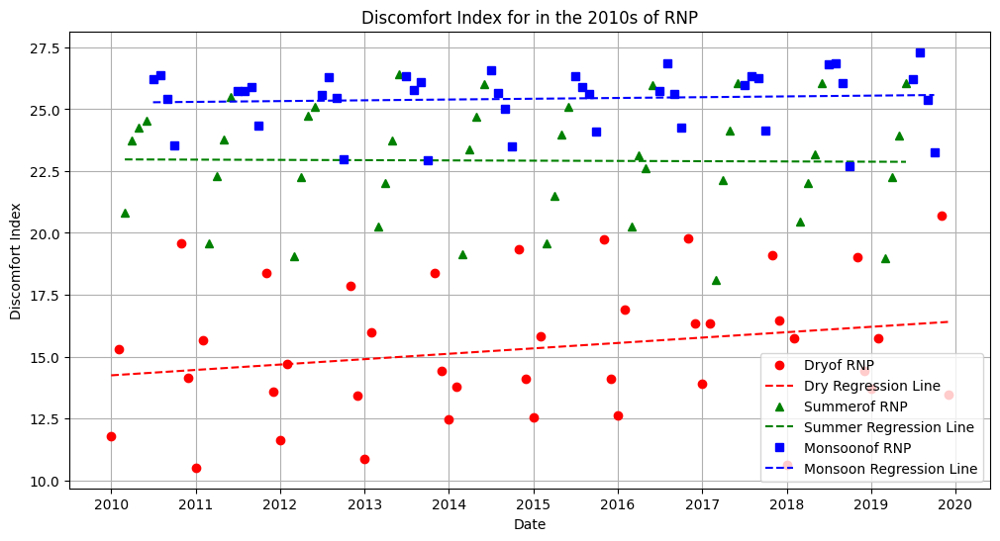

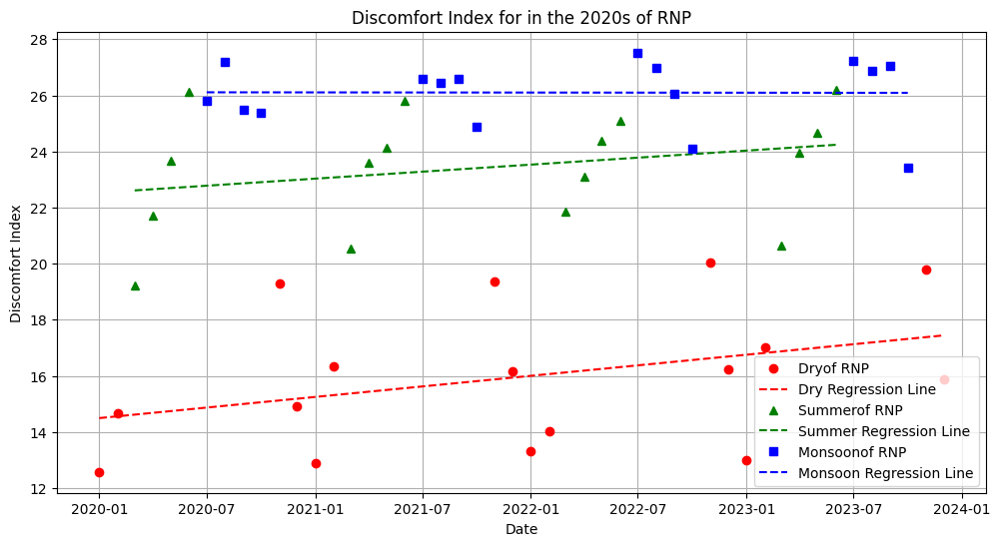

<Figure size 1200x600 with 0 Axes>

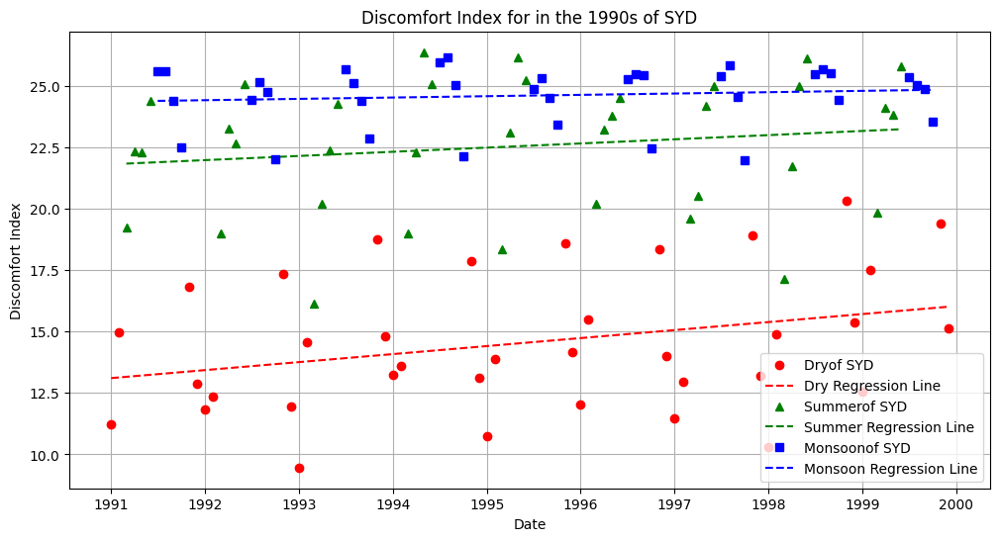

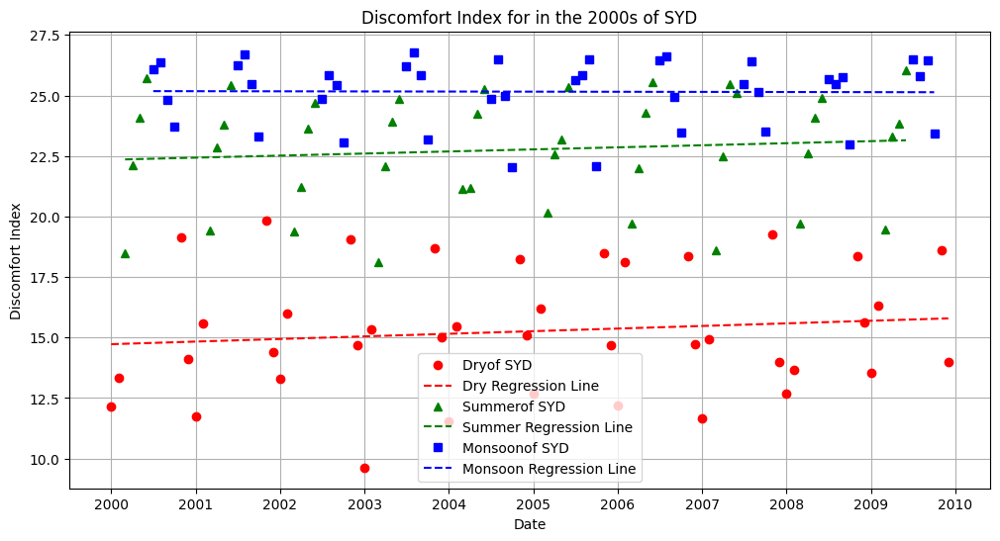

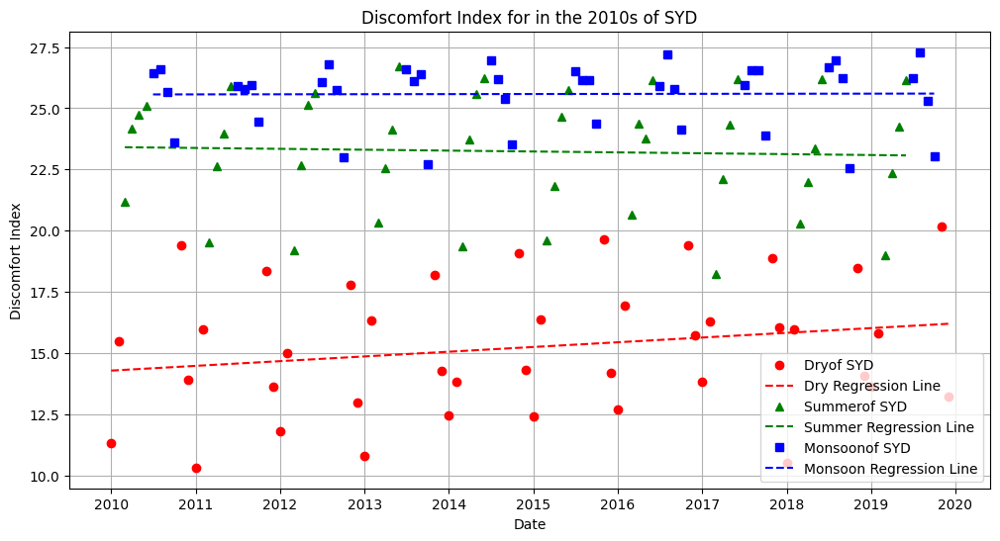

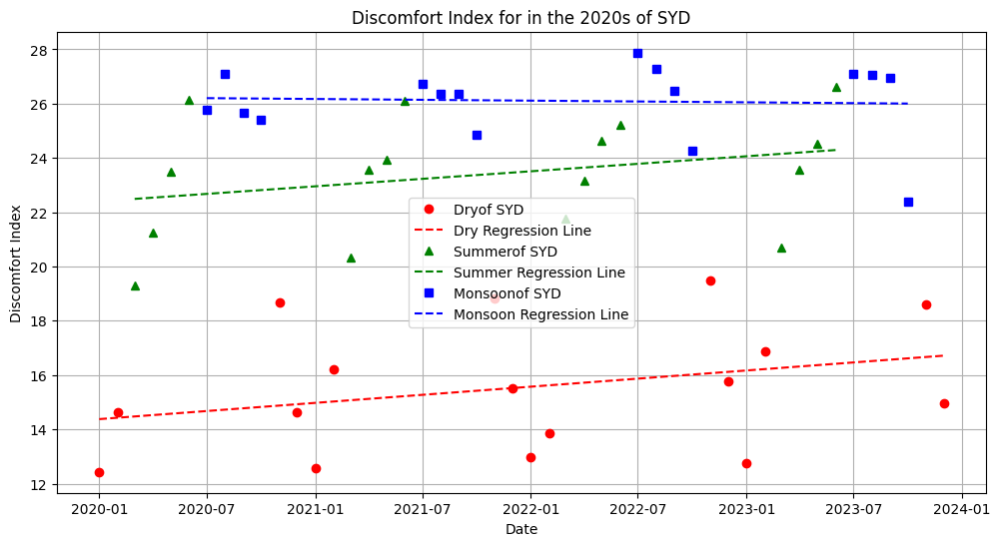

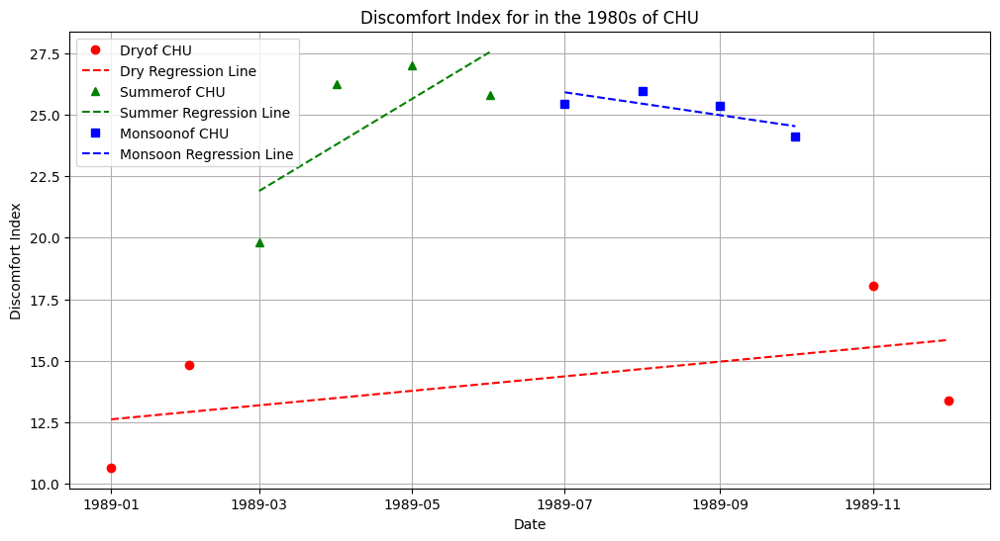

...

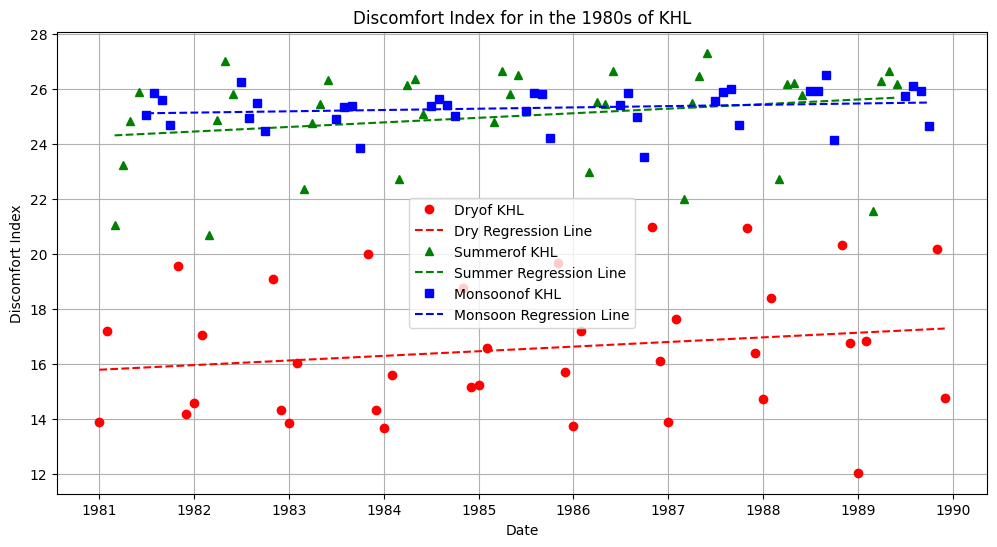

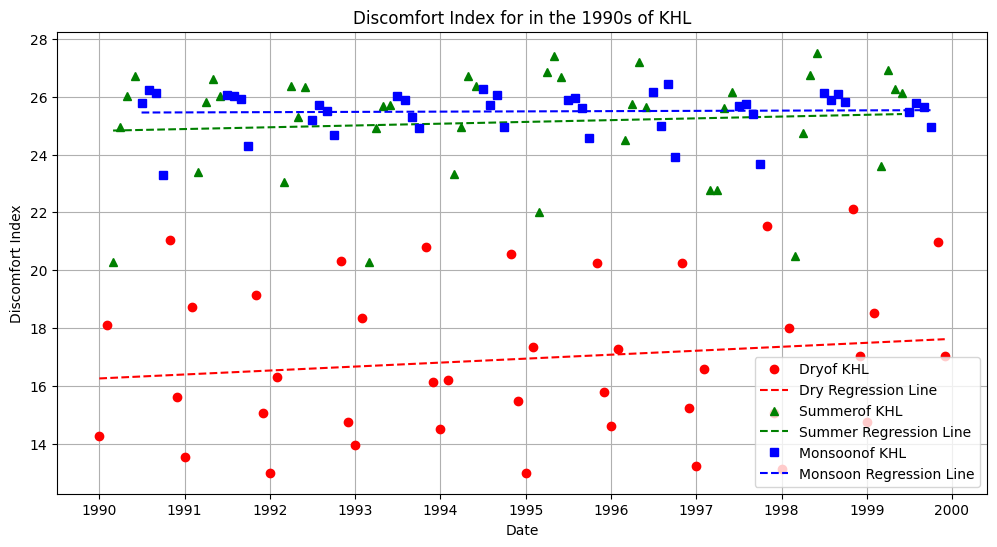

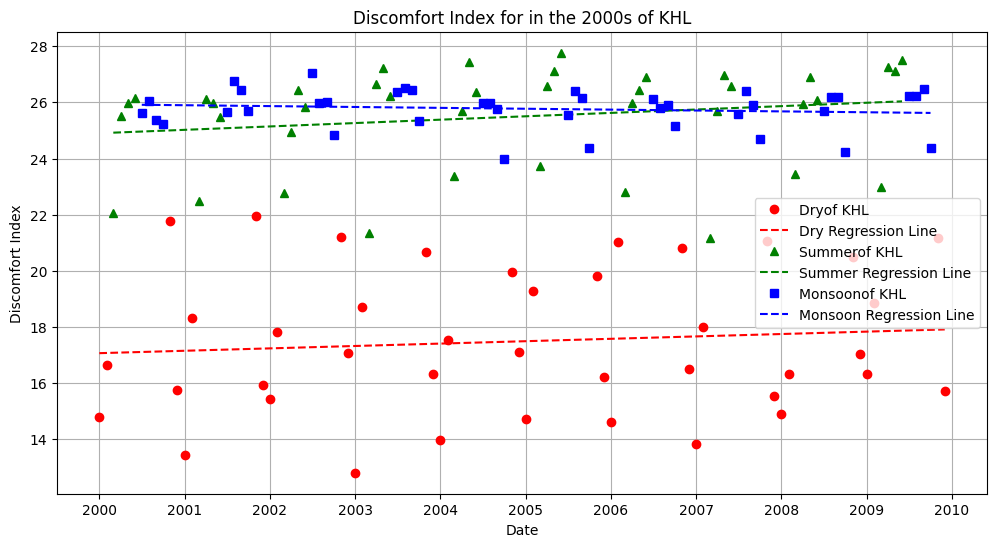

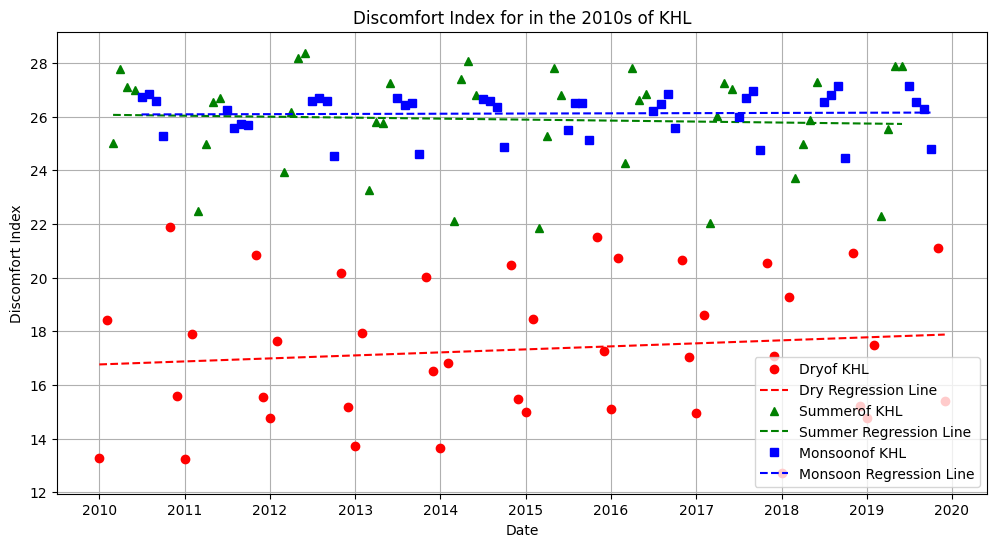

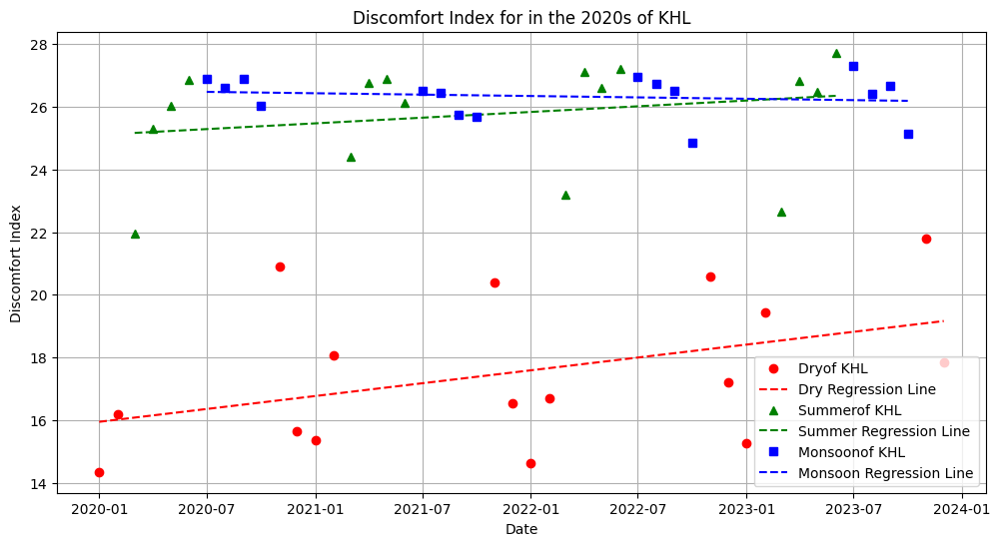

<Figure size 1200x600 with 0 Axes>

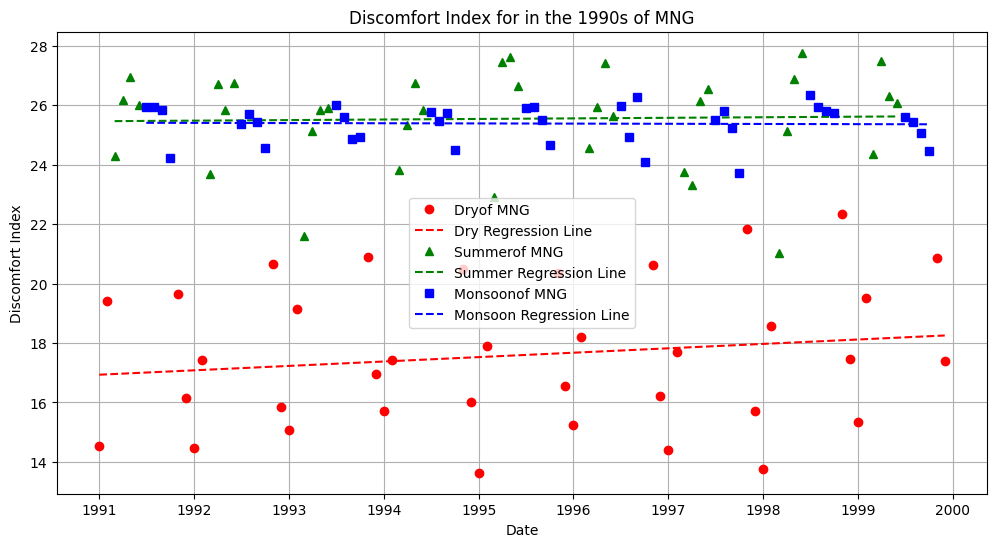

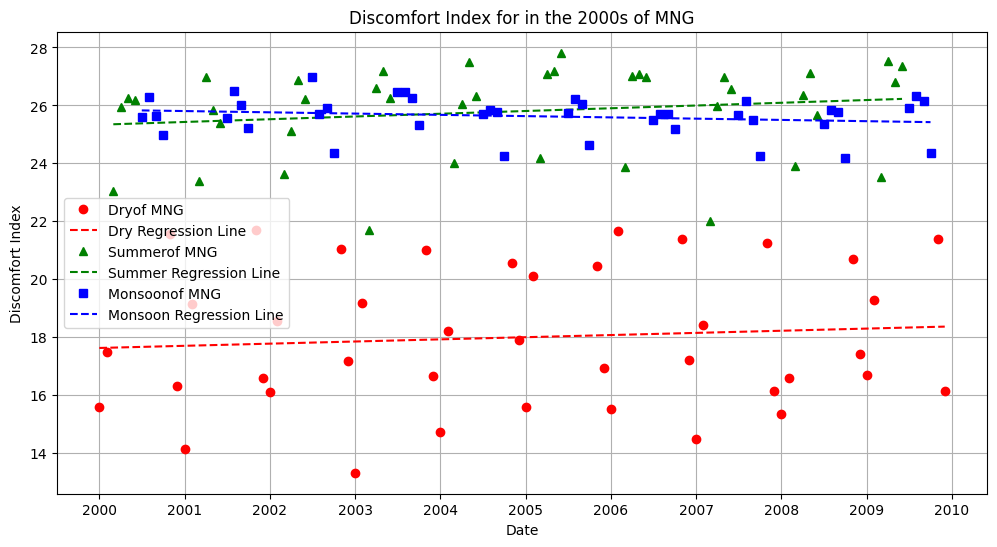

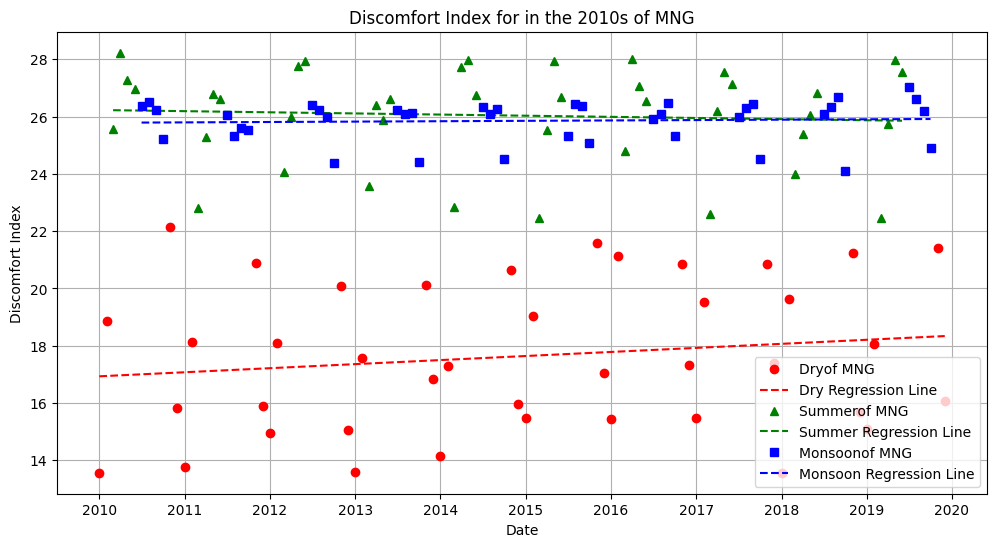

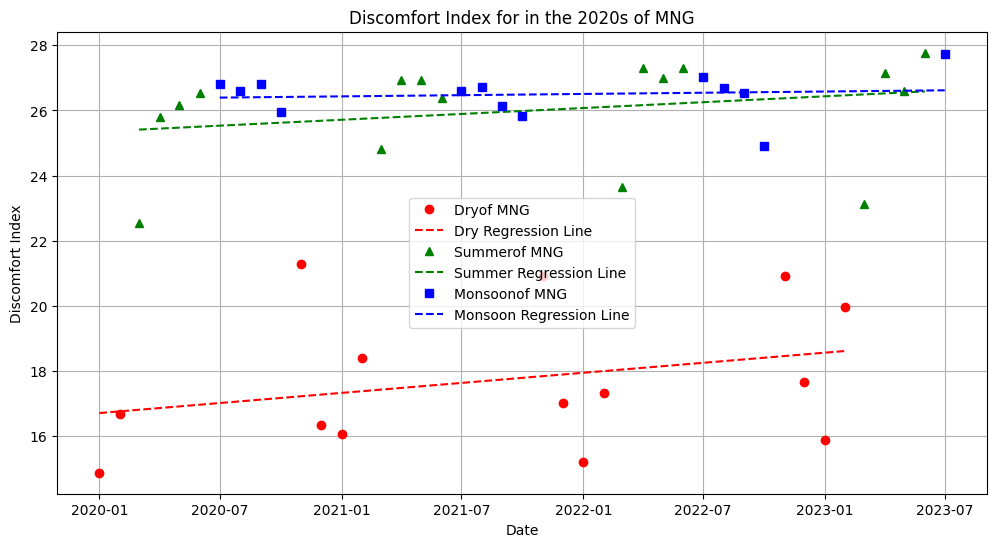

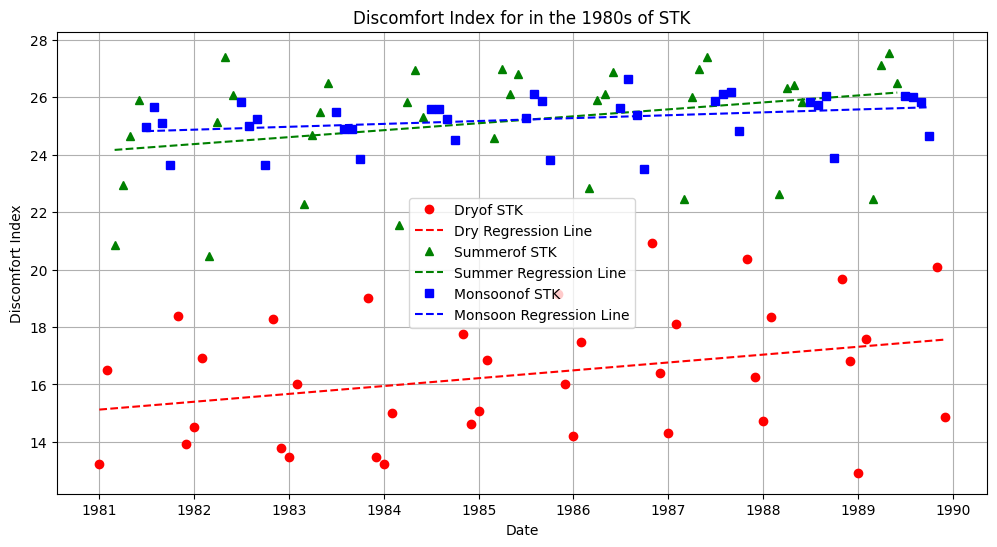

...

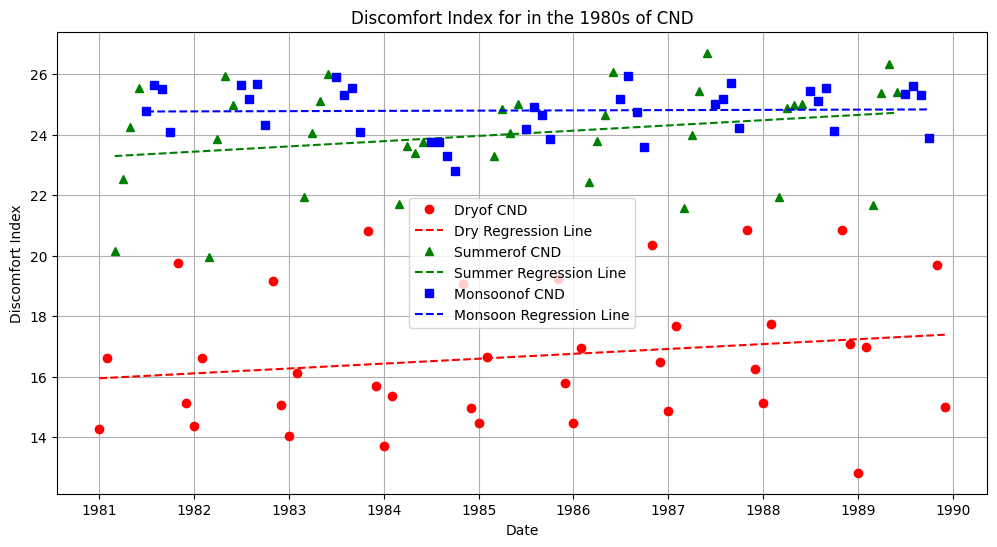

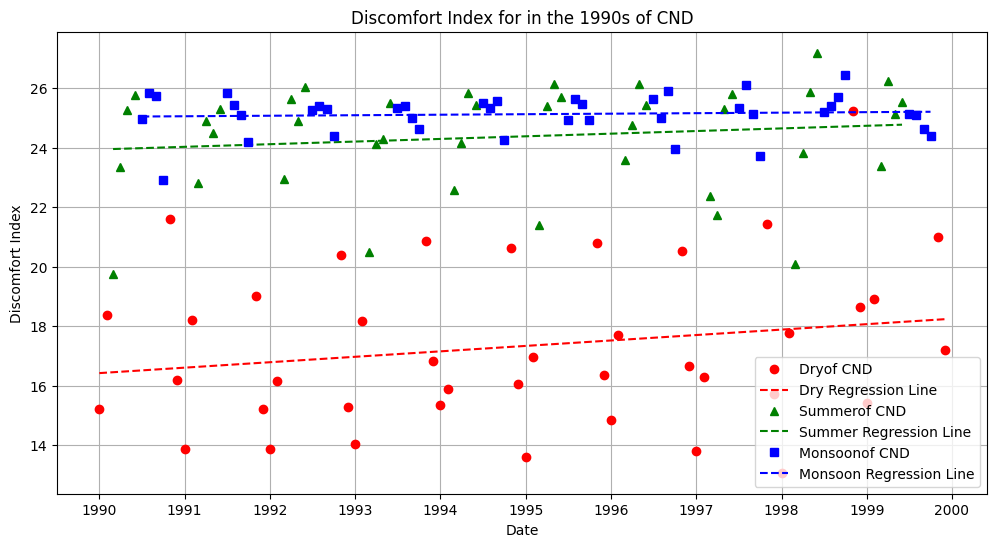

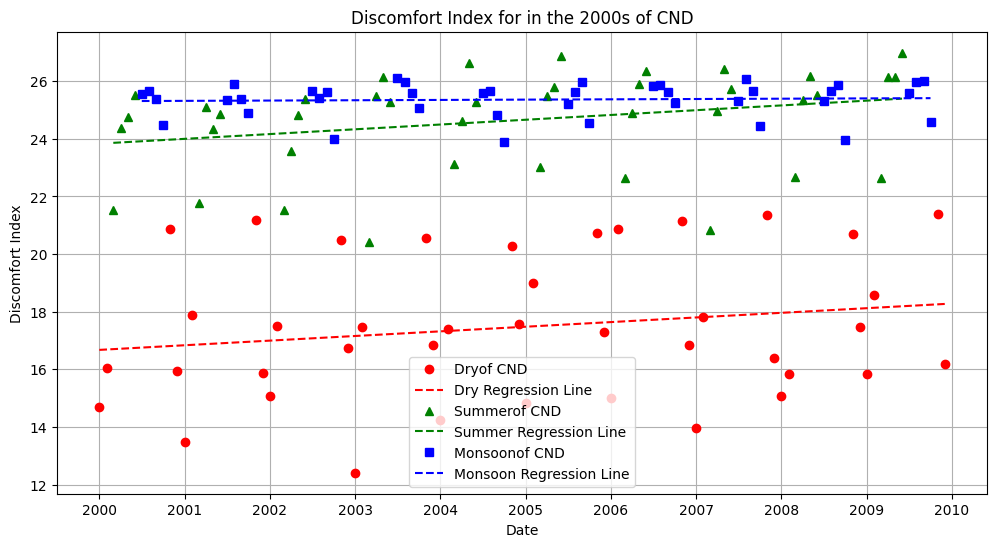

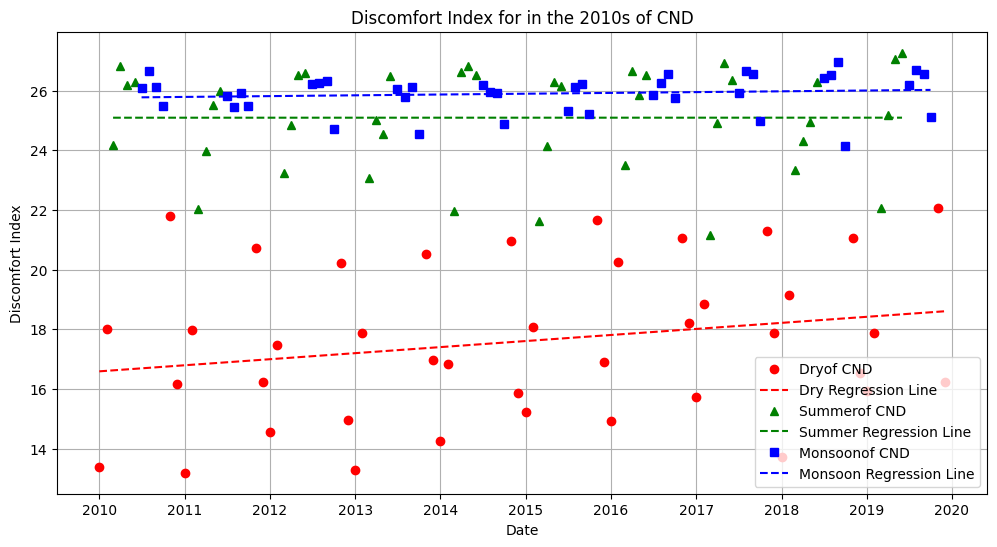

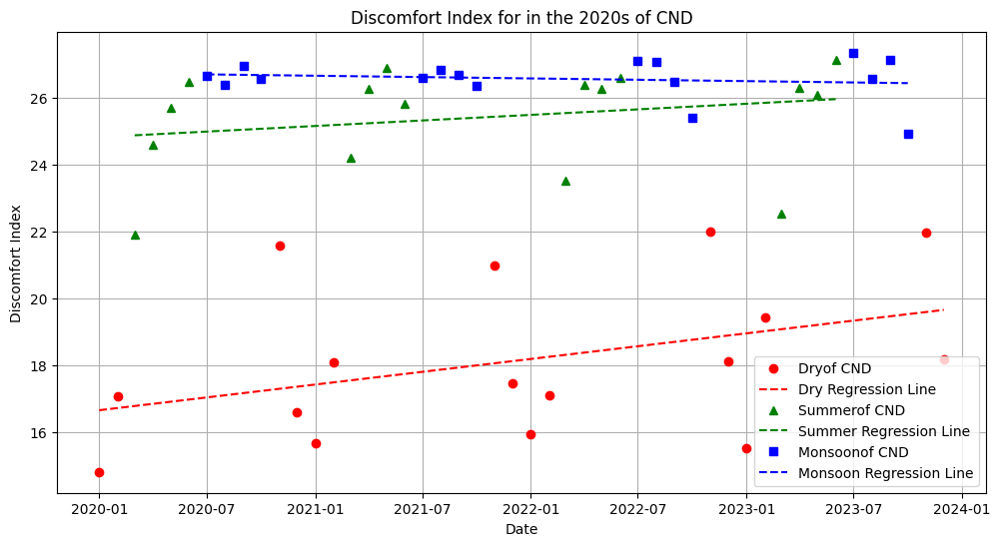

<Figure size 1200x600 with 0 Axes>

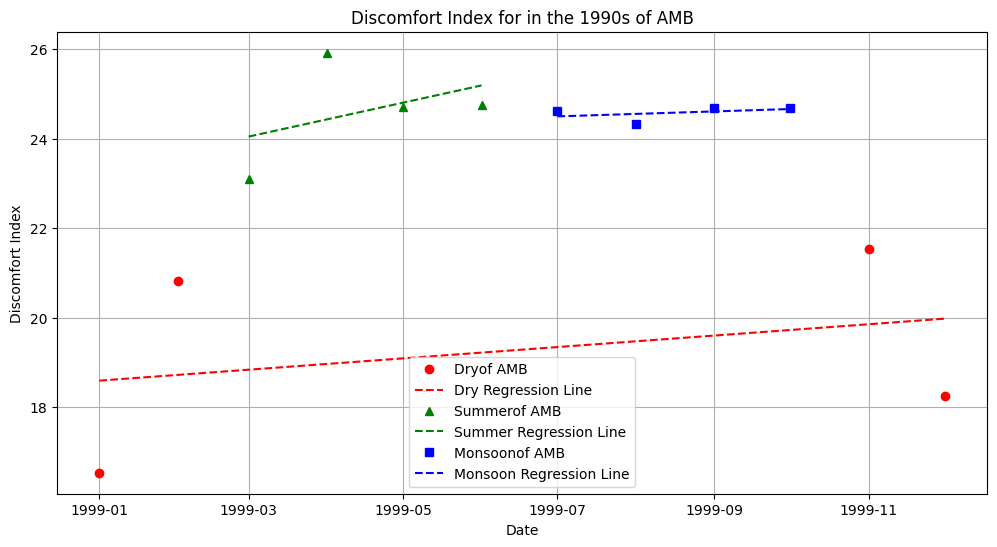

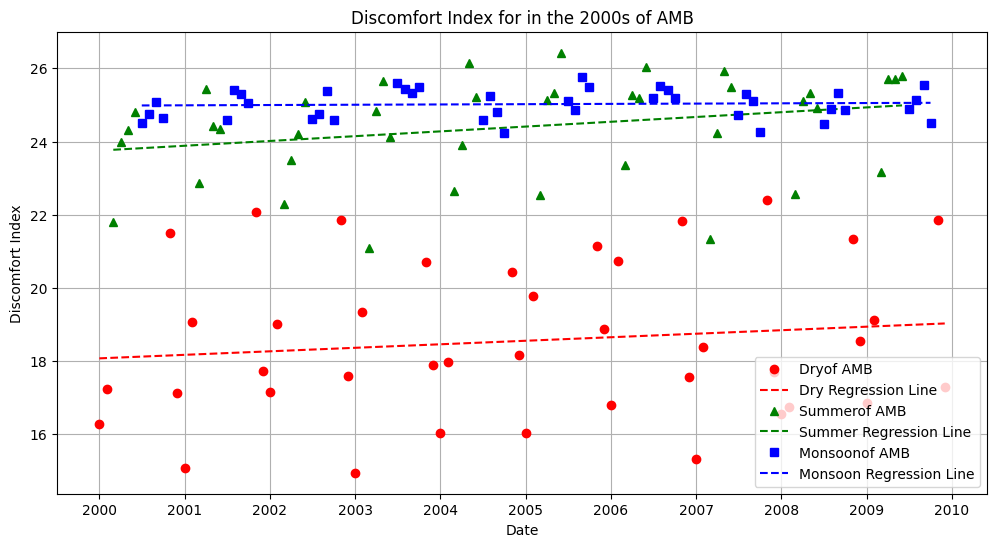

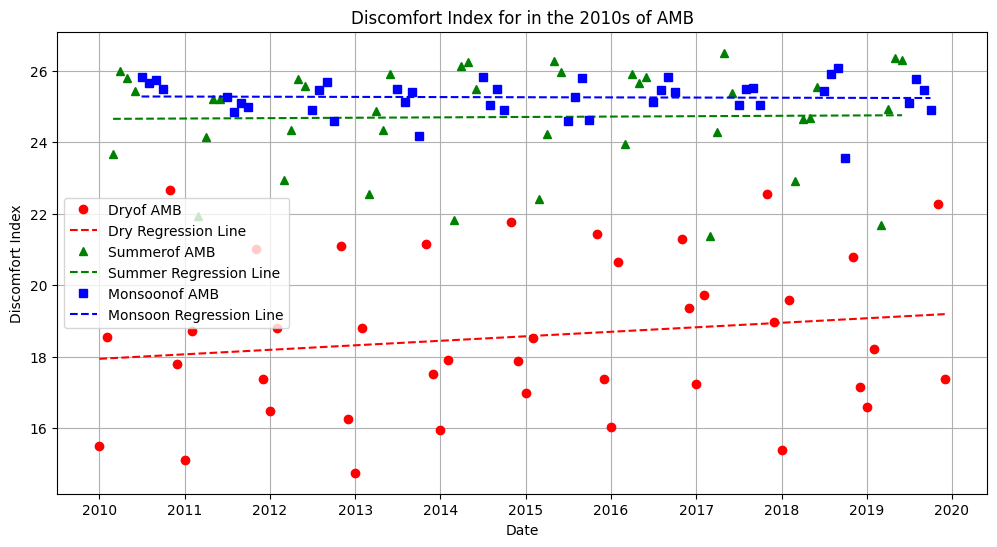

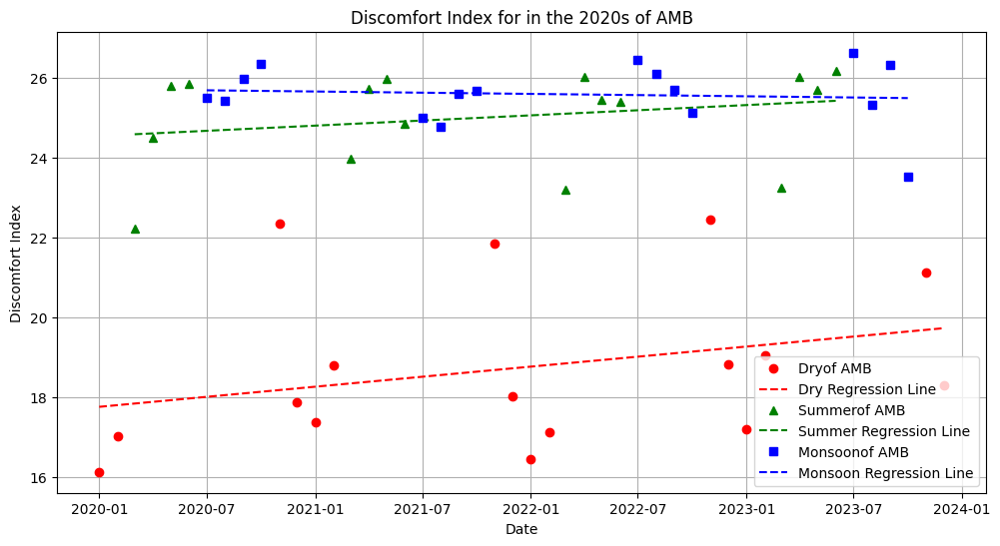

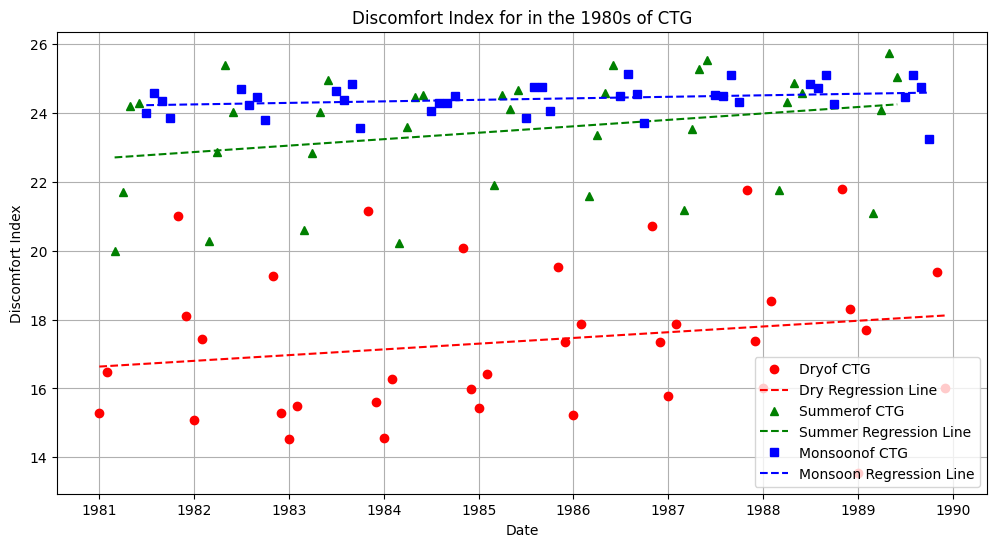

...

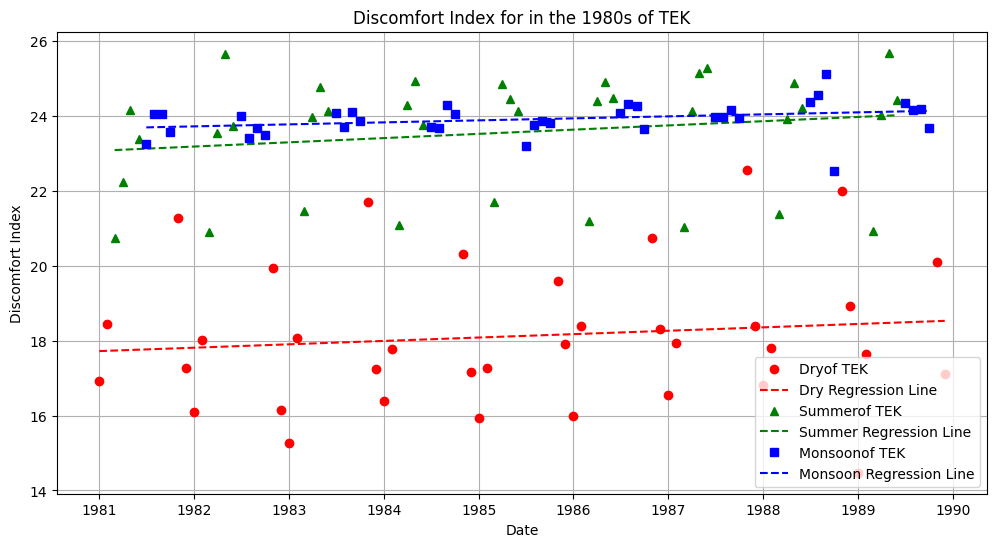

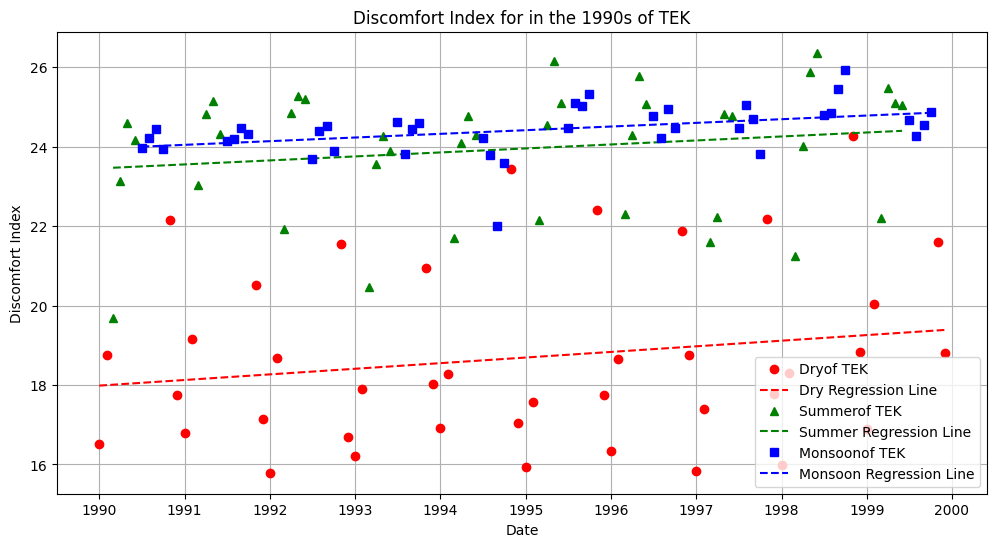

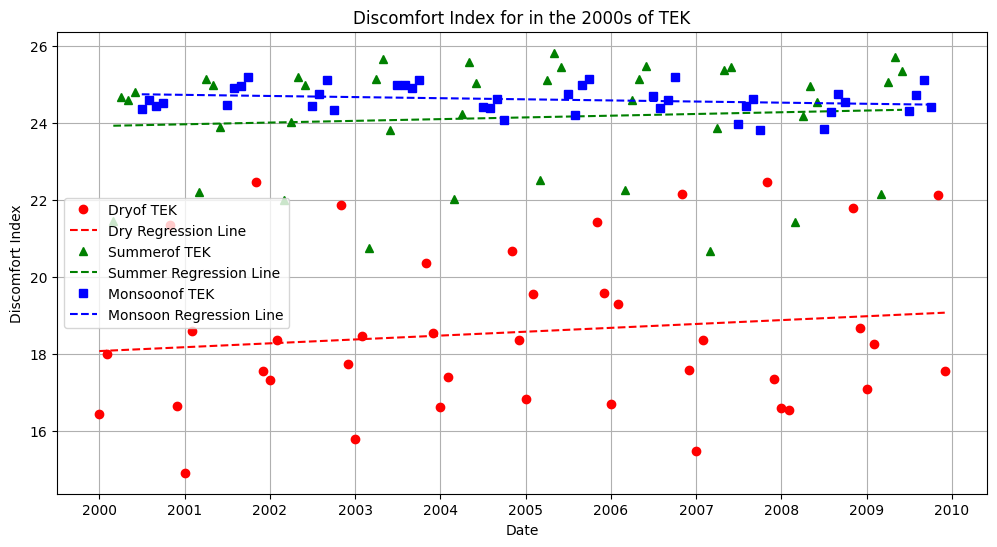

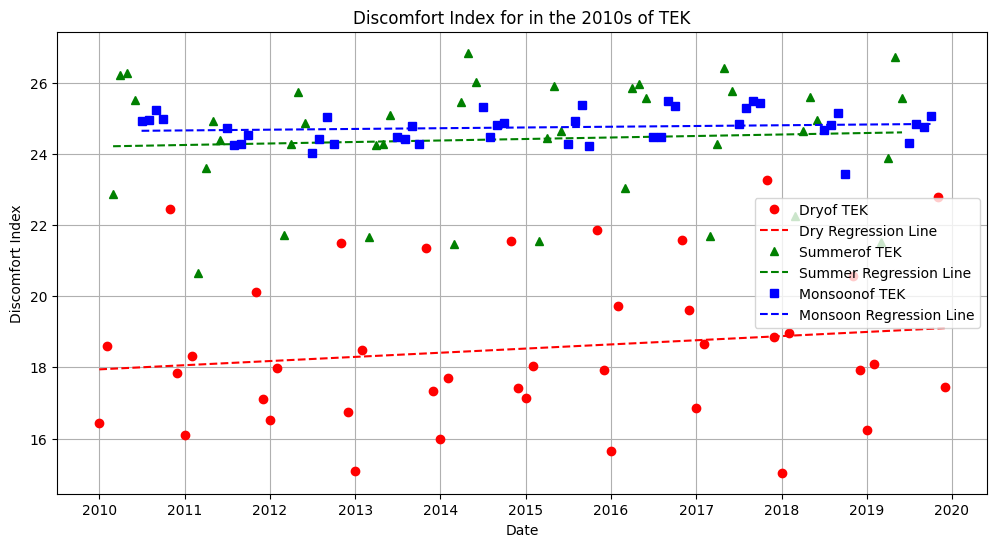

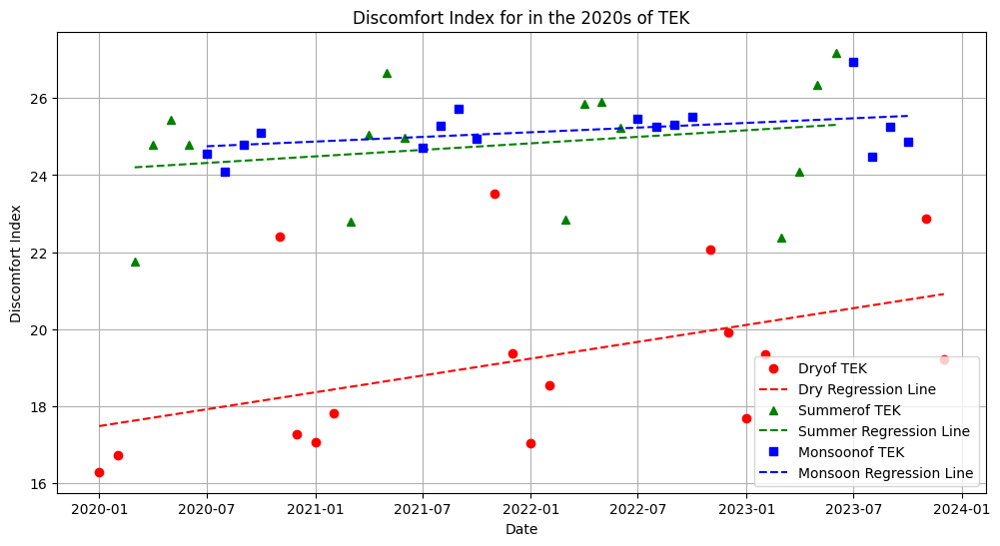

In [ ]:
for key in region_df:
  # print(region_df[key])
  # print(key)
  # kendall_test_decades(region_df[key],key)
  # find_coefficient_by_decades(region_df[key],key)
  temp_data=region_df[key].copy()
  plot_discomfort_index_by_season(temp_data,key)

# whole discomfort indx

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

def discomfort_indx_plot(df, key):
    # Ensure 'Date' is in datetime format
    df['Date'] = pd.to_datetime(df['Date'])

    # Drop non-numeric columns
    numeric_df = df.select_dtypes(include=['float64', 'int64'])

    # Set 'Date' as the index for resampling
    df.set_index('Date', inplace=True)
    numeric_df.set_index(df.index, inplace=True)

    # Aggregate the data to get one average temperature point per year
    yearly_avg = numeric_df.resample('Y').mean()

    # Function to fit and plot a regression line
    def plot_regression(x, y, color, label):
        # x = x.values.reshape(-1, 1)  # Reshape for sklearn
        mask = y.notna()
        x = x[mask]
        y = y[mask]
        x = x.map(pd.Timestamp.toordinal).values.reshape(-1, 1)
        model = LinearRegression()
        model.fit(x, y)
        y_pred = model.predict(x)

        x = pd.Series(x.flatten()) # Flatten the array and convert to Series
        x = x.map(pd.Timestamp.fromordinal) #
        plt.plot(x, y_pred, color=color, linestyle='--', label=f'{label} Regression Line')

    # Plotting
    plt.figure(figsize=(16, 8))

    # Plot yearly average temperature as points
    plt.plot(yearly_avg.index, yearly_avg['Discomfort_Index'], marker='o', color='red', linestyle='', label='Yearly Discomfort index')
    # plt.plot(yearly_avg.index, yearly_avg['MinT'], marker='^', color='blue', linestyle='', label='Yearly Min Temp')
    # plt.plot(yearly_avg.index, yearly_avg['AvgT'], marker='s', color='green', linestyle='', label='Yearly Avg Temp')

    # Fit and plot regression lines
    plot_regression(yearly_avg.index, yearly_avg['Discomfort_Index'], 'red', 'discomfort index')
    # plot_regression(yearly_avg.index, yearly_avg['MinT'], 'blue', 'Min Temp')
    # plot_regression(yearly_avg.index, yearly_avg['AvgT'], 'green', 'Avg Temp')

    # Customize the plot
    plt.title(f'Temperature Variations of {key}')
    plt.xlabel('Date')
    plt.ylabel('Discomfort index')
    plt.legend(loc='best')
    plt.grid(True)

    # Display the plot
    plt.show()

# Example usage
# temp_plot2(df, 'Temperature Data')


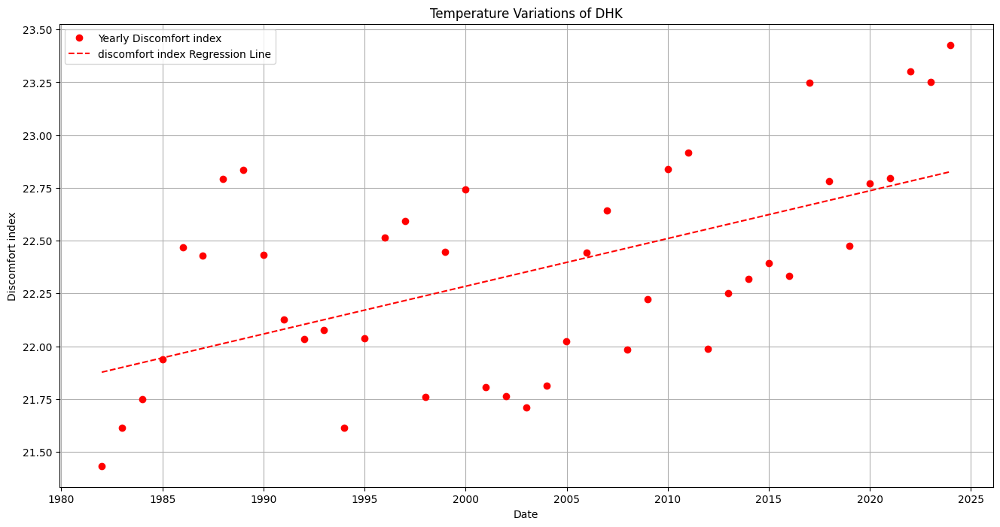

In [15]:
temp_data=region_df['DHK'].copy()
discomfort_indx_plot(temp_data,'DHK')

# discomfort index vs temp

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

def dis_comf_vs_temp(df, key):
    # Ensure 'Date' is in datetime format
    df['Date'] = pd.to_datetime(df['Date'])

    # Drop non-numeric columns
    numeric_df = df.select_dtypes(include=['float64', 'int64'])

    # Set 'Date' as the index for resampling
    df.set_index('Date', inplace=True)
    numeric_df.set_index(df.index, inplace=True)

    # Aggregate the data to get one average temperature point per year
    yearly_avg = numeric_df.resample('Y').mean()

    # Function to fit and plot a regression line
    def plot_regression(x, y, color, label):
        x = x.values.reshape(-1, 1)  # Reshape for sklearn
        mask = y.notna()
        x = x[mask]
        y = y[mask]
        # x = x.map(pd.Timestamp.toordinal).values.reshape(-1, 1)
        model = LinearRegression()
        model.fit(x, y)
        y_pred = model.predict(x)

        # x = pd.Series(x.flatten()) # Flatten the array and convert to Series
        # x = x.map(pd.Timestamp.fromordinal) #
        plt.plot(x, y_pred, color=color, linestyle='--', label=f'{label} Regression Line')

    # Plotting
    plt.figure(figsize=(16, 8))

    discmf_indx = yearly_avg['Discomfort_Index']
    # Plot yearly average temperature as points
    plt.plot(discmf_indx, yearly_avg['MaxT'], marker='o', color='red', linestyle='', label='Yearly Max Temp')
    plt.plot(discmf_indx, yearly_avg['MinT'], marker='^', color='blue', linestyle='', label='Yearly Min Temp')
    plt.plot(discmf_indx, yearly_avg['AvgT'], marker='s', color='green', linestyle='', label='Yearly Avg Temp')

    # Fit and plot regression lines
    plot_regression(discmf_indx, yearly_avg['MaxT'], 'red', 'Max Temp')
    plot_regression(discmf_indx, yearly_avg['MinT'], 'blue', 'Min Temp')
    plot_regression(discmf_indx, yearly_avg['AvgT'], 'green', 'Avg Temp')

    # Customize the plot
    plt.title(f'Temperature Variations of {key}')
    plt.xlabel('Discomfort Index')
    plt.ylabel('Temperature (°C)')
    plt.legend(loc='best')
    plt.grid(True)

    # Display the plot
    plt.show()

# Example usage
# temp_plot2(df, 'Temperature Data')


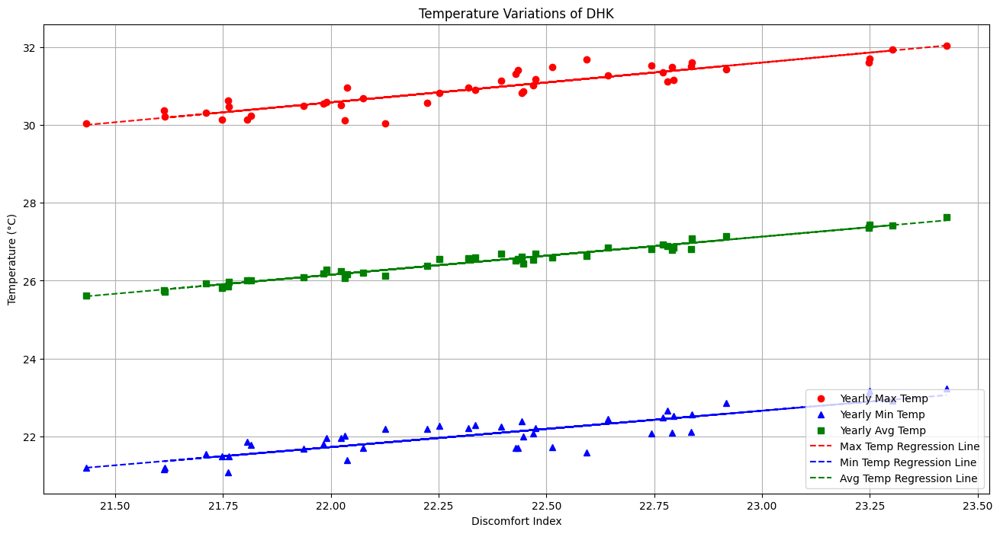

In [27]:
temp_data=region_df['DHK'].copy()
dis_comf_vs_temp(temp_data,'DHK')